In [1]:
import json
import os
import math
import re
import pickle

import numpy as np
import pandas as pd

from IPython.display import display
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns

from scipy.stats import norm

from collections import Counter

import demoji
import string

import nltk
from nltk.corpus import stopwords  # List of stopwords
from langdetect import detect  # Used to detect the language of text
from nltk.stem import WordNetLemmatizer  # Tool for word lemmatization


**Note: If re-running may take a lot of time, it is recommended to view the output data directly**

# Class

In [2]:
class Grid:
    """
    Grid used for storing grid information
    """

    def __init__(self):
        """
        Initialize the grid
        """
        self.lon_left = BOUNDING_COORDINATED[0]
        self.lat_bottom = BOUNDING_COORDINATED[1]
        self.lon_right = BOUNDING_COORDINATED[2]
        self.lat_top = BOUNDING_COORDINATED[3]

        self.point_left_bottom = GridPoint([self.lon_left, self.lat_bottom])
        self.point_right_bottom = GridPoint([self.lon_right, self.lat_bottom])
        self.point_left_top = GridPoint([self.lon_left, self.lat_top])
        self.point_right_top = GridPoint([self.lon_right, self.lat_top])

        self.x_distance = compute_distance(self.point_left_bottom, self.point_right_bottom)
        self.y_distance = compute_distance(self.point_left_bottom, self.point_left_top)

        self.num_rows = int(np.ceil(self.x_distance))
        self.num_columns = int(np.ceil(self.y_distance))

        self.table = [[[] for _ in range(self.num_columns)] for _ in range(self.num_rows)]
        self.count_table = np.zeros((self.num_rows, self.num_columns))
        self.filter_count_table = []

        self.__str__()

    def __str__(self):
        """
        Print grid information
        """
        print('The distance of longitudes is: ', self.x_distance)
        print('The number of latitudes is: ', self.y_distance)

        print('The number of rows is: ', self.num_rows)
        print('The number of columns is: ', self.num_columns)

    def add_point(self, point):
        """
        Calculate grid position and add point
        :param point: GridPoint instance
        """
        self.table[point.row][point.column].append(point)
        self.count_table[point.row][point.column] += 1


In [3]:
class GridPoint:
    """
    Grid Point Class
    """

    def __init__(self, coordinates):
        """
        Initialize grid point
        :param coordinates: Longitude and latitude coordinates 
        """
        self.lon = coordinates[0]
        self.lat = coordinates[1]
        self.row, self.column = location(self.lon, self.lat)

        self.tweet = None
        self.id = None
        self.text = None
        self.score = None
        self.token_text_remove_stopwords = None
        self.token_text_keep_stopwords = None

        self.__str__()

    def __str__(self):
        print_level(f'row: {self.row}, column: {self.column}', 1)
        print_level(f'tweet: {self.tweet}', 3)
        print_level(f'text: {self.text}', 2)
        print_level(f'token_text_remove_stopwords: {self.token_text_remove_stopwords}', 2)
        print_level(f'token_text_keep_stopwords: {self.token_text_keep_stopwords}', 2)
        print_level(f'quality_score: {self.score}', 2)

    def add_tweet(self, tweet):
        """
        Add tweet
        :param tweet: Tweet JSON dictionary
        """
        self.tweet = tweet
        self.id = tweet.get('_id')
        self.text = tweet.get('text')
        self.score = tweet.get('qualityScore')

    def tokenizing_text_remove_stopwords(self):
        """
        Tokenize text without stopwords
        """
        self.token_text_remove_stopwords = text_processor.tokenize_and_filter(self.text, flag_exclude_stopwords=True)

    def tokenizing_text_keep_stopwords(self):
        """
        Tokenize text with stopwords
        """
        self.token_text_keep_stopwords = text_processor.tokenize_and_filter(self.text, flag_exclude_stopwords=False)


In [5]:
class TextProcessor:
    """
    Text Processor Class
    
    This class contains a series of methods for text processing, including text cleaning, word standardization, word filtering, etc.
    """

    def __init__(self, min_token_length, min_tweet_length, flag_exclude_stopwords=True):
        # Initialize parameters for the Text Processor class
        self.min_token_length = min_token_length  # Set the minimum token length
        self.min_tweet_length = min_tweet_length  # Set the minimum number of tokens in processed text
        self.lemmatizer = WordNetLemmatizer()  # Create an instance of the lemmatizer
        self.exclude_stopwords = flag_exclude_stopwords  # Control whether to exclude stopwords

    @staticmethod
    def _detect_language(text):
        # Attempt to detect the language of the text, default to English if failed
        try:
            return detect(text)
        except:
            return 'english'

    def _get_stopwords(self, language):
        if self.exclude_stopwords:  # Decide whether to get stopwords list based on 'exclude_stopwords'
            # Get the stopwords list for the given language, fallback to English if stopwords list for the given language is not available
            try:
                return set(stopwords.words(language))
            except:
                return set(stopwords.words('english'))
        else:
            return set()  # Return an empty set if stopwords are not excluded

    @staticmethod
    def _clean_text(text):
        # Clean the text using regular expressions: remove non-ASCII characters and URLs
        text = re.sub(r'[^\x00-\x7F]+', ' ', text)  # Remove non-ASCII characters
        text = re.sub(r'https?:\/\/\S+', ' ', text)  # Remove URLs
        text = demoji.replace(text, r'')  # Remove emoji symbols from the text
        return text

    def _normalize(self, token):
        # Normalize words: lemmatization, lowercase, remove punctuation
        if token.startswith(('#', '@', '$', 'https')):  # Return the original token if it starts with certain symbols
            return token
        if token.startswith('T&amp'):
            return None  # Return None if the token starts with 'T&amp'
        token = token.lower()  # Convert to lowercase
        token = self.lemmatizer.lemmatize(token)  # Lemmatize the token
        exclude = set(string.punctuation)  # Create a set of punctuation symbols
        token = ''.join(ch for ch in token if ch not in exclude)  # Remove punctuation
        return token

    def _is_valid_token(self, token, stop_words):
        if token is None:
            return False  # Return False if the token is None
        valid = len(token) > self.min_token_length and token != '&amp;'  # Check if the token is valid
        if self.exclude_stopwords:  # If stopwords are excluded, check if the token is not in the stopwords list
            return valid and (token not in stop_words)
        else:
            return valid  # If stopwords are not excluded, just check other conditions

    def tokenize_and_filter(self, text, flag_exclude_stopwords):
        self.exclude_stopwords = flag_exclude_stopwords
        clean_text = self._clean_text(text)  # Clean the text
        if not clean_text.strip():
            return None  # Return None if the clean text is empty
        language = self._detect_language(clean_text)  # Detect the language of the text
        stop_words = self._get_stopwords(language)  # Get the stopwords list for the detected language

        tokens = []
        for word in clean_text.split():
            normalized_word = self._normalize(word)  # Normalize each word
            if normalized_word is None:
                continue  # Skip adding None values, logs are generated in _normalize
            if self._is_valid_token(normalized_word, stop_words):  # Add the token to the result list if it's valid
                tokens.append(normalized_word)

        if len(tokens) <= self.min_tweet_length:
            return None  # Return None if the number of processed tokens is less than or equal to the minimum tweet length

        return sorted(set(tokens))  # Return the sorted list of unique tokens


# Function

In [6]:
def print_level(s, level):
    """
    Print at level according to the setting of the global variable PRINT_LEVEL.
    The higher the PRINT_LEVEL, the more comprehensive the printed content during runtime.

    :param s: Content to be printed
    :param level: The printing level for the current content
    """
    if PRINT_LEVEL >= level:
        print(s)


In [7]:
def compute_distance(point1, point2=None):
    """
    Compute the distance between two points on Earth using the Haversine formula.
    
    :param point1: The first point
    :param point2: The second point
    :return: The distance between the two points (in kilometers)
    """
    # Haversine Formula
    # Convert latitude and longitude from degrees to radians
    # Unit: kilometers

    # If point2 is None, it means point1 is a list with four coordinates
    if point2 is None and isinstance(point1, list) and len(point1) == 4:
        # Passed a 1*4 list
        phi1 = point1[1] * (math.pi / 180)
        phi2 = point1[3] * (math.pi / 180)
        # Delta Phi
        delta1 = (point1[3] - point1[1]) * (math.pi / 180)
        # Delta Lambda
        delta2 = (point1[2] - point1[0]) * (math.pi / 180)
    # Otherwise, process as before
    elif isinstance(point1, GridPoint) and isinstance(point2, GridPoint):
        # Passed 2 GridPoint objects
        phi1 = point1.lat * (math.pi / 180)
        phi2 = point2.lat * (math.pi / 180)
        delta1 = (point2.lat - point1.lat) * (math.pi / 180)
        delta2 = (point2.lon - point1.lon) * (math.pi / 180)
    else:
        raise TypeError(
            "Invalid input: The input must be either two GridPoint objects or a list of four coordinates.")

    # ‘a’ is the square of half the chord length between the points
    a = math.sin(delta1 / 2) ** 2 + math.cos(phi1) * math.cos(phi2) * math.sin(delta2 / 2) ** 2
    # c is the angular distance in radians
    c = 2 * math.atan2(math.sqrt(a), math.sqrt(1 - a))
    # R is the Earth's mean radius in kilometers
    R = 6373.0
    # d is the distance between the points
    d = R * c

    print_level(f'The distance between points is: {d} meters', 2)
    return d


In [8]:
def location(lon, lat):
    """
    Calculate grid position based on longitude and latitude.
    
    :param lon: Longitude
    :param lat: Latitude
    :return: Corresponding row and column
    """
    lon_offset = compute_distance([BOUNDING_COORDINATED[0], lat, lon, lat])
    lat_offset = compute_distance([lon, BOUNDING_COORDINATED[1], lon, lat])

    print_level(lon_offset, 3)
    print_level(lat_offset, 3)

    column = int(np.ceil(lon_offset)) - 1
    row = int(np.ceil(lat_offset)) - 1

    return row, column


In [9]:
def load_data():
    """
    Load geographic data and model files.
    
    :return: Geographic data in list format, highQuality, lowQuality, bgQuality model files
    """
    geo_datas = []
    bg_quality = []
    high_quality = []
    low_quality = []

    # Specify the directory containing json files
    directory = 'data/datajson/'

    # Iterate through all files in the directory
    for file_name in os.listdir(directory):
        # Make sure to only handle .json files
        if file_name.endswith('.json'):
            # Construct the full file path
            file_path = os.path.join(directory, file_name)
            # Open the file
            with open(file_path, 'r', encoding='utf-8') as file:
                # Read each line of the file
                for line in file.readlines():
                    # Parse each line from JSON string to Python object
                    json_obj = json.loads(line)

                    # Use extend() method to add elements of list json_obj to list geo_datas
                    geo_datas.extend(json_obj)

    with open('data/credModelFiles/highQuality.json', 'r', encoding='utf-8') as file:
        for line in file.readlines():
            json_obj = json.loads(line)
            high_quality.append(json_obj)

    with open('data/credModelFiles/lowQuality.json', 'r', encoding='utf-8') as file:
        for line in file.readlines():
            json_obj = json.loads(line)
            low_quality.append(json_obj)

    with open('data/credModelFiles/bgQuality.json', 'r', encoding='utf-8') as file:
        for line in file.readlines():
            json_obj = json.loads(line)
            bg_quality.append(json_obj)

    print_level(f"geo_datas records loaded: {len(geo_datas)}", 1)
    print_level(f"high_quality records loaded: {len(high_quality)}", 1)
    print_level(f"low_quality records loaded: {len(low_quality)}", 1)
    print_level(f"bg_quality records loaded: {len(bg_quality)}", 1)

    return geo_datas, high_quality, low_quality, bg_quality


In [10]:
def geo_data_gridded(geo_datas, grid):
    """
    Allocate geographic data to the grid.
    
    :param geo_datas: Geographic data
    :param grid: Grid object
    :return: List of GridPoint objects
    """

    print_level('-------- Start geo_data_gridded --------', 1)

    grid_points = []
    num_remove_stopwords = 0
    num_keep_stopwords = 0
    for index, data in enumerate(geo_datas):

        print_level(f'index: {index}; data: {data}', 2)

        point = GridPoint(data['coordinates'])
        point.add_tweet(data)  # Add tweet and tokenize

        print_level('-------- Text processing --------', 2)

        # Tokenizing without stopwords
        point.tokenizing_text_remove_stopwords()
        if point.token_text_remove_stopwords is None:
            print_level(f'index: {index} is None', 1)
            num_remove_stopwords += 1

        # Tokenizing with stopwords
        point.tokenizing_text_keep_stopwords()
        if point.token_text_keep_stopwords is None:
            print_level(f'index: {index} is None', 1)
            num_keep_stopwords += 1

        grid_points.append(point)

        grid.add_point(point)  # Calculate the grid position of the point and add it  

        if index % 500 == 0:
            print_level(f'Processed {index} records', 0)

        print_level(f'Number of None in condition of remove stopwords is: {num_remove_stopwords} / {len(geo_datas)}', 1)
        print_level(f'Number of None in condition of keep stopwords is: {num_keep_stopwords} / {len(geo_datas)}', 1)

    print_level(f'Total records: {len(geo_datas)}', 0)

    print_level(f'Maximum: {max([max(row) for row in grid.count_table])}', 0)

    return grid_points


In [11]:
def draw_combined():
    """
    Draw the heatmap and histogram for task1.
    """

    # Set subplot layout
    fig, axs = plt.subplots(1, 2, figsize=(20, 8))

    # Draw heatmap
    sns.heatmap(g_grids.count_table, cmap='RdBu_r', norm=matplotlib.colors.LogNorm(), ax=axs[0])
    heatmap_title = 'Heatmap of tweet counts - London'
    axs[0].set_title(heatmap_title)

    # Prepare histogram data
    count_table_flattened = [item for sublist in g_grids.count_table for item in sublist]

    # Draw histogram
    sns.histplot(count_table_flattened, bins=50, kde=False, ax=axs[1])
    histogram_title = 'Distribution of number - London'
    axs[1].set_title(histogram_title)
    axs[1].set_xlabel('Number of tweets')
    axs[1].set_ylabel('Number of grids')
    axs[1].set_yscale('log')

    # Adjust layout
    plt.tight_layout()

    # Save and display the image
    file_name = 'task1/heatmap_histogram.png'
    plt.savefig(os.path.join('pictureOutput', file_name))
    plt.show()


In [12]:
def count_file(file, file_type, remove_stopwords):
    """
    Count the term frequency information in the model file.

    :param file: Model file, can be highQuality, lowQuality, bgQuality, or Geo data
    :param file_type: Flag indicating the type of statistics, 0 for Geo data, 1 for bgQuality data, 2 for highQuality or lowQuality data
    :param remove_stopwords: Whether to exclude stopwords
    :return: Term frequency statistics result
    """
    print_level('-------- Start count_file --------', 1)

    token_texts = []
    if file_type == 0:  # If it's highQuality or lowQuality data, extract the 'text' field and process
        for index, line in enumerate(file):
            text = line['text']
            print_level(f'text: {text}', 3)
            processed_text = text_processor.tokenize_and_filter(text, remove_stopwords)
            if processed_text is not None:  # Ensure the return value is not None
                token_texts.append(processed_text)
            else:
                print_level(f'index: {index} is None', 1)
                token_texts.append([])  # If it's None, add an empty list

            if index % 500 == 0:
                print_level(f'Processed count {index} records', 0)
        print_level(f'total records: {len(file)}', 0)

    elif file_type == 1:  # bgQuality
        # If it's bgQuality data, extract the 'text' field
        for line in file:
            token_texts.append(line['text'])

    elif file_type == 2:  # Geo
        # If it's Geo data
        if remove_stopwords:
            print()
            # If exclude stopwords
            token_texts = [point.token_text_remove_stopwords for point in file if
                           point.token_text_remove_stopwords is not None]
        else:
            # If don't exclude stopwords
            token_texts = [point.token_text_keep_stopwords for point in file if
                           point.token_text_keep_stopwords is not None]

    print_level(f'token_texts length: {len(token_texts)}', 2)
    print_level(f'token_texts: {token_texts}', 3)

    # Count term frequency information
    term_counts = Counter(term for sublist in token_texts for term in sublist)

    print_level(f'term_counts length: {len(term_counts)}', 2)
    print_level(f'term_counts: {term_counts}', 3)

    return term_counts


In [13]:
# This cell is used to quickly read previously processed data when running the file multiple times

def save_counters_to_file(counters, filename):
    """
    Save counters to file
    
    :param counters: Term frequency statistics table for the four types of corpora with stopwords removed and retained
    :param filename: File name
    """
    with open(filename, 'wb') as f:
        pickle.dump(counters, f)


def load_counters_from_file(filename):
    """
    Load counters from file
    
    :param filename: File name
    :return: Term frequency statistics table for the four types of corpora with stopwords removed and retained
    """
    with open(filename, 'rb') as f:
        return pickle.load(f)


# Function to check if file exists and perform corresponding operations
def get_or_calculate_counters(filename):
    """
    Get or calculate counters
    
    :param filename: File name
    :return: Term frequency statistics table for the four types of corpora with stopwords removed and retained
    """

    # If the file exists, load counters from the file
    if os.path.isfile(filename):
        print("Loading counters from file...")
        return load_counters_from_file(filename)
    else:
        # Otherwise, calculate and save counters
        print("Calculating counters...")
        counters = files_count_whether_stopwords()
        save_counters_to_file(counters, filename)
        return counters


In [14]:
def files_count_whether_stopwords():
    """
    Calculate term frequency information
    :return: Term frequency statistics table for the four types of corpora with stopwords removed and retained
    """

    print_level('-------- Start wordFrequencyCalculation --------', 1)

    count_high_quality_remove_stopwords = count_file(g_high_quality, 0, True)
    print_level(f'count_high_quality_remove_stopwords length: {len(count_high_quality_remove_stopwords)}', 0)
    count_low_quality_remove_stopwords = count_file(g_low_quality, 0, True)
    print_level(f'count_low_quality_remove_stopwords length: {len(count_low_quality_remove_stopwords)}', 0)
    count_bg_quality_remove_stopwords = count_file(g_bg_quality, 1, True)
    print_level(f'count_bg_quality_remove_stopwords length: {len(count_bg_quality_remove_stopwords)}', 0)
    count_geo_quality_remove_stopwords = count_file(g_grid_points, 2, True)
    print_level(f'count_geo_quality_remove_stopwords length: {len(count_geo_quality_remove_stopwords)}', 0)
    count_geo_bg_quality_remove_stopwords = count_geo_quality_remove_stopwords + count_bg_quality_remove_stopwords
    

    count_high_quality_keep_stopwords = count_file(g_high_quality, 0, False)
    print_level(f'count_high_quality_keep_stopwords length: {len(count_high_quality_keep_stopwords)}', 0)
    count_low_quality_keep_stopwords = count_file(g_low_quality, 0, False)
    print_level(f'count_low_quality_keep_stopwords length: {len(count_low_quality_keep_stopwords)}', 0)
    count_bg_quality_keep_stopwords = count_file(g_bg_quality, 1, False)
    print_level(f'count_bg_quality_keep_stopwords length: {len(count_bg_quality_keep_stopwords)}', 0)
    count_geo_quality_keep_stopwords = count_file(g_grid_points, 2, False)
    print_level(f'count_geo_quality_keep_stopwords length: {len(count_geo_quality_keep_stopwords)}', 0)
    
    count_geo_bg_quality_keep_stopwords = count_geo_quality_keep_stopwords + count_bg_quality_keep_stopwords

    return count_high_quality_remove_stopwords, count_low_quality_remove_stopwords, count_bg_quality_remove_stopwords, count_geo_quality_remove_stopwords, count_geo_bg_quality_remove_stopwords, count_high_quality_keep_stopwords, count_low_quality_keep_stopwords, count_bg_quality_keep_stopwords, count_geo_quality_keep_stopwords, count_geo_bg_quality_keep_stopwords


# Data Processing

## initialize data

In [15]:
# Ensure necessary NLTK resources are downloaded: stopwords and WordNet lemmatizer data
nltk.download('stopwords')
nltk.download('wordnet')
nltk.download('omw-1.4')


[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\Lenovo\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\Lenovo\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to
[nltk_data]     C:\Users\Lenovo\AppData\Roaming\nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!


True

In [16]:
# Define folder names
folders = ['TempData', 'pictureOutput/task1', 'pictureOutput/task2', 'pictureOutput/task3']

# Check if folders exist, if not, create them
for folder in folders:
    if not os.path.exists(folder):
        os.makedirs(folder)

In [17]:
MIN_TOKEN_LENGTH = 1  # The minimum length of effective words, suitable range is 3-5
MIN_TWEET_LENGTH = 3  # The minimum length defining effective tweets, can try 5-10
BOUNDING_COORDINATED = [-0.563, 51.261318, 0.28036, 51.686031]

PRINT_LEVEL = 0  # Print level
# 0: Do not print any processing steps
# 1: Print some processing steps
# 2: Print all processing steps

PRINT_NUM = 10  # Number of final results to print


In [18]:
# Load data
g_geo_datas, g_high_quality, g_low_quality, g_bg_quality = load_data()

# Instantiate text processor
text_processor = TextProcessor(min_token_length=MIN_TOKEN_LENGTH, min_tweet_length=MIN_TWEET_LENGTH)

# Define color palette
palette = sns.color_palette('dark')

## Task 1

In [19]:
# Create grids
g_grids = Grid()

The distance of longitudes is:  58.70109803850237
The number of latitudes is:  47.24075616044219
The number of rows is:  59
The number of columns is:  48


In [20]:
# Distribute geographic data to grids
g_grid_points = geo_data_gridded(g_geo_datas, g_grids)

Processed 0 records
Processed 500 records
Processed 1000 records
Processed 1500 records
Processed 2000 records
Processed 2500 records
Processed 3000 records
Processed 3500 records
Processed 4000 records
Processed 4500 records
Processed 5000 records
Processed 5500 records
Processed 6000 records
Processed 6500 records
Processed 7000 records
Processed 7500 records
Processed 8000 records
Processed 8500 records
Processed 9000 records
Processed 9500 records
Processed 10000 records
Processed 10500 records
Processed 11000 records
Processed 11500 records
Processed 12000 records
Processed 12500 records
Processed 13000 records
Total records: 13192
Maximum: 4265.0


In [21]:
display(g_grid_points[0].__dict__)

{'lon': -0.1094,
 'lat': 51.5141,
 'row': 28,
 'column': 31,
 'tweet': {'_id': 1565429028747616256,
  'date': {'$date': '2022-09-01T19:58:59Z'},
  'screen_name': 'loststoryart',
  'qualityScore': 0.5543859649122808,
  'text': 'Just posted a photo @ London, United Kingdom https://t.co/WmczYM5N4H',
  'url': 'https://t.co/Ejo6POjL2A',
  'description': 'Artist/Dreamer',
  'listed_count': 0,
  'user_created': {'$date': '2014-09-06T16:58:45Z'},
  'geo_enabled': True,
  'favourites_count': 12,
  'coordinates': [-0.1094, 51.5141],
  'location': 'London, England',
  'followers_count': 105,
  ' friends_count': 105,
  'place_name': 'City of London, London',
  'place_country': 'United Kingdom',
  'country_code': 'GB',
  'place_coordinates': [[[-0.112442, 51.5068],
    [-0.0733794, 51.5068],
    [-0.0733794, 51.522161],
    [-0.112442, 51.522161]]],
  'hashtags': [],
  'mentions': [],
  'source': 'Instagram'},
 'id': 1565429028747616256,
 'text': 'Just posted a photo @ London, United Kingdom https:

In [22]:
# File name for storing counters
filename = 'TempData/counters.pkl'

# Get results of counters
counters = get_or_calculate_counters(filename)

# Calculate term frequency information under different settings (whether to use stopwords)
# Unpack counters
(g_count_high_quality_remove_stopwords, g_count_low_quality_remove_stopwords, g_count_bg_quality_remove_stopwords,
 g_count_geo_quality_remove_stopwords, g_count_geo_bg_quality_remove_stopwords,
 g_count_high_quality_keep_stopwords, g_count_low_quality_keep_stopwords, g_count_bg_quality_keep_stopwords,
 g_count_geo_quality_keep_stopwords, g_count_geo_bg_quality_keep_stopwords ) = counters


Calculating counters...
Processed count 0 records
Processed count 500 records
Processed count 1000 records
Processed count 1500 records
Processed count 2000 records
Processed count 2500 records
total records: 2501
count_high_quality_remove_stopwords length: 8783
Processed count 0 records
Processed count 500 records
Processed count 1000 records
Processed count 1500 records
total records: 1527
count_low_quality_remove_stopwords length: 2547
count_bg_quality_remove_stopwords length: 10833

count_geo_quality_remove_stopwords length: 19637
Processed count 0 records
Processed count 500 records
Processed count 1000 records
Processed count 1500 records
Processed count 2000 records
Processed count 2500 records
total records: 2501
count_high_quality_keep_stopwords length: 8926
Processed count 0 records
Processed count 500 records
Processed count 1000 records
Processed count 1500 records
total records: 1527
count_low_quality_keep_stopwords length: 2664
count_bg_quality_keep_stopwords length: 1083

In [23]:
g_grid_points[0].token_text_remove_stopwords

['kingdom', 'london', 'photo', 'posted', 'united']

In [24]:
g_grid_points[0].token_text_keep_stopwords

['just', 'kingdom', 'london', 'photo', 'posted', 'united']

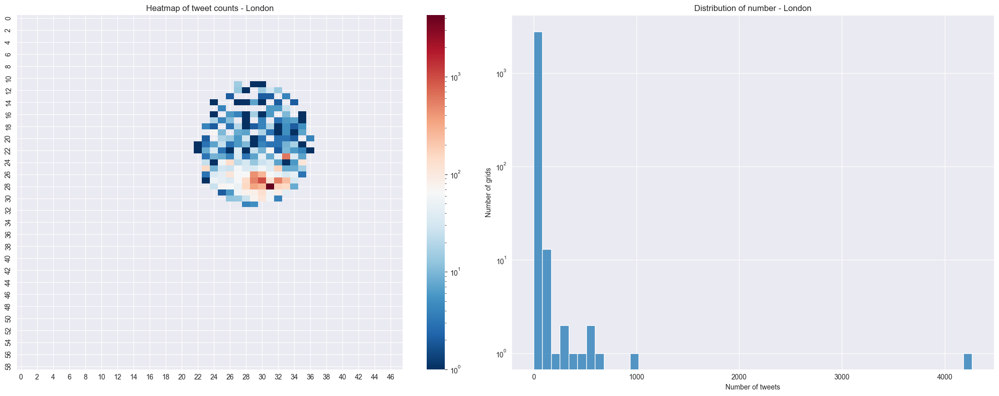

In [25]:
draw_combined()

## Task 2

In [26]:
def term_scoring(query_term, threshold_s, remove_stopwords, bg_choice):
    """
    Calculate the score of a word according to the given conditions
    
    :param query_term: The term to query
    :param threshold_s: Threshold S
    :param remove_stopwords: Whether to remove stopwords
    :param bg_choice: Choice of background data
    :return: shQt, slQt
    """
    print_level('-------- Start term_scoring --------', 1)

    print_level(f'query_term: {query_term}', 2)

    print_level(f'threshold_s: {threshold_s}', 2)
    print_level(f'remove_stopwords: {remove_stopwords}', 2)
    print_level(f'bg_choice: {bg_choice}', 2)

    # Choose different term frequency statistics results according to whether stopwords are removed
    if remove_stopwords:  # If stopwords are removed
        count_HQ = g_count_high_quality_remove_stopwords
        count_LQ = g_count_low_quality_remove_stopwords
        # Choose background data
        if bg_choice == 'bg':  # Use bg data
            count_bg = g_count_bg_quality_remove_stopwords
        elif bg_choice == 'geo':  # Use geo data
            count_bg = g_count_geo_quality_remove_stopwords
        elif bg_choice == 'bg+geo':  # Use geo+bg data
            # count_bg = g_count_geo_quality_remove_stopwords + g_count_bg_quality_remove_stopwords
            count_bg = g_count_geo_bg_quality_remove_stopwords
    else:  # If stopwords are not removed
        count_HQ = g_count_high_quality_keep_stopwords
        count_LQ = g_count_low_quality_keep_stopwords
        if bg_choice == 'bg':  # Use bg data
            count_bg = g_count_bg_quality_keep_stopwords
        elif bg_choice == 'geo':  # Use geo data
            count_bg = g_count_geo_quality_keep_stopwords
        elif bg_choice == 'bg+geo':  # Use geo+bg data
            # count_bg = g_count_geo_quality_keep_stopwords + g_count_bg_quality_remove_stopwords
            count_bg = g_count_geo_bg_quality_keep_stopwords

    phQt = count_HQ.get(query_term, 0) / sum(count_HQ.values())
    plQt = count_LQ.get(query_term, 0) / sum(count_LQ.values())
    pbQt = count_bg.get(query_term, 0) / sum(count_bg.values())

    print_level(f'phQt: {phQt}, plQt: {plQt}, pbQt: {pbQt}', 2)

    rhqt = phQt / pbQt
    rlqt = plQt / pbQt

    print_level(f'rhqt: {rhqt}, rlqt: {rlqt}', 2)

    if rhqt > threshold_s:
        shQt = rhqt
    else:
        shQt = 0

    if rlqt > threshold_s:
        slQt = rlqt
    else:
        slQt = 0

    print_level(f'shQt: {shQt}, slQt: {slQt}', 2)

    return shQt, slQt


In [27]:
def newsworthiness(tweet_token_texts, threshold_s, remove_stopwords, bg_choice):
    """
    Calculate the newsworthiness score of a document
    
    :param tweet_token_texts: List of tokens in the document
    :param threshold_s: Threshold S
    :param remove_stopwords: Whether to remove deactivated words
    :param bg_choice:  Choice of background data
    :return: Total newsworthiness score of the document
    """
    print_level('-------- Start newsworthiness --------', 1)
    # If tweet_token_texts is None, return None directly, making newsworthiness Score also None
    if tweet_token_texts is None:
        return None

    count_shQt = 0
    count_slQt = 0
    for queryTerm in tweet_token_texts:
        shQt, slQt = term_scoring(queryTerm, threshold_s, remove_stopwords, bg_choice)
        count_shQt += shQt
        count_slQt += slQt
    newsworthiness_score = math.log2((1 + count_shQt) / (1 + count_slQt))

    print_level(f'newsworthinessScore: {newsworthiness_score}', 2)

    return newsworthiness_score


In [28]:
def print_top_n(df, column_name, n):
    """
    Print the top n and bottom n text contents based on the specified column for manual inspection
    
    :param df: DataFrame containing the data
    :param column_name: Name of the column to output
    :param n: Number of top and bottom entries to print
    """
    print_level(f'top {n} {column_name}:\n', 0)
    top_n = df.nlargest(n, column_name, keep='all')
    for num, (index, row) in enumerate(top_n.iterrows()):
        print_level(f'Top {num + 1}: {row[column_name]:.4f}, text: {row["text"]}\n', 0)

    print_level(f'bottom {n} {column_name}:\n', 0)
    bottom_n = df.nsmallest(n, column_name, keep='all')
    for num, (index, row) in enumerate(bottom_n.iterrows()):
        print_level(f'Bottom {num + 1}: {row[column_name]:.4f}, text: {row["text"]}\n', 0)


In [29]:
def newsworthiness_scoring(df: pd.DataFrame, flag_in_geo: bool, remove_stopwords: bool, bg_choice: str,
                           thresholds_s: float,
                           factor_nsw: float):
    """
    Calculate different total quality scores based on conditions. The total quality score is the weighted sum of the newsworthiness score and the original quality score.
    Plotting histograms and box-and-line plots with normal distribution curves
    Print data for manual inspection
    
    :param df: Data to be processed
    :param flag_in_geo: Whether the data to be queried and scored is geo data or bg data. True for geo data, False for bg data
    :param remove_stopwords: Whether to remove stopwords
    :param thresholds_s: The threshold value used when calculating S value
    :param factor_nsw: Weight of the newsworthiness score
    :param bg_choice: Choice of background data, 0 means using bg data, 1 means using geo data, 2 means using bg+geo data
    :return: List of newsworthiness scores, list of total quality scores
    """
    print_level('-------- Start bg_quality_score --------', 1)

    if flag_in_geo:  # Task 3
        print_level(f'len: {len(df)}', 1)

        if remove_stopwords:  # Choose different lists of data for querying in different situations
            # Calculate the newsworthiness score
            nsw_s_column_name = f"nsw_s_{remove_stopwords}_{bg_choice}_{thresholds_s}"
            df[nsw_s_column_name] = df['token_text_remove_stopwords'].apply(newsworthiness,
                                                                            args=(
                                                                            thresholds_s, remove_stopwords, bg_choice))
        else:
            # Calculate the newsworthiness score
            nsw_s_column_name = f"nsw_s_{remove_stopwords}_{bg_choice}_{thresholds_s}"
            df[nsw_s_column_name] = df['token_text_keep_stopwords'].apply(newsworthiness,
                                                                          args=(
                                                                          thresholds_s, remove_stopwords, bg_choice))

        # Calculate the total quality score: the weighted sum of the newsworthiness score and the original quality score
        q_s_column_name = f'q_s_{remove_stopwords}_{bg_choice}_{thresholds_s}_{factor_nsw}'
        df[q_s_column_name] = df.apply(
            lambda row: factor_nsw * row[nsw_s_column_name] + (1 - factor_nsw) * row['score'],
            axis=1)
        # Plot histograms
        plot_histograms_and_boxplots_with_normal_curve(df, nsw_s_column_name, q_s_column_name)

        # Set conditions for plotting the grid map and its distribution
        condition_mean_std = df[nsw_s_column_name] > df[nsw_s_column_name].mean() + df[nsw_s_column_name].std()
        condition_mean_2std = df[nsw_s_column_name] > df[nsw_s_column_name].mean() + 2 * df[nsw_s_column_name].std()
        condition_mean_3std = df[nsw_s_column_name] > df[nsw_s_column_name].mean() + 3 * df[nsw_s_column_name].std()

        # Plot the grid map and its distribution data according to the conditions
        draw_heatmap_histogram(df, nsw_s_column_name, 'all')
        draw_heatmap_histogram(df, nsw_s_column_name, 'mean_std', condition_mean_std)
        draw_heatmap_histogram(df, nsw_s_column_name, 'mean_2std', condition_mean_2std)
        draw_heatmap_histogram(df, nsw_s_column_name, 'mean_3std', condition_mean_3std)

        draw_heatmap_histogram(df, q_s_column_name, 'all')
        draw_heatmap_histogram(df, q_s_column_name, 'mean_std', condition_mean_std)
        draw_heatmap_histogram(df, q_s_column_name, 'mean_2std', condition_mean_2std)
        draw_heatmap_histogram(df, q_s_column_name, 'mean_3std', condition_mean_3std)

        # Print data for manual inspection
        print_top_n(df, nsw_s_column_name, PRINT_NUM)
        print_top_n(df, q_s_column_name, PRINT_NUM)

    else:  # Task 2

        print_level(f'len: {len(df)}', 1)

        # Calculate the newsworthiness score
        nsw_s_column_name = f"nsw_s_{remove_stopwords}_{bg_choice}_{thresholds_s}"
        df[nsw_s_column_name] = df['text'].apply(newsworthiness,
                                                 args=(thresholds_s, remove_stopwords, bg_choice))

        # Calculate the total quality score: the weighted sum of the newsworthiness score and the original quality score
        q_s_column_name = f'q_s_{remove_stopwords}_{bg_choice}_{thresholds_s}_{factor_nsw}'
        df[q_s_column_name] = df.apply(
            lambda row: factor_nsw * row[nsw_s_column_name] + (1 - factor_nsw) * row['score'],
            axis=1)
        # Plot histograms
        plot_histograms_and_boxplots_with_normal_curve(df, nsw_s_column_name, q_s_column_name)

        # Print data for manual inspection
        print_top_n(df, nsw_s_column_name, PRINT_NUM)
        print_top_n(df, q_s_column_name, PRINT_NUM)


In [30]:
def plot_histograms_and_boxplots_with_normal_curve(df, nsw_col, qs_col):
    """
    Plot histograms and boxplots with normal distribution curve added to each plot
    
    :param df: Data to be passed in
    :param nsw_col: Column where nsw_s data is located
    :param qs_col: Column where q_s data is located
    """
    # Define color palette
    palette = sns.color_palette('dark')  # Choose one

    def plot_histograms_with_normal_curve(ax, column, color):
        # Calculate mean and standard deviation
        mean = df[column].mean()
        std = df[column].std()
        count = len(df[column])

        # Calculate the number of values greater than mean+std, mean+2std, mean+3std
        count_std = sum(df[column] > mean + std)
        count_2std = sum(df[column] > mean + 2 * std)
        count_3std = sum(df[column] > mean + 3 * std)

        valid_count = df[column].count()  # valid value
        min_value = df[column].min()
        percentile_25 = df[column].quantile(0.25)
        median = df[column].median()  # The median is the second quartile
        percentile_75 = df[column].quantile(0.75)
        max_value = df[column].max()
        range = df[column].max() - df[column].min()
        mode = df[column].mode()[0]
        count_eq_mode = sum(df[column] == mode)
        skew = df[column].skew()  # skewness
        kurtosis = df[column].kurtosis()  # kurtosis

        ratio_valid_count = valid_count / count * 100

        ratio_std_all = count_std / count * 100
        ratio_2std_all = count_2std / count * 100
        ratio_3std_all = count_3std / count * 100
        ratio_eq_mode_all = count_eq_mode / count * 100

        ratio_std_valid = count_std / valid_count * 100
        ratio_2std_valid = count_2std / valid_count * 100
        ratio_3std_valid = count_3std / valid_count * 100
        ratio_eq_mode_valid = count_eq_mode / valid_count * 100

        # Plot histograms
        count, bins, _ = ax.hist(df[column], bins=30, color=color, density=False, label=f'{column} Histogram')

        # Fit normal distribution curve
        bin_centers = np.linspace(bins[0], bins[-1], 400)
        scale_factor = np.diff(bins)[0] * len(df[column])  # Width of each bar times total sample size
        pdf = norm.pdf(bin_centers, mean, std) * scale_factor  # Adjust the y value of the normal distribution curve
        ax.plot(bin_centers, pdf, 'k-', linewidth=2, label='Normal fit')

        # Add mean and standard deviation lines
        ax.axvline(mean, color=palette[2], linestyle='dashed', linewidth=2, label='Mean')
        ax.axvline(mean + std, color=palette[3], linestyle='dashed', linewidth=2, label='Mean + 1 Std')
        ax.axvline(mean + 2 * std, color=palette[4], linestyle='dashed', linewidth=2, label='Mean + 2 Std')
        ax.axvline(mean + 3 * std, color=palette[6], linestyle='dashed', linewidth=2, label='Mean + 3 Std')

        # Add text in the blank area on the left
        ax.text(0.02, 0.70, f'valid value: {valid_count} ({ratio_valid_count:.2f}%)',
                transform=ax.transAxes, verticalalignment='top', fontsize=10)
        ax.text(0.02, 0.66, f'min: {min_value:.2f}', transform=ax.transAxes, verticalalignment='top', fontsize=10)
        ax.text(0.02, 0.62, f'25%: {percentile_25:.2f}', transform=ax.transAxes, verticalalignment='top', fontsize=10)
        ax.text(0.02, 0.58, f'median: {median:.2f}', transform=ax.transAxes, verticalalignment='top', fontsize=10)
        ax.text(0.02, 0.54, f'75%: {percentile_75:.2f}', transform=ax.transAxes, verticalalignment='top', fontsize=10)
        ax.text(0.02, 0.50, f'max: {max_value:.2f}', transform=ax.transAxes, verticalalignment='top', fontsize=10)
        ax.text(0.02, 0.46, f'range: {range:.2f}', transform=ax.transAxes, verticalalignment='top', fontsize=10)
        ax.text(0.02, 0.42, f'skew: {skew:.2f}', transform=ax.transAxes, verticalalignment='top', fontsize=10)
        ax.text(0.02, 0.38, f'kurtosis: {kurtosis:.2f}', transform=ax.transAxes, verticalalignment='top', fontsize=10)
        ax.text(0.02, 0.34, f'> Mean+Std: {count_std}',
                transform=ax.transAxes, verticalalignment='top', fontsize=10)
        ax.text(0.02, 0.30, f' ({ratio_std_all:.2f}% (all) {ratio_std_valid:.2f}% (valid))',
                transform=ax.transAxes, verticalalignment='top', fontsize=10)
        ax.text(0.02, 0.26, f'> Mean+2Std: {count_2std}',
                transform=ax.transAxes, verticalalignment='top', fontsize=10)
        ax.text(0.02, 0.22, f' ({ratio_2std_all:.2f}% (all) {ratio_2std_valid:.2f}% (valid))',
                transform=ax.transAxes, verticalalignment='top', fontsize=10)
        ax.text(0.02, 0.18, f'> Mean+3Std: {count_3std}',
                transform=ax.transAxes, verticalalignment='top', fontsize=10)
        ax.text(0.02, 0.14, f' ({ratio_3std_all:.2f}% (all) {ratio_3std_valid:.2f}% (valid))',
                transform=ax.transAxes, verticalalignment='top', fontsize=10)
        ax.text(0.02, 0.10, f'mode: {mode:.4f}; num: {count_eq_mode}',
                transform=ax.transAxes, verticalalignment='top', fontsize=10)
        ax.text(0.02, 0.06, f' ({ratio_eq_mode_all:.2f}% (all) {ratio_eq_mode_valid:.2f}% (valid))',
                transform=ax.transAxes, verticalalignment='top', fontsize=10)

        # Set title and display legend
        ax.set_title(f'{column} Distribution')
        ax.legend()

    def plot_scatter(ax, y_col, color, label):
        ax.scatter(df.index, df[y_col], alpha=0.5, color=color, label=label)
        ax.set_xlabel('index')
        ax.set_ylabel('score')
        ax.set_title(f'Score Relation with {nsw_col} and {qs_col}')
        ax.legend()
        ax.grid(True)

    # Use functions to plot histogram and scatter plot
    fig, axs = plt.subplots(1, 3, figsize=(18, 6))

    plot_histograms_with_normal_curve(axs[0], nsw_col, palette[0])
    plot_histograms_with_normal_curve(axs[1], qs_col, palette[1])
    plot_scatter(axs[2], nsw_col, palette[0], 'NSW Score')
    plot_scatter(axs[2], qs_col, palette[1], 'QS Score')

    info = qs_col.split('_')

    s_title = f'remove_stopwords: {info[-4]}, bg_choice: {info[-3]}, thresholds_s: {info[-2]}, factor_nsw: {info[-1]}'
    fig.suptitle(s_title, fontsize=14, fontweight='bold')

    plt.tight_layout()

    s_file_name = f'{info[-4]}_{info[-3]}_{info[-2]}_{info[-1]}'
    plt.savefig(f'{CURRENT_OUTPUT}/{s_file_name}.png')

    plt.show()

In [31]:
def draw_total_statistic(df, flag_in_geo: bool):
    """
    Draw line comparison plots of histograms for all news scores and total quality scores
    
    :param df: Data to be processed
    :param flag_in_geo: Whether the data to query and calculate the score is geo data or bg data. 
                        True for geo data, False for bg data
    """
    if flag_in_geo:  # That is, task3, from the 7th column onwards are score-related columns
        start_num = 7
    else:  # That is, task2, from the 2nd column onwards are score-related columns
        start_num = 2
    # Data processing: calculate the counts of mean+std, mean+2std, mean+3std
    std_metrics = {}
    for col in df.columns[start_num:]:  # Only for score-related columns
        mean_val = df[col].mean()
        std_val = df[col].std()
        std_metrics[col] = [
            (df[col] > (mean_val + std_val)).sum(),
            (df[col] > (mean_val + 2 * std_val)).sum(),
            (df[col] > (mean_val + 3 * std_val)).sum()
        ]

    # Convert to DataFrame for plotting
    std_metrics_df = pd.DataFrame.from_dict(std_metrics, orient='index', columns=['mean+std', 'mean+2std', 'mean+3std'])

    # Adjusting the size and layout of the figures to enhance readability
    fig, axs = plt.subplots(1, 2, figsize=(16, 6), tight_layout=True)

    # Line Plot
    std_metrics_df.plot(kind='line', marker='o', ax=axs[0])
    axs[0].set_title('Counts Above mean+std, mean+2std, mean+3std', fontsize=12, fontweight='bold')
    axs[0].set_xlabel('Metrics')
    axs[0].set_xticks(range(len(std_metrics_df)))  # Set the position of the ticks
    axs[0].set_xticklabels(std_metrics_df.index, rotation=90, fontsize=10)  # Set the tick labels
    axs[0].set_ylabel('Count')
    axs[0].legend(title='Thresholds')
    axs[0].grid(True)
    
    if flag_in_geo:  # task3:
        # box plot
        boxplot_data_all = df.loc[:, 'score':]
        sns.boxplot(data=boxplot_data_all, ax=axs[1])
        axs[1].set_title('Boxplots of scores and geography ratings')
        axs[1].set_xticklabels(axs[1].get_xticklabels(), rotation=45)
        
    else:  # task2
        # Boxplot - Including more detailed analysis for outliers
        df[df.columns[2:]].boxplot(ax=axs[1], rot=45, fontsize=10)
        axs[1].set_title('Metrics Distribution with Outliers')
    
        tick_positions = range(len(df.columns[start_num:]))  # Positions for each tick
        tick_labels = df.columns[start_num:]  # Labels for each tick
    
        axs[1].set_xticks(tick_positions)  # Set the tick positions
        axs[1].set_xticklabels(tick_labels, rotation=90, fontsize=10)  # Set the tick labels
        axs[1].set_title('Metrics Distribution with Outliers', fontsize=12, fontweight='bold')

    plt.tight_layout()
    plt.savefig(f'{CURRENT_OUTPUT}/total_statistic.png')
    plt.show()


In [32]:
def statistic2():
    """
    Calculate the newsworthiness score and total quality score for task2, and draw the corresponding histogram and box-and-line plot
    
    """
    # Data processing for task2
    df_bg = pd.DataFrame(g_bg_quality)
    print_level(f'len: {len(df_bg)}', 0)
    for remove_stopwords in [True, False]:
        for thresholds_s in [1, 2, 3]:
            for factor_nsw in [0.2, 0.5, 0.8]:
                print_level(
                    f'remove_stopwords: {remove_stopwords}, bg_choice: bg, thresholds_s: {thresholds_s}, factor_nsw: {factor_nsw}',
                    0)

                newsworthiness_scoring(df_bg, False, remove_stopwords, 'bg',
                                       thresholds_s, factor_nsw)

    display(df_bg)
    draw_total_statistic(df_bg, False)
    df_bg.to_csv('TempData/df_bg.csv')


In [33]:
pd.DataFrame(g_bg_quality)

,_id,text,score
0,1613006911946776576,"[confidence, dont, fix, lost, need, negative, ...",0.636730
1,1613006916246179840,"[academic, age, approaching, best, biogerontol...",0.614933
2,1613006917810683904,"[album, dreams, london, underrated]",0.541453
3,1613006921556185089,"[apartment, leaky, month, new, paying, pipes, ...",0.636528
4,1613006922894000128,"[carabao, confirmed, congestion, cup, dates, f...",0.589902
...,...,...,...
2234,1615746986057007113,"[@Sunita_Says_, provoking, thought]",0.665500
2235,1615746987940511744,"[@GMB, @Lilly26062173, @edballs, beds, care, d...",0.586667
2236,1615746988481314818,"[2nd, @leahwillFP6, allowed, arsenal, beth, cl...",0.674884
2237,1615746990251593729,"[eat, say, wanna, wear]",0.629744


len: 2239
remove_stopwords: True, bg_choice: bg, thresholds_s: 1, factor_nsw: 0.2


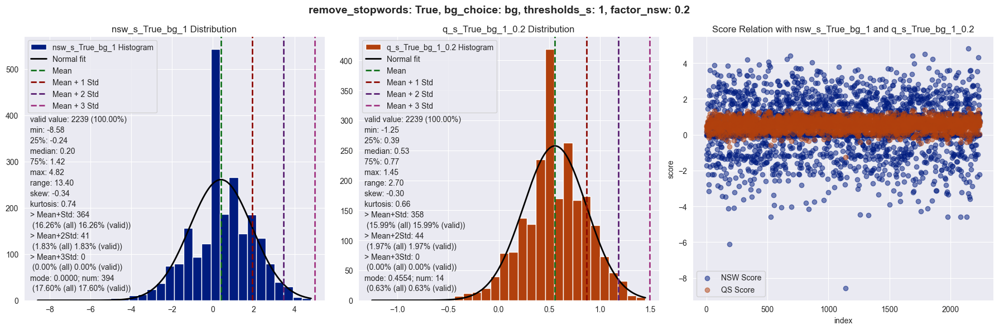

top 10 nsw_s_True_bg_1:

Top 1: 4.8170, text: ['#FoxNews', 'day', 'drinking', 'hotels', 'migrants', 'new', 'sex', 'stairs', 'taxpayerfunded', 'whistleblower', 'york']

Top 2: 4.4971, text: ['#hiring', '#job:', '#jobs', 'admin', 'based', 'construction', 'dublin', 'https://t.co/ZtYiMBUzmz', 'location', 'new', 'office', 'salary', 'sales', 'south', '€37kpa', '€42k', '€46kpa']

Top 3: 4.4168, text: ['2023', '25th', 'book', 'canapes', 'centre', 'circle', 'city', 'cost', 'drink', 'expand', 'gusto', 'includes', 'jan', 'looking', 'manchester', 'network', 'new', 'place', 'professional', 'sponsors', 'ticket', 'weds', 'welcome', 'year']

Top 4: 4.4137, text: ['#booknow', '#cuttingedgemechanics', '#winterservicing', 'book', 'dont', 'full', 'please', 'servicing', 'spring', 'swing', 'wait']

Top 5: 4.3066, text: ['#Retail', '71559', 'barista', 'high', 'hiring', 'holborn', 'job', 'latest', 'opening', 'read', 'store']

Top 6: 4.2353, text: ['#China', 'accused', 'buying', 'company', 'government', 'semic

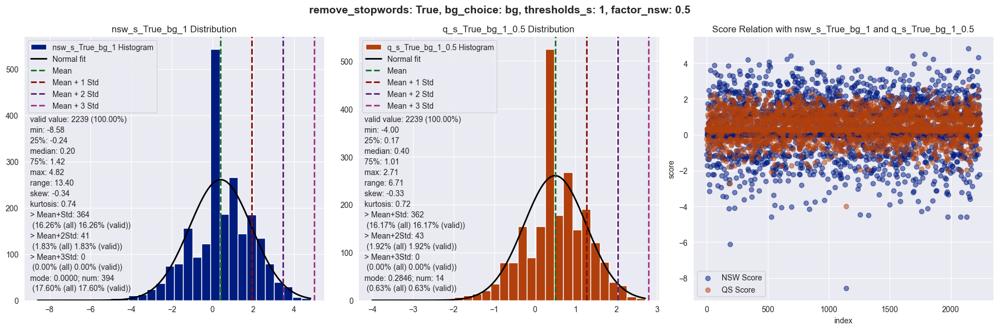

top 10 nsw_s_True_bg_1:

Top 1: 4.8170, text: ['#FoxNews', 'day', 'drinking', 'hotels', 'migrants', 'new', 'sex', 'stairs', 'taxpayerfunded', 'whistleblower', 'york']

Top 2: 4.4971, text: ['#hiring', '#job:', '#jobs', 'admin', 'based', 'construction', 'dublin', 'https://t.co/ZtYiMBUzmz', 'location', 'new', 'office', 'salary', 'sales', 'south', '€37kpa', '€42k', '€46kpa']

Top 3: 4.4168, text: ['2023', '25th', 'book', 'canapes', 'centre', 'circle', 'city', 'cost', 'drink', 'expand', 'gusto', 'includes', 'jan', 'looking', 'manchester', 'network', 'new', 'place', 'professional', 'sponsors', 'ticket', 'weds', 'welcome', 'year']

Top 4: 4.4137, text: ['#booknow', '#cuttingedgemechanics', '#winterservicing', 'book', 'dont', 'full', 'please', 'servicing', 'spring', 'swing', 'wait']

Top 5: 4.3066, text: ['#Retail', '71559', 'barista', 'high', 'hiring', 'holborn', 'job', 'latest', 'opening', 'read', 'store']

Top 6: 4.2353, text: ['#China', 'accused', 'buying', 'company', 'government', 'semic

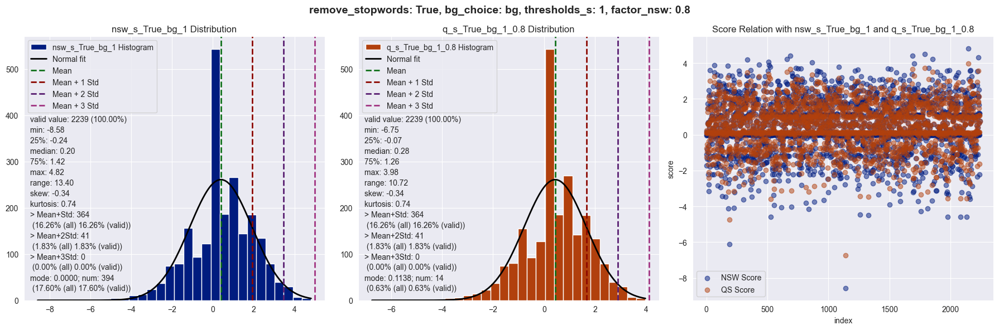

top 10 nsw_s_True_bg_1:

Top 1: 4.8170, text: ['#FoxNews', 'day', 'drinking', 'hotels', 'migrants', 'new', 'sex', 'stairs', 'taxpayerfunded', 'whistleblower', 'york']

Top 2: 4.4971, text: ['#hiring', '#job:', '#jobs', 'admin', 'based', 'construction', 'dublin', 'https://t.co/ZtYiMBUzmz', 'location', 'new', 'office', 'salary', 'sales', 'south', '€37kpa', '€42k', '€46kpa']

Top 3: 4.4168, text: ['2023', '25th', 'book', 'canapes', 'centre', 'circle', 'city', 'cost', 'drink', 'expand', 'gusto', 'includes', 'jan', 'looking', 'manchester', 'network', 'new', 'place', 'professional', 'sponsors', 'ticket', 'weds', 'welcome', 'year']

Top 4: 4.4137, text: ['#booknow', '#cuttingedgemechanics', '#winterservicing', 'book', 'dont', 'full', 'please', 'servicing', 'spring', 'swing', 'wait']

Top 5: 4.3066, text: ['#Retail', '71559', 'barista', 'high', 'hiring', 'holborn', 'job', 'latest', 'opening', 'read', 'store']

Top 6: 4.2353, text: ['#China', 'accused', 'buying', 'company', 'government', 'semic

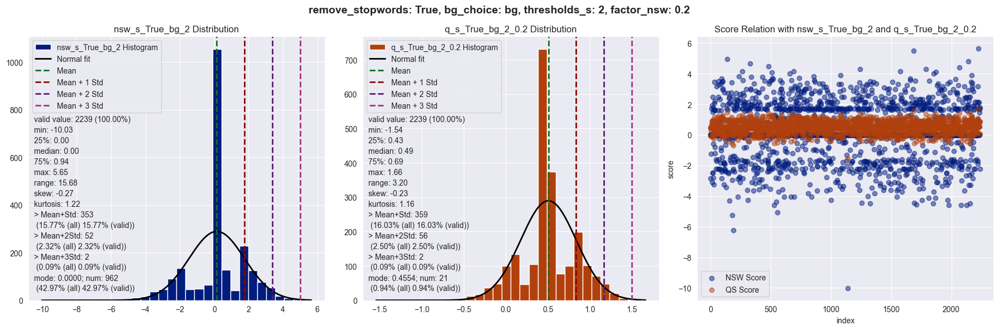

top 10 nsw_s_True_bg_2:

Top 1: 5.6482, text: ['#Retail', '71559', 'barista', 'high', 'hiring', 'holborn', 'job', 'latest', 'opening', 'read', 'store']

Top 2: 5.4861, text: ['#booknow', '#cuttingedgemechanics', '#winterservicing', 'book', 'dont', 'full', 'please', 'servicing', 'spring', 'swing', 'wait']

Top 3: 4.9399, text: ['action', 'arising', 'away', 'blueprint', 'built', 'cant', 'conscience', 'defecating', 'deliberate', 'drinking', 'eating', 'running', 'threat', 'unconscious', 'walking', 'wiped']

Top 4: 4.8170, text: ['#FoxNews', 'day', 'drinking', 'hotels', 'migrants', 'new', 'sex', 'stairs', 'taxpayerfunded', 'whistleblower', 'york']

Top 5: 4.6560, text: ['apply', 'available', 'babysitter', 'contact', 'hotel', 'information', 'lovely', 'marriott', 'opportunities', 'park', 'please', 'position', 'regents', 'role', 'send', 'visit', 'website']

Top 6: 4.4833, text: ['2022', '2023', 'activity', 'careers', 'consultancy', 'employers', 'engagement', 'explains', 'fluctuated', 'head', '

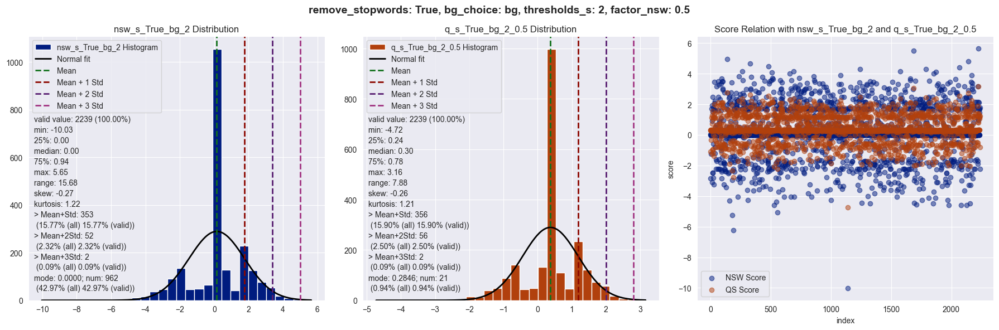

top 10 nsw_s_True_bg_2:

Top 1: 5.6482, text: ['#Retail', '71559', 'barista', 'high', 'hiring', 'holborn', 'job', 'latest', 'opening', 'read', 'store']

Top 2: 5.4861, text: ['#booknow', '#cuttingedgemechanics', '#winterservicing', 'book', 'dont', 'full', 'please', 'servicing', 'spring', 'swing', 'wait']

Top 3: 4.9399, text: ['action', 'arising', 'away', 'blueprint', 'built', 'cant', 'conscience', 'defecating', 'deliberate', 'drinking', 'eating', 'running', 'threat', 'unconscious', 'walking', 'wiped']

Top 4: 4.8170, text: ['#FoxNews', 'day', 'drinking', 'hotels', 'migrants', 'new', 'sex', 'stairs', 'taxpayerfunded', 'whistleblower', 'york']

Top 5: 4.6560, text: ['apply', 'available', 'babysitter', 'contact', 'hotel', 'information', 'lovely', 'marriott', 'opportunities', 'park', 'please', 'position', 'regents', 'role', 'send', 'visit', 'website']

Top 6: 4.4833, text: ['2022', '2023', 'activity', 'careers', 'consultancy', 'employers', 'engagement', 'explains', 'fluctuated', 'head', '

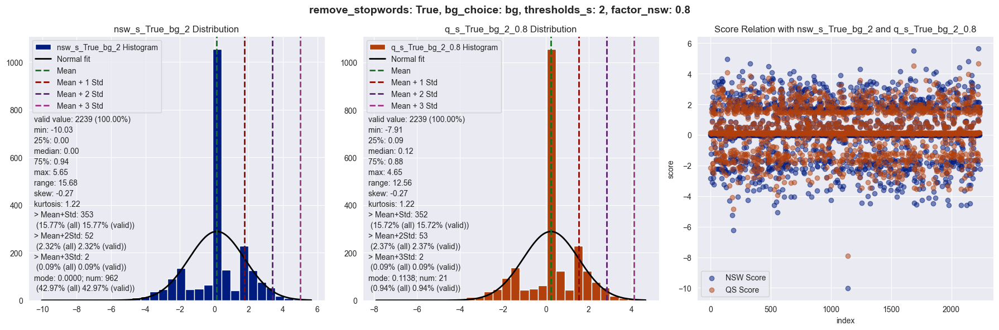

top 10 nsw_s_True_bg_2:

Top 1: 5.6482, text: ['#Retail', '71559', 'barista', 'high', 'hiring', 'holborn', 'job', 'latest', 'opening', 'read', 'store']

Top 2: 5.4861, text: ['#booknow', '#cuttingedgemechanics', '#winterservicing', 'book', 'dont', 'full', 'please', 'servicing', 'spring', 'swing', 'wait']

Top 3: 4.9399, text: ['action', 'arising', 'away', 'blueprint', 'built', 'cant', 'conscience', 'defecating', 'deliberate', 'drinking', 'eating', 'running', 'threat', 'unconscious', 'walking', 'wiped']

Top 4: 4.8170, text: ['#FoxNews', 'day', 'drinking', 'hotels', 'migrants', 'new', 'sex', 'stairs', 'taxpayerfunded', 'whistleblower', 'york']

Top 5: 4.6560, text: ['apply', 'available', 'babysitter', 'contact', 'hotel', 'information', 'lovely', 'marriott', 'opportunities', 'park', 'please', 'position', 'regents', 'role', 'send', 'visit', 'website']

Top 6: 4.4833, text: ['2022', '2023', 'activity', 'careers', 'consultancy', 'employers', 'engagement', 'explains', 'fluctuated', 'head', '

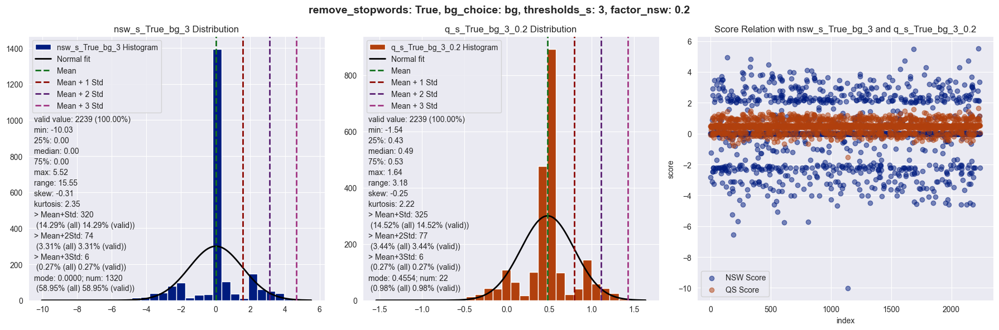

top 10 nsw_s_True_bg_3:

Top 1: 5.5179, text: ['#Retail', '71559', 'barista', 'high', 'hiring', 'holborn', 'job', 'latest', 'opening', 'read', 'store']

Top 2: 5.4861, text: ['#booknow', '#cuttingedgemechanics', '#winterservicing', 'book', 'dont', 'full', 'please', 'servicing', 'spring', 'swing', 'wait']

Top 3: 4.9399, text: ['action', 'arising', 'away', 'blueprint', 'built', 'cant', 'conscience', 'defecating', 'deliberate', 'drinking', 'eating', 'running', 'threat', 'unconscious', 'walking', 'wiped']

Top 4: 4.8418, text: ['#handmade', '#hats', '#shopindie', 'custom', 'far', 'good', 'hat', 'long', 'looking', 'pretty', 'today', 'version', 'way', 'yet']

Top 5: 4.7049, text: ['addict', 'air', 'alcoholic', 'behaviour', 'believe', 'cant', 'disgraceful', 'drinking', 'drug', 'well']

Top 6: 4.7049, text: ['#FoxNews', 'day', 'drinking', 'hotels', 'migrants', 'new', 'sex', 'stairs', 'taxpayerfunded', 'whistleblower', 'york']

Top 7: 4.4833, text: ['2022', '2023', 'activity', 'careers', 'cons

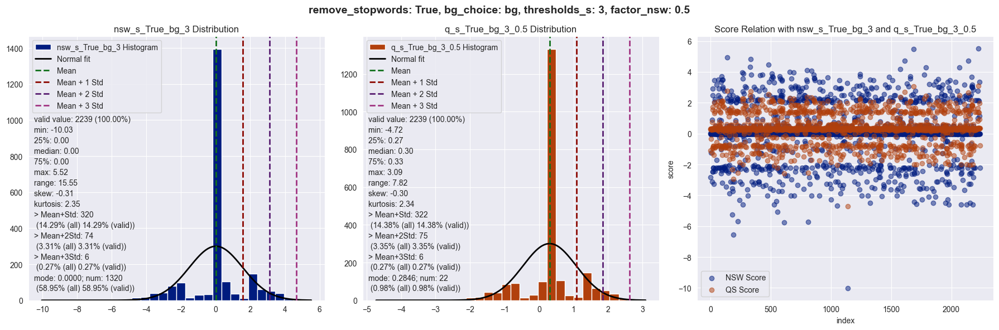

top 10 nsw_s_True_bg_3:

Top 1: 5.5179, text: ['#Retail', '71559', 'barista', 'high', 'hiring', 'holborn', 'job', 'latest', 'opening', 'read', 'store']

Top 2: 5.4861, text: ['#booknow', '#cuttingedgemechanics', '#winterservicing', 'book', 'dont', 'full', 'please', 'servicing', 'spring', 'swing', 'wait']

Top 3: 4.9399, text: ['action', 'arising', 'away', 'blueprint', 'built', 'cant', 'conscience', 'defecating', 'deliberate', 'drinking', 'eating', 'running', 'threat', 'unconscious', 'walking', 'wiped']

Top 4: 4.8418, text: ['#handmade', '#hats', '#shopindie', 'custom', 'far', 'good', 'hat', 'long', 'looking', 'pretty', 'today', 'version', 'way', 'yet']

Top 5: 4.7049, text: ['addict', 'air', 'alcoholic', 'behaviour', 'believe', 'cant', 'disgraceful', 'drinking', 'drug', 'well']

Top 6: 4.7049, text: ['#FoxNews', 'day', 'drinking', 'hotels', 'migrants', 'new', 'sex', 'stairs', 'taxpayerfunded', 'whistleblower', 'york']

Top 7: 4.4833, text: ['2022', '2023', 'activity', 'careers', 'cons

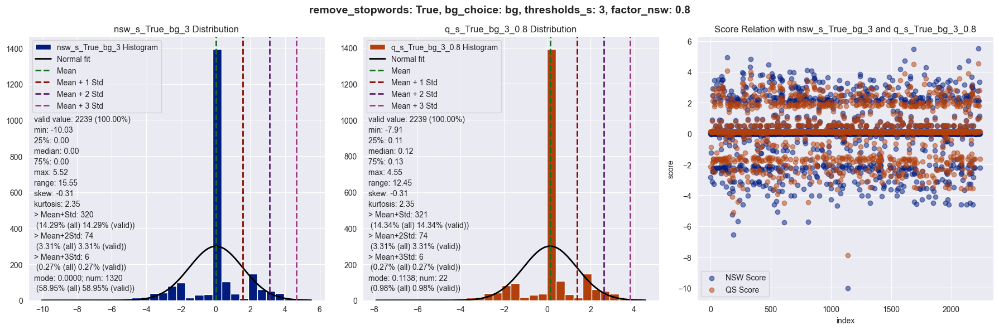

top 10 nsw_s_True_bg_3:

Top 1: 5.5179, text: ['#Retail', '71559', 'barista', 'high', 'hiring', 'holborn', 'job', 'latest', 'opening', 'read', 'store']

Top 2: 5.4861, text: ['#booknow', '#cuttingedgemechanics', '#winterservicing', 'book', 'dont', 'full', 'please', 'servicing', 'spring', 'swing', 'wait']

Top 3: 4.9399, text: ['action', 'arising', 'away', 'blueprint', 'built', 'cant', 'conscience', 'defecating', 'deliberate', 'drinking', 'eating', 'running', 'threat', 'unconscious', 'walking', 'wiped']

Top 4: 4.8418, text: ['#handmade', '#hats', '#shopindie', 'custom', 'far', 'good', 'hat', 'long', 'looking', 'pretty', 'today', 'version', 'way', 'yet']

Top 5: 4.7049, text: ['addict', 'air', 'alcoholic', 'behaviour', 'believe', 'cant', 'disgraceful', 'drinking', 'drug', 'well']

Top 6: 4.7049, text: ['#FoxNews', 'day', 'drinking', 'hotels', 'migrants', 'new', 'sex', 'stairs', 'taxpayerfunded', 'whistleblower', 'york']

Top 7: 4.4833, text: ['2022', '2023', 'activity', 'careers', 'cons

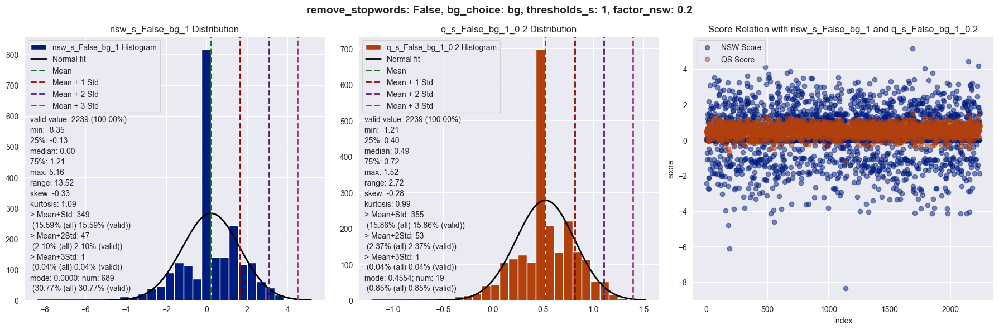

top 10 nsw_s_False_bg_1:

Top 1: 5.1627, text: ['#booknow', '#cuttingedgemechanics', '#winterservicing', 'book', 'dont', 'full', 'please', 'servicing', 'spring', 'swing', 'wait']

Top 2: 4.4427, text: ['#FoxNews', 'day', 'drinking', 'hotels', 'migrants', 'new', 'sex', 'stairs', 'taxpayerfunded', 'whistleblower', 'york']

Top 3: 4.1868, text: ['#Retail', '71559', 'barista', 'high', 'hiring', 'holborn', 'job', 'latest', 'opening', 'read', 'store']

Top 4: 4.1131, text: ['2022', '2023', 'activity', 'careers', 'consultancy', 'employers', 'engagement', 'explains', 'fluctuated', 'head', 'means', 'planning']

Top 5: 4.0425, text: ['#hiring', '#job:', '#jobs', 'admin', 'based', 'construction', 'dublin', 'https://t.co/ZtYiMBUzmz', 'location', 'new', 'office', 'salary', 'sales', 'south', '€37kpa', '€42k', '€46kpa']

Top 6: 3.8813, text: ['2023', '25th', 'book', 'canapes', 'centre', 'circle', 'city', 'cost', 'drink', 'expand', 'gusto', 'includes', 'jan', 'looking', 'manchester', 'network', 'new',

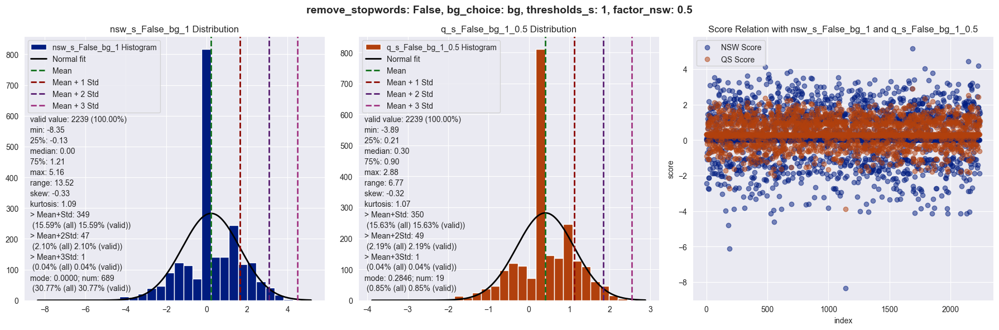

top 10 nsw_s_False_bg_1:

Top 1: 5.1627, text: ['#booknow', '#cuttingedgemechanics', '#winterservicing', 'book', 'dont', 'full', 'please', 'servicing', 'spring', 'swing', 'wait']

Top 2: 4.4427, text: ['#FoxNews', 'day', 'drinking', 'hotels', 'migrants', 'new', 'sex', 'stairs', 'taxpayerfunded', 'whistleblower', 'york']

Top 3: 4.1868, text: ['#Retail', '71559', 'barista', 'high', 'hiring', 'holborn', 'job', 'latest', 'opening', 'read', 'store']

Top 4: 4.1131, text: ['2022', '2023', 'activity', 'careers', 'consultancy', 'employers', 'engagement', 'explains', 'fluctuated', 'head', 'means', 'planning']

Top 5: 4.0425, text: ['#hiring', '#job:', '#jobs', 'admin', 'based', 'construction', 'dublin', 'https://t.co/ZtYiMBUzmz', 'location', 'new', 'office', 'salary', 'sales', 'south', '€37kpa', '€42k', '€46kpa']

Top 6: 3.8813, text: ['2023', '25th', 'book', 'canapes', 'centre', 'circle', 'city', 'cost', 'drink', 'expand', 'gusto', 'includes', 'jan', 'looking', 'manchester', 'network', 'new',

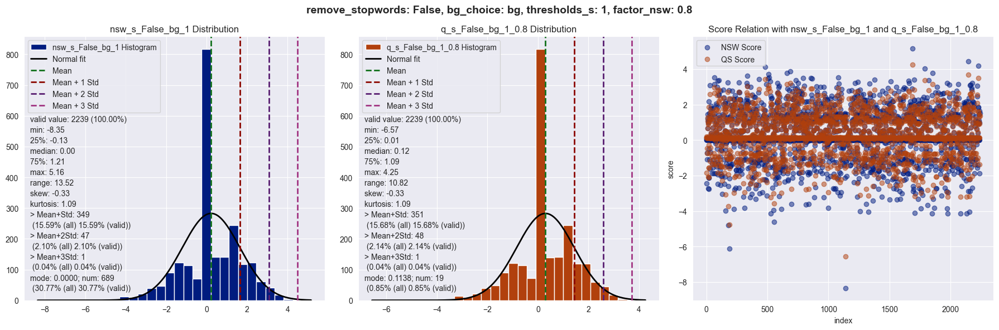

top 10 nsw_s_False_bg_1:

Top 1: 5.1627, text: ['#booknow', '#cuttingedgemechanics', '#winterservicing', 'book', 'dont', 'full', 'please', 'servicing', 'spring', 'swing', 'wait']

Top 2: 4.4427, text: ['#FoxNews', 'day', 'drinking', 'hotels', 'migrants', 'new', 'sex', 'stairs', 'taxpayerfunded', 'whistleblower', 'york']

Top 3: 4.1868, text: ['#Retail', '71559', 'barista', 'high', 'hiring', 'holborn', 'job', 'latest', 'opening', 'read', 'store']

Top 4: 4.1131, text: ['2022', '2023', 'activity', 'careers', 'consultancy', 'employers', 'engagement', 'explains', 'fluctuated', 'head', 'means', 'planning']

Top 5: 4.0425, text: ['#hiring', '#job:', '#jobs', 'admin', 'based', 'construction', 'dublin', 'https://t.co/ZtYiMBUzmz', 'location', 'new', 'office', 'salary', 'sales', 'south', '€37kpa', '€42k', '€46kpa']

Top 6: 3.8813, text: ['2023', '25th', 'book', 'canapes', 'centre', 'circle', 'city', 'cost', 'drink', 'expand', 'gusto', 'includes', 'jan', 'looking', 'manchester', 'network', 'new',

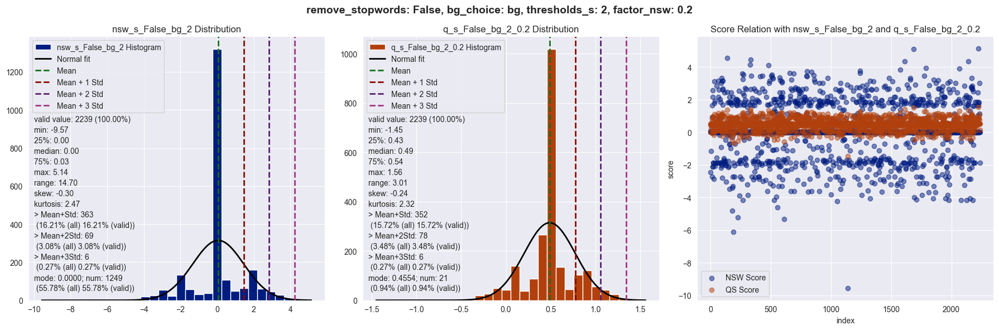

top 10 nsw_s_False_bg_2:

Top 1: 5.1375, text: ['#Retail', '71559', 'barista', 'high', 'hiring', 'holborn', 'job', 'latest', 'opening', 'read', 'store']

Top 2: 5.1059, text: ['#booknow', '#cuttingedgemechanics', '#winterservicing', 'book', 'dont', 'full', 'please', 'servicing', 'spring', 'swing', 'wait']

Top 3: 4.5643, text: ['action', 'arising', 'away', 'blueprint', 'built', 'cant', 'conscience', 'defecating', 'deliberate', 'drinking', 'eating', 'running', 'threat', 'unconscious', 'walking', 'wiped']

Top 4: 4.4672, text: ['#handmade', '#hats', '#shopindie', 'custom', 'far', 'good', 'hat', 'long', 'looking', 'pretty', 'today', 'version', 'way', 'yet']

Top 5: 4.3319, text: ['addict', 'air', 'alcoholic', 'behaviour', 'believe', 'cant', 'disgraceful', 'drinking', 'drug', 'well']

Top 6: 4.3319, text: ['#FoxNews', 'day', 'drinking', 'hotels', 'migrants', 'new', 'sex', 'stairs', 'taxpayerfunded', 'whistleblower', 'york']

Top 7: 4.1469, text: ['apply', 'available', 'babysitter', 'contac

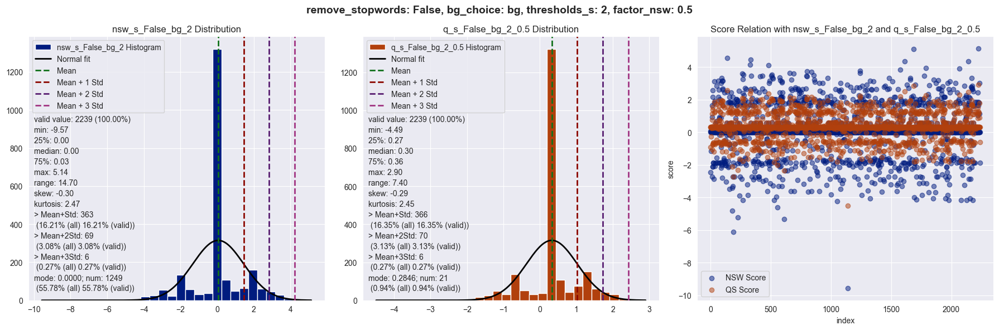

top 10 nsw_s_False_bg_2:

Top 1: 5.1375, text: ['#Retail', '71559', 'barista', 'high', 'hiring', 'holborn', 'job', 'latest', 'opening', 'read', 'store']

Top 2: 5.1059, text: ['#booknow', '#cuttingedgemechanics', '#winterservicing', 'book', 'dont', 'full', 'please', 'servicing', 'spring', 'swing', 'wait']

Top 3: 4.5643, text: ['action', 'arising', 'away', 'blueprint', 'built', 'cant', 'conscience', 'defecating', 'deliberate', 'drinking', 'eating', 'running', 'threat', 'unconscious', 'walking', 'wiped']

Top 4: 4.4672, text: ['#handmade', '#hats', '#shopindie', 'custom', 'far', 'good', 'hat', 'long', 'looking', 'pretty', 'today', 'version', 'way', 'yet']

Top 5: 4.3319, text: ['addict', 'air', 'alcoholic', 'behaviour', 'believe', 'cant', 'disgraceful', 'drinking', 'drug', 'well']

Top 6: 4.3319, text: ['#FoxNews', 'day', 'drinking', 'hotels', 'migrants', 'new', 'sex', 'stairs', 'taxpayerfunded', 'whistleblower', 'york']

Top 7: 4.1469, text: ['apply', 'available', 'babysitter', 'contac

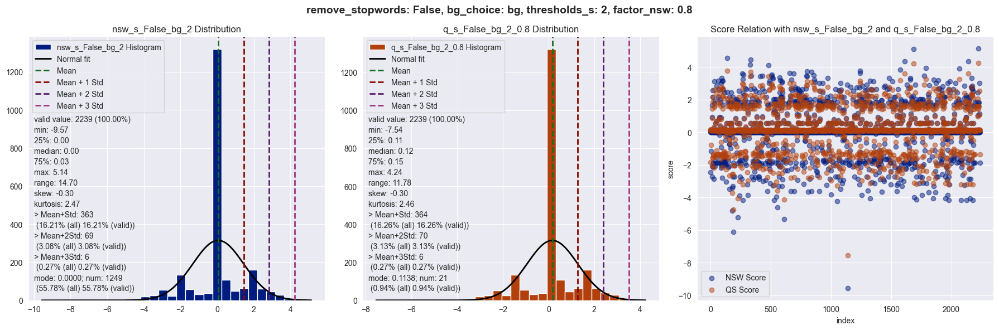

top 10 nsw_s_False_bg_2:

Top 1: 5.1375, text: ['#Retail', '71559', 'barista', 'high', 'hiring', 'holborn', 'job', 'latest', 'opening', 'read', 'store']

Top 2: 5.1059, text: ['#booknow', '#cuttingedgemechanics', '#winterservicing', 'book', 'dont', 'full', 'please', 'servicing', 'spring', 'swing', 'wait']

Top 3: 4.5643, text: ['action', 'arising', 'away', 'blueprint', 'built', 'cant', 'conscience', 'defecating', 'deliberate', 'drinking', 'eating', 'running', 'threat', 'unconscious', 'walking', 'wiped']

Top 4: 4.4672, text: ['#handmade', '#hats', '#shopindie', 'custom', 'far', 'good', 'hat', 'long', 'looking', 'pretty', 'today', 'version', 'way', 'yet']

Top 5: 4.3319, text: ['addict', 'air', 'alcoholic', 'behaviour', 'believe', 'cant', 'disgraceful', 'drinking', 'drug', 'well']

Top 6: 4.3319, text: ['#FoxNews', 'day', 'drinking', 'hotels', 'migrants', 'new', 'sex', 'stairs', 'taxpayerfunded', 'whistleblower', 'york']

Top 7: 4.1469, text: ['apply', 'available', 'babysitter', 'contac

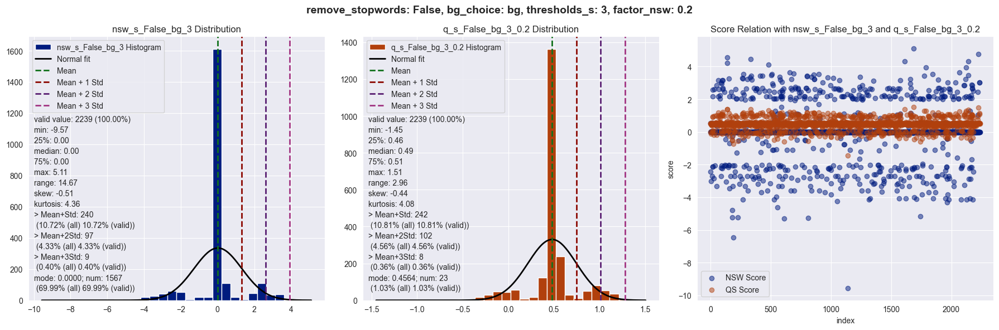

top 10 nsw_s_False_bg_3:

Top 1: 5.1059, text: ['#booknow', '#cuttingedgemechanics', '#winterservicing', 'book', 'dont', 'full', 'please', 'servicing', 'spring', 'swing', 'wait']

Top 2: 4.7760, text: ['#Retail', '71559', 'barista', 'high', 'hiring', 'holborn', 'job', 'latest', 'opening', 'read', 'store']

Top 3: 4.5643, text: ['action', 'arising', 'away', 'blueprint', 'built', 'cant', 'conscience', 'defecating', 'deliberate', 'drinking', 'eating', 'running', 'threat', 'unconscious', 'walking', 'wiped']

Top 4: 4.4672, text: ['#handmade', '#hats', '#shopindie', 'custom', 'far', 'good', 'hat', 'long', 'looking', 'pretty', 'today', 'version', 'way', 'yet']

Top 5: 4.3319, text: ['addict', 'air', 'alcoholic', 'behaviour', 'believe', 'cant', 'disgraceful', 'drinking', 'drug', 'well']

Top 6: 4.3319, text: ['#FoxNews', 'day', 'drinking', 'hotels', 'migrants', 'new', 'sex', 'stairs', 'taxpayerfunded', 'whistleblower', 'york']

Top 7: 4.2171, text: ['along', 'created', 'cycling', 'fakenham', 

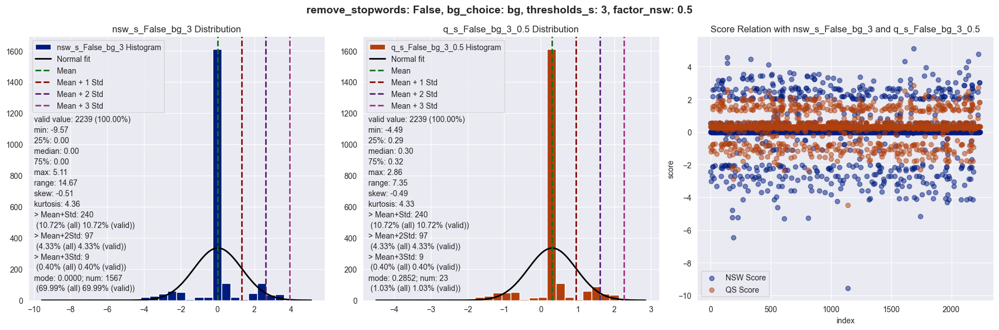

top 10 nsw_s_False_bg_3:

Top 1: 5.1059, text: ['#booknow', '#cuttingedgemechanics', '#winterservicing', 'book', 'dont', 'full', 'please', 'servicing', 'spring', 'swing', 'wait']

Top 2: 4.7760, text: ['#Retail', '71559', 'barista', 'high', 'hiring', 'holborn', 'job', 'latest', 'opening', 'read', 'store']

Top 3: 4.5643, text: ['action', 'arising', 'away', 'blueprint', 'built', 'cant', 'conscience', 'defecating', 'deliberate', 'drinking', 'eating', 'running', 'threat', 'unconscious', 'walking', 'wiped']

Top 4: 4.4672, text: ['#handmade', '#hats', '#shopindie', 'custom', 'far', 'good', 'hat', 'long', 'looking', 'pretty', 'today', 'version', 'way', 'yet']

Top 5: 4.3319, text: ['addict', 'air', 'alcoholic', 'behaviour', 'believe', 'cant', 'disgraceful', 'drinking', 'drug', 'well']

Top 6: 4.3319, text: ['#FoxNews', 'day', 'drinking', 'hotels', 'migrants', 'new', 'sex', 'stairs', 'taxpayerfunded', 'whistleblower', 'york']

Top 7: 4.2171, text: ['along', 'created', 'cycling', 'fakenham', 

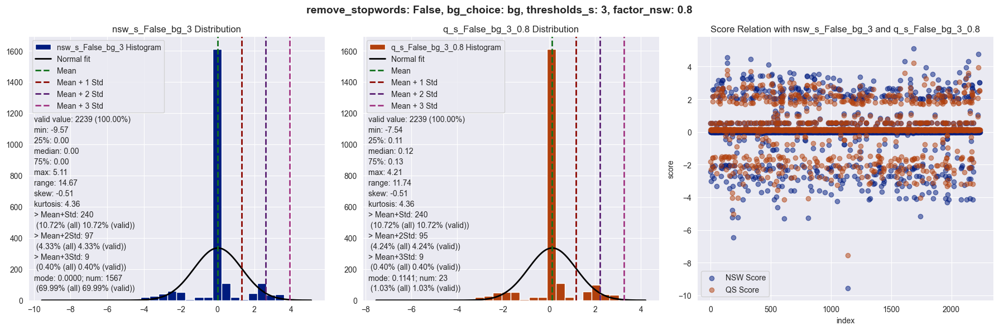

top 10 nsw_s_False_bg_3:

Top 1: 5.1059, text: ['#booknow', '#cuttingedgemechanics', '#winterservicing', 'book', 'dont', 'full', 'please', 'servicing', 'spring', 'swing', 'wait']

Top 2: 4.7760, text: ['#Retail', '71559', 'barista', 'high', 'hiring', 'holborn', 'job', 'latest', 'opening', 'read', 'store']

Top 3: 4.5643, text: ['action', 'arising', 'away', 'blueprint', 'built', 'cant', 'conscience', 'defecating', 'deliberate', 'drinking', 'eating', 'running', 'threat', 'unconscious', 'walking', 'wiped']

Top 4: 4.4672, text: ['#handmade', '#hats', '#shopindie', 'custom', 'far', 'good', 'hat', 'long', 'looking', 'pretty', 'today', 'version', 'way', 'yet']

Top 5: 4.3319, text: ['addict', 'air', 'alcoholic', 'behaviour', 'believe', 'cant', 'disgraceful', 'drinking', 'drug', 'well']

Top 6: 4.3319, text: ['#FoxNews', 'day', 'drinking', 'hotels', 'migrants', 'new', 'sex', 'stairs', 'taxpayerfunded', 'whistleblower', 'york']

Top 7: 4.2171, text: ['along', 'created', 'cycling', 'fakenham', 

,_id,text,score,nsw_s_True_bg_1,q_s_True_bg_1_0.2,q_s_True_bg_1_0.5,q_s_True_bg_1_0.8,nsw_s_True_bg_2,q_s_True_bg_2_0.2,q_s_True_bg_2_0.5,...,q_s_False_bg_1_0.5,q_s_False_bg_1_0.8,nsw_s_False_bg_2,q_s_False_bg_2_0.2,q_s_False_bg_2_0.5,q_s_False_bg_2_0.8,nsw_s_False_bg_3,q_s_False_bg_3_0.2,q_s_False_bg_3_0.5,q_s_False_bg_3_0.8
0,1613006911946776576,"[confidence, dont, fix, lost, need, negative, ...",0.636730,-1.104817,0.288421,-0.234044,-0.756508,0.000000,0.509384,0.318365,...,0.318365,0.127346,0.000000,0.509384,0.318365,0.127346,0.000000,0.509384,0.318365,0.127346
1,1613006916246179840,"[academic, age, approaching, best, biogerontol...",0.614933,-1.728892,0.146168,-0.556979,-1.260127,-2.835349,-0.075123,-1.110208,...,-0.916606,-1.835530,-2.448146,0.002317,-0.916606,-1.835530,-2.448146,0.002317,-0.916606,-1.835530
2,1613006917810683904,"[album, dreams, london, underrated]",0.541453,0.172395,0.467641,0.356924,0.246207,0.031163,0.439395,0.286308,...,0.316738,0.181910,0.092024,0.451567,0.316738,0.181910,0.545139,0.542190,0.543296,0.544401
3,1613006921556185089,"[apartment, leaky, month, new, paying, pipes, ...",0.636528,0.000000,0.509222,0.318264,0.127306,0.000000,0.509222,0.318264,...,0.318264,0.127306,0.000000,0.509222,0.318264,0.127306,0.000000,0.509222,0.318264,0.127306
4,1613006922894000128,"[carabao, confirmed, congestion, cup, dates, f...",0.589902,-0.034054,0.465111,0.277924,0.090737,-0.034054,0.465111,0.277924,...,0.311439,0.144362,0.032976,0.478517,0.311439,0.144362,0.032976,0.478517,0.311439,0.144362
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2234,1615746986057007113,"[@Sunita_Says_, provoking, thought]",0.665500,0.000000,0.532400,0.332750,0.133100,0.000000,0.532400,0.332750,...,0.332750,0.133100,0.000000,0.532400,0.332750,0.133100,0.000000,0.532400,0.332750,0.133100
2235,1615746987940511744,"[@GMB, @Lilly26062173, @edballs, beds, care, d...",0.586667,1.193662,0.708066,0.890165,1.072263,1.679682,0.805270,1.133174,...,1.109897,1.423836,3.007103,1.070754,1.796885,2.523016,3.007103,1.070754,1.796885,2.523016
2236,1615746988481314818,"[2nd, @leahwillFP6, allowed, arsenal, beth, cl...",0.674884,1.181516,0.776210,0.928200,1.080189,1.452004,0.830308,1.063444,...,0.825843,0.916418,1.146755,0.769258,0.910819,1.052381,3.007103,1.141328,1.840993,2.540659
2237,1615746990251593729,"[eat, say, wanna, wear]",0.629744,-2.208712,0.062052,-0.789484,-1.641021,-2.208712,0.062052,-0.789484,...,-0.615302,-1.362330,-1.860348,0.131725,-0.615302,-1.362330,0.000000,0.503795,0.314872,0.125949


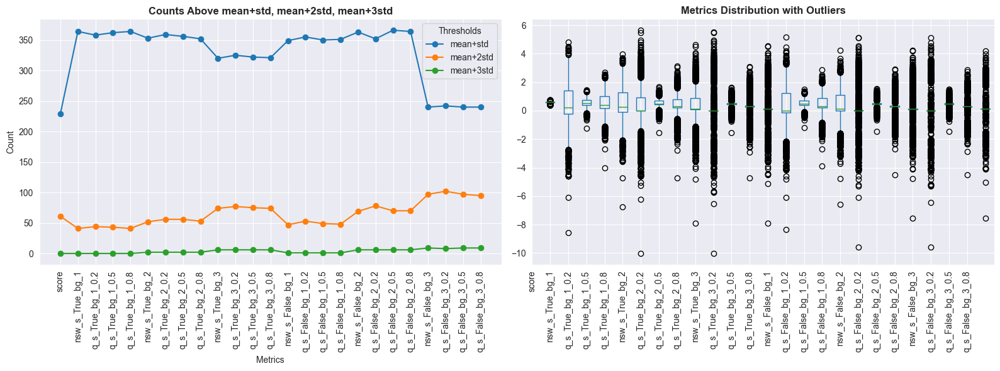

In [34]:
CURRENT_OUTPUT = 'pictureOutput/task2'
statistic2()

## Task 3

In [35]:
def grid_points_to_dataframe(gridPoints):
    """
    Convert a list of GridPoint instances to DataFrame
    
    :param gridPoints: List of GridPoint instances
    :return: Data in DataFrame format
    """
    print_level('-------- Start GridPointsToDataFrame --------', 1)

    # Create an empty list to store data for each GridPoint
    data_list = []

    # Traverse the list of GridPoint instances and extract the required data
    for gp in gridPoints:
        # Extract required information from gp.tweet
        data_dict = {
            'row': gp.row,
            'column': gp.column,
            'id': gp.id,
            'text': gp.text,
            'token_text_remove_stopwords': gp.token_text_remove_stopwords,
            'token_text_keep_stopwords': gp.token_text_keep_stopwords,
            'score': gp.score,
        }
        data_list.append(data_dict)

    # Create DataFrame using the extracted data list
    dfGridPointsSorted = pd.DataFrame(data_list)

    # Display the first few rows of the DataFrame to check the data
    print_level(dfGridPointsSorted.head(), 1)

    return dfGridPointsSorted


In [36]:
def draw_heatmap_histogram(df, column_name, s, condition=None):
    """
    Draw a heatmap and histogram as subplots, only counting rows and columns that meet specific conditions.
    :param df: DataFrame containing multiple columns of data.
    :param column_name: Name of the column to check the condition.
    :param s: Suffix used to save the file
    :param condition: Condition function used for filtering.
    """
    if condition is not None:
        filtered_df = df[condition]
    else:
        filtered_df = df

    # Get the number of rows and columns in the grid
    num_rows = g_grids.num_rows
    num_columns = g_grids.num_columns

    # Create a count matrix
    count_matrix = np.zeros((num_rows, num_columns))

    # Update the count matrix
    for index, row in filtered_df.iterrows():
        # Ensure grid indices are within range
        if 0 <= row['row'] < num_rows and 0 <= row['column'] < num_columns:
            count_matrix[row['row'], row['column']] += 1

    # Set subplot layout
    fig, axs = plt.subplots(1, 2, figsize=(20, 8))

    # Draw heatmap
    sns.heatmap(count_matrix, cmap='RdBu_r', norm=matplotlib.colors.LogNorm(), ax=axs[0])
    heatmap_title = f'Heatmap of tweet counts - London {column_name}'
    axs[0].set_title(heatmap_title)

    # Prepare histogram data
    count_matrix_flattened = count_matrix.flatten()

    # Draw histogram
    sns.histplot(count_matrix_flattened, bins=50, kde=False, ax=axs[1])
    histogram_title = f'Distribution of number - London{column_name}'
    axs[1].set_title(histogram_title)
    axs[1].set_xlabel('Number of tweets')
    axs[1].set_ylabel('Number of grids')
    axs[1].set_yscale('log')

    # Adjust layout
    plt.tight_layout()

    # Save and display the image
    file_name = f'heatmap_histogram_{column_name}_{s}.png'
    plt.savefig(os.path.join(f'{CURRENT_OUTPUT}', file_name))
    plt.show()


In [37]:
def statistic3():
    """
    Calculate the newsworthiness score and total quality score for task3, and draw the corresponding histogram and box-and-line plot
    """
    # task 3 data processing
    df_geo = grid_points_to_dataframe(g_grid_points)
    print_level(f'len: {len(df_geo)}', 0)
    condition_remove_stopwords = [True, False]

    condition_bg_choice = ['geo', 'bg+geo']
    condition_thresholds_s = [1, 2]
    condition_factor_nsw = [0.5, 0.8]

    # 用于显示进度
    times = len(condition_remove_stopwords) * len(condition_bg_choice) * len(condition_thresholds_s) * len(
        condition_factor_nsw)

    time = 1
    for remove_stopwords in condition_remove_stopwords:
        for bg_choice in condition_bg_choice:
            for thresholds_s in condition_thresholds_s:
                for factor_nsw in condition_factor_nsw:
                    print_level(
                        f'---- {time} / {times} ---- remove_stopwords: {remove_stopwords}, bg_choice: {bg_choice}, thresholds_s: {thresholds_s}, factor_nsw: {factor_nsw}--------',
                        0)
                    newsworthiness_scoring(df_geo, True, remove_stopwords, bg_choice, thresholds_s, factor_nsw)
                    time = time + 1

    display(df_geo)
    draw_total_statistic(df_geo, True)
    df_geo.to_csv('TempData/df_geo.csv')


In [38]:
grid_points_to_dataframe(g_grid_points)

,row,column,id,text,token_text_remove_stopwords,token_text_keep_stopwords,score
0,28,31,1565429028747616256,"Just posted a photo @ London, United Kingdom h...","[kingdom, london, photo, posted, united]","[just, kingdom, london, photo, posted, united]",0.554386
1,28,31,1565428982660603907,"Just posted a photo @ London, United Kingdom h...","[kingdom, london, photo, posted, united]","[just, kingdom, london, photo, posted, united]",0.590283
2,28,27,1565428290017443846,Just posted a photo @ Eliza Jane Howell https:...,"[eliza, howell, jane, photo, posted]","[eliza, howell, jane, just, photo, posted]",0.591719
3,23,33,1565427593851158528,"Just posted a photo @ London, Unιted Kingdom h...","[kingdom, london, photo, posted, ted, un]","[just, kingdom, london, photo, posted, ted, un]",0.592131
4,28,31,1565425981246115842,A fun day murdering in London Town for the fir...,"[#OrganiseEvents, @themarcusmassey, ages, day,...","[#OrganiseEvents, @themarcusmassey, ages, day,...",0.664139
...,...,...,...,...,...,...,...
13187,28,29,1575580078368378881,"Just posted a photo @ The Langham, London http...","[langham, london, photo, posted]","[just, langham, london, photo, posted, the]",0.588676
13188,27,29,1575579146775777280,"I'm at Viet Food in London, Greater London htt...","[food, greater, im, london, viet]","[at, food, greater, im, in, london, viet]",0.569792
13189,28,31,1575578499121041408,"Just posted a photo @ London, United Kingdom h...","[kingdom, london, photo, posted, united]","[just, kingdom, london, photo, posted, united]",0.592224
13190,30,31,1575577168826232832,Drinking a Studio Lager by @SignatureBrew at @...,"[@SignatureBrew, @thelexington, drinking, lage...","[@SignatureBrew, @thelexington, at, by, drinki...",0.607921


len: 13192
---- 1 / 16 ---- remove_stopwords: True, bg_choice: geo, thresholds_s: 1, factor_nsw: 0.5--------


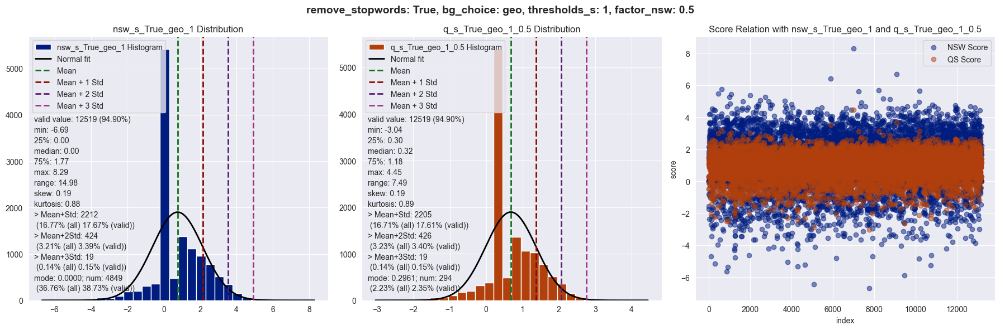

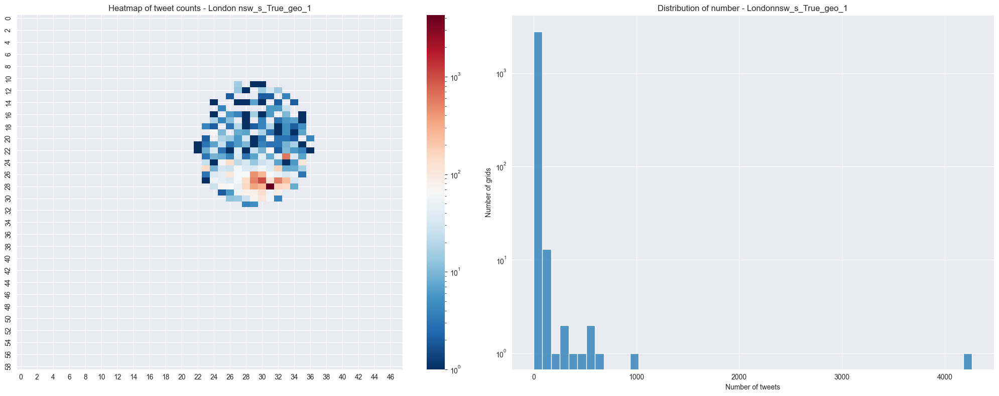

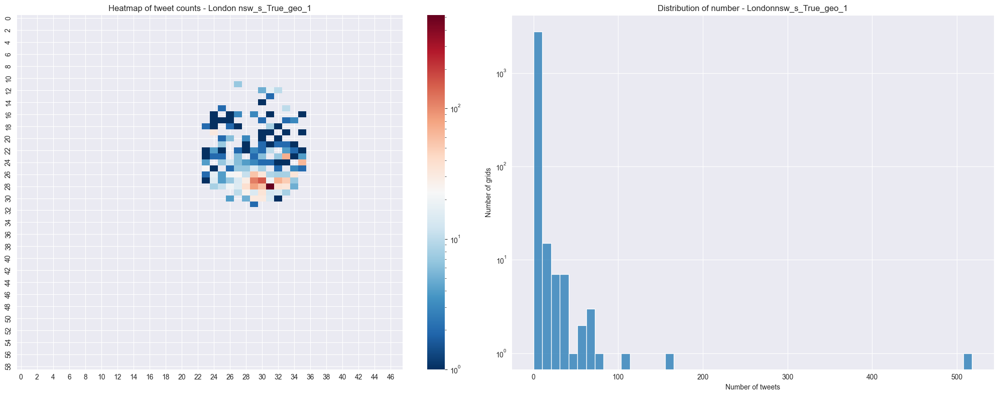

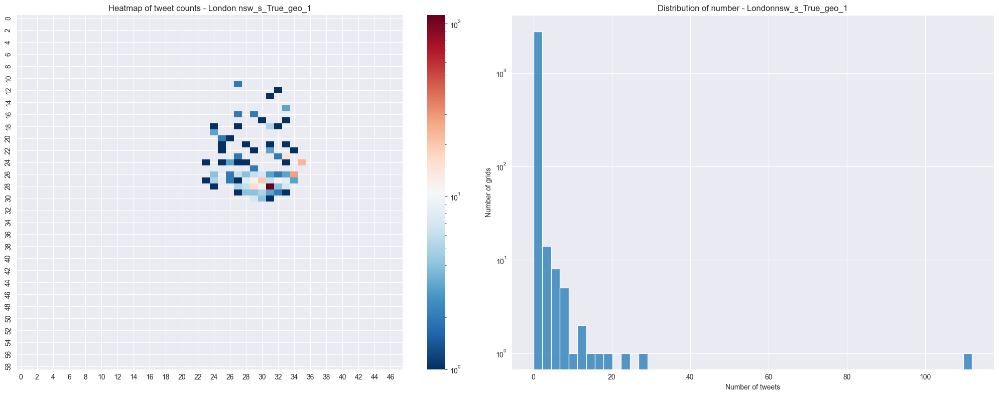

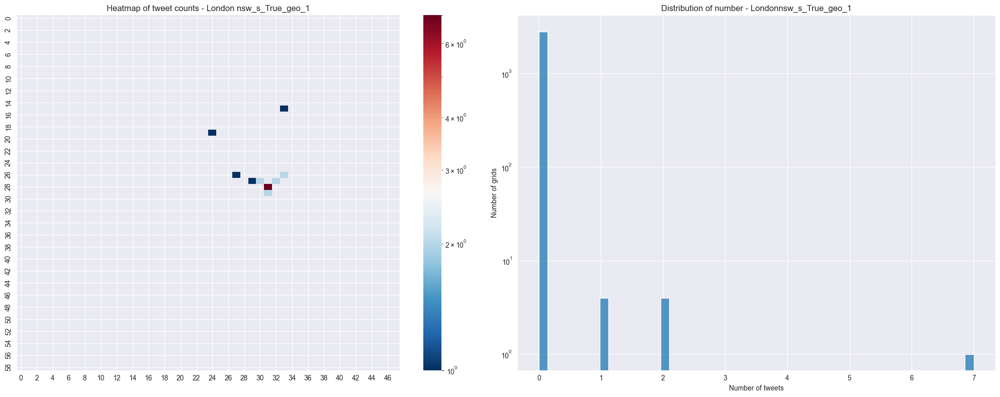

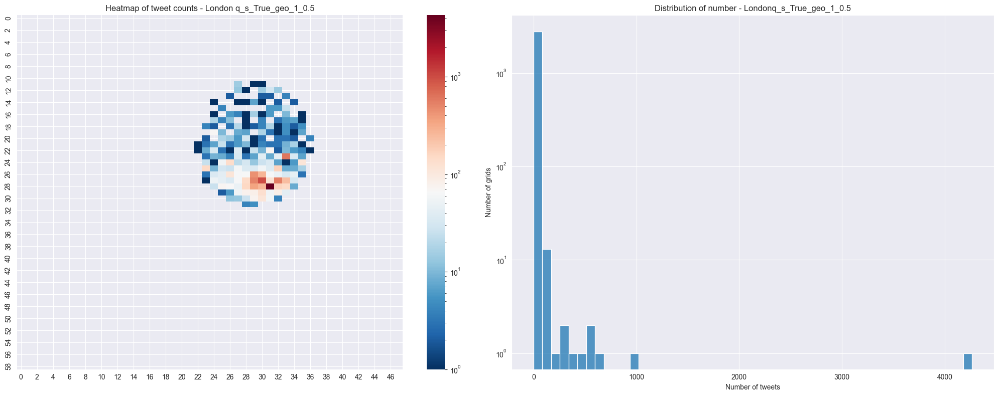

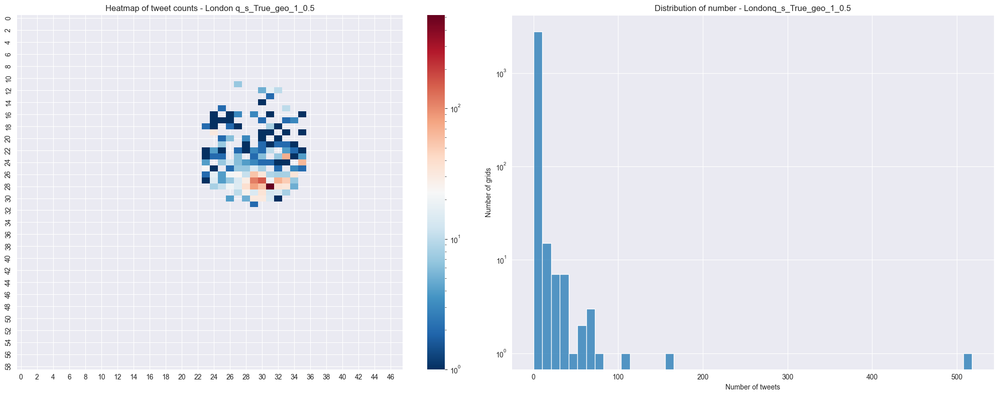

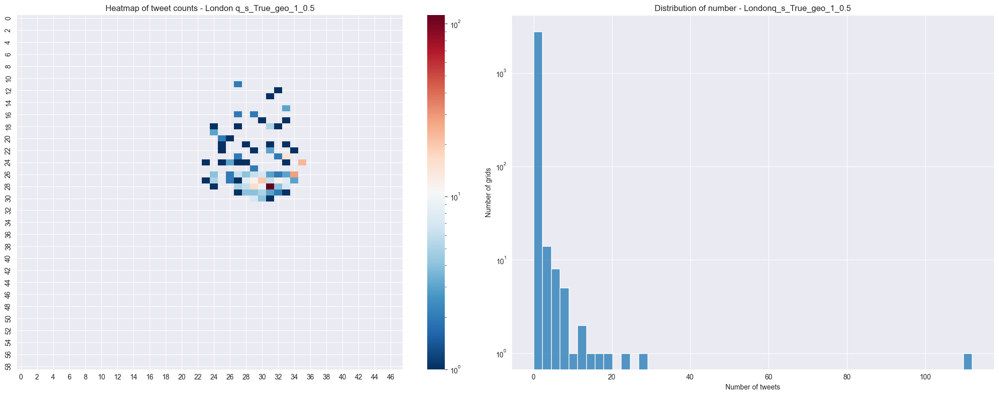

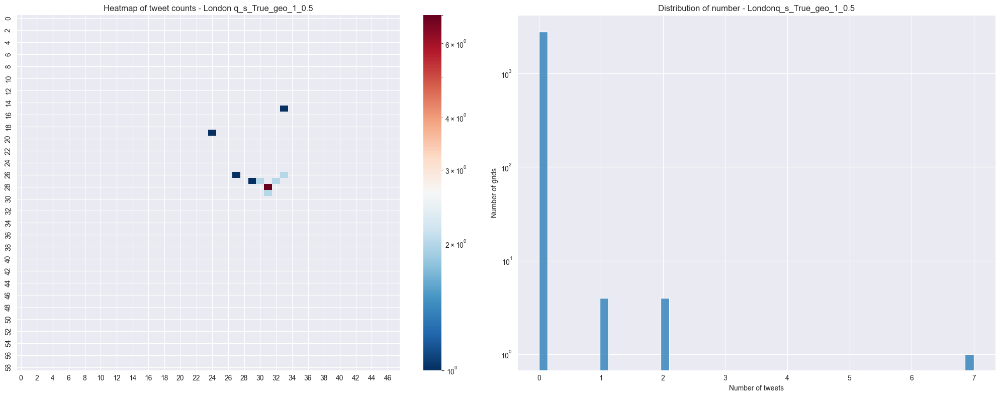

top 10 nsw_s_True_geo_1:

Top 1: 8.2895, text: Last few bags from my fundraiser up for grabs from my Etsy shop( link in bio) .
Next fundraiser up in March. 
Profit go to @greekanimalrescue. @ London, United Kingdom https://t.co/795edS0i1f

Top 2: 6.6749, text: The Shard 
#london #uk spring #cloudy #clouds #architecture #steel #glass #skyline #cityscape @ London, United Kingdom https://t.co/MFml7mVoYz

Top 3: 6.4045, text: #MartinFreeman
Always super cute!  
What a sweetie seriously 
Somewhere in London in 2009

#TheHobbit #BilboBaggins #Sherlock #JohnWatson @ London, United Kingdom https://t.co/dZo1oG0Tqs

Top 4: 5.7463, text: LIFE IN BLOOM | Forever Mood. Gucci Bloom Profumo Di Fiori, Personified By Florals, Born To Bloom️FR
-
#gucci #bloom #forher @ The Shard London https://t.co/ytDBxVZMPF

Top 5: 5.6747, text: Had a lovely day2day starting with celebrating my birthday from 2020(!!) with some of my fav peeps ️ #harrods #TiffanyBlueBoxCafe (@ The Tiffany Blue Box Cafe in London, Great

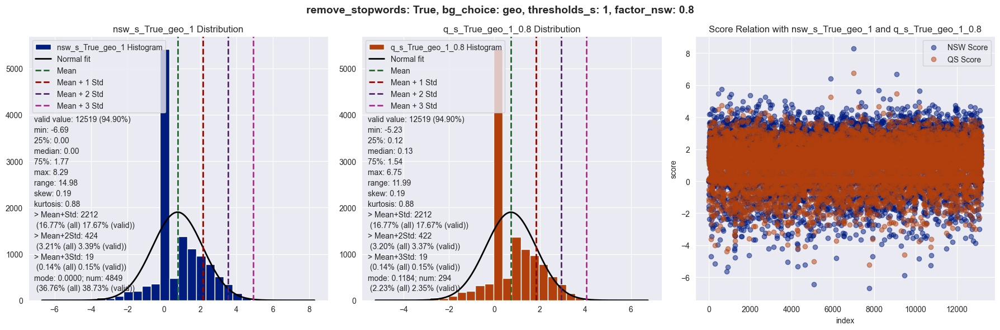

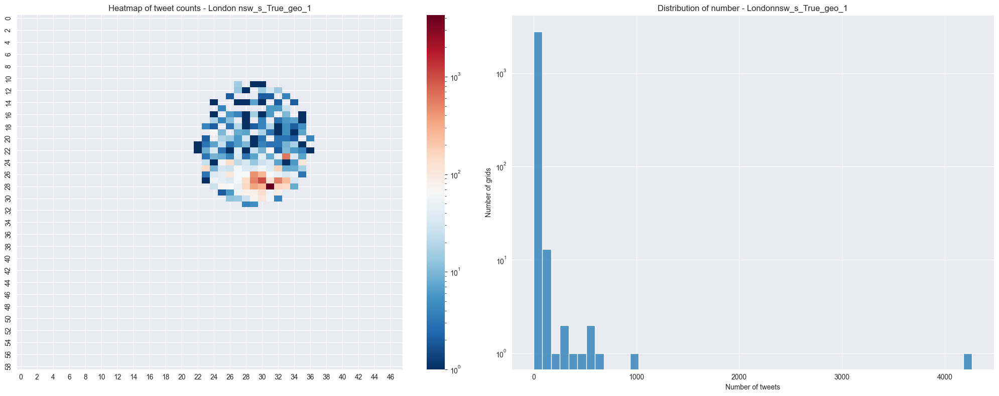

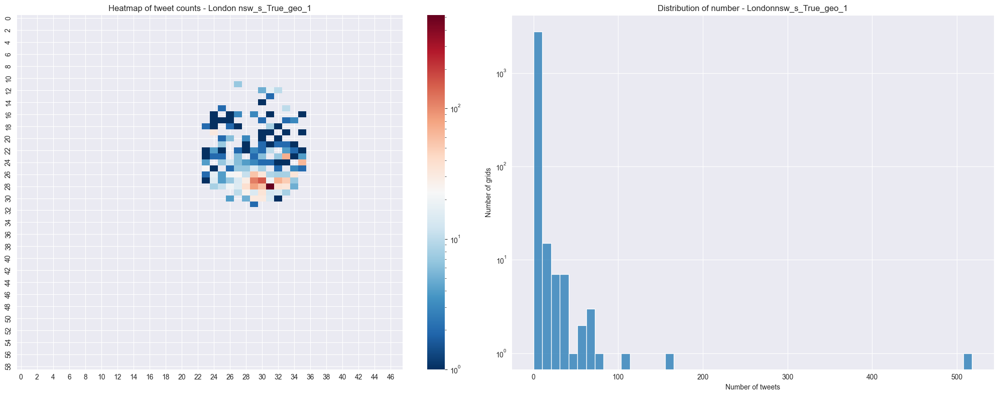

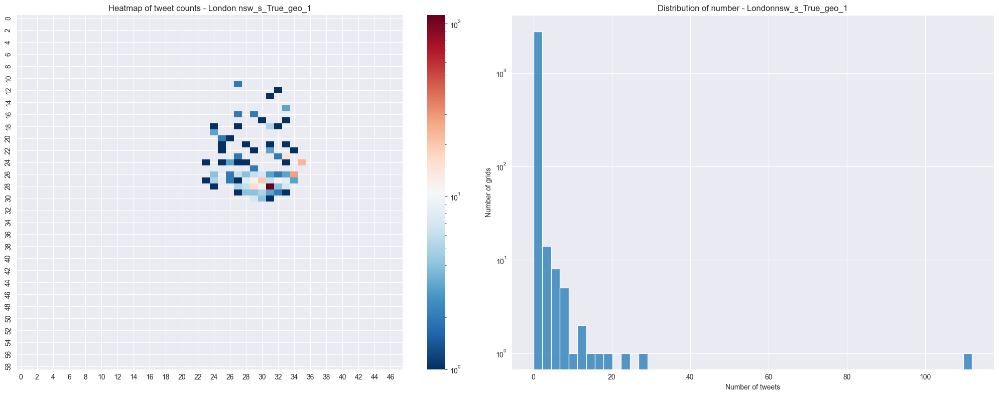

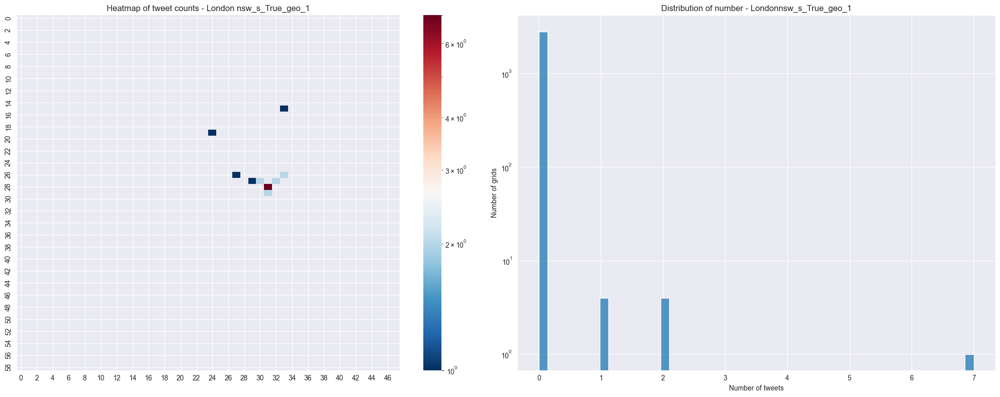

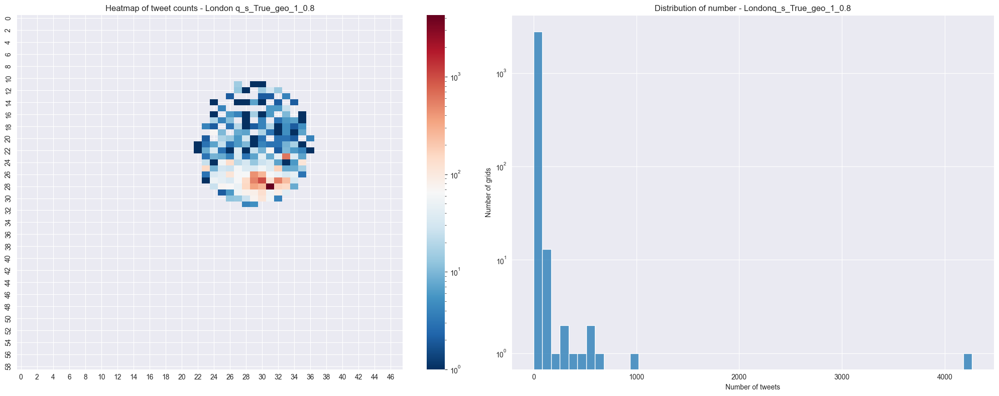

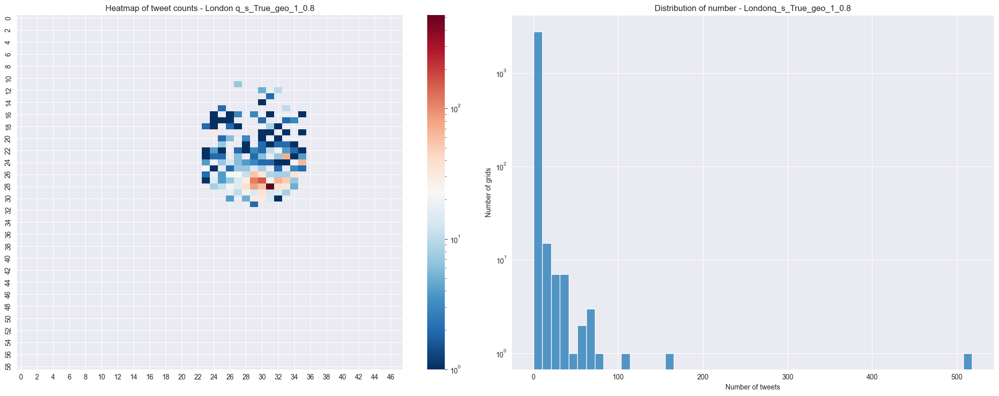

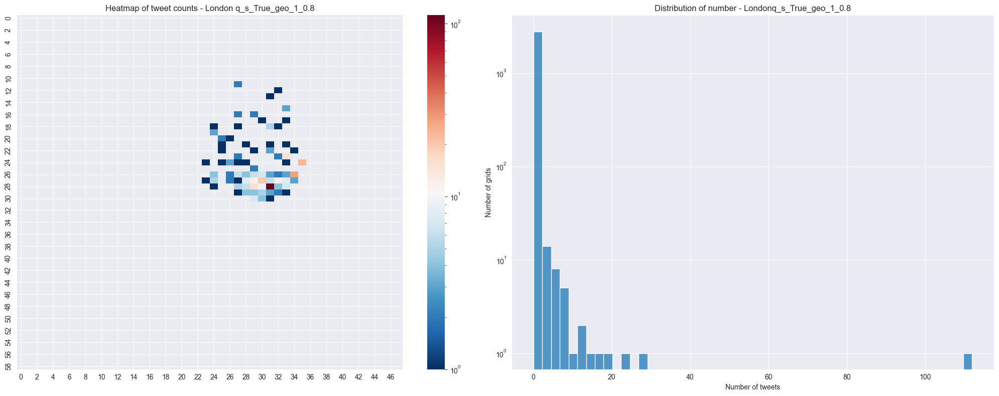

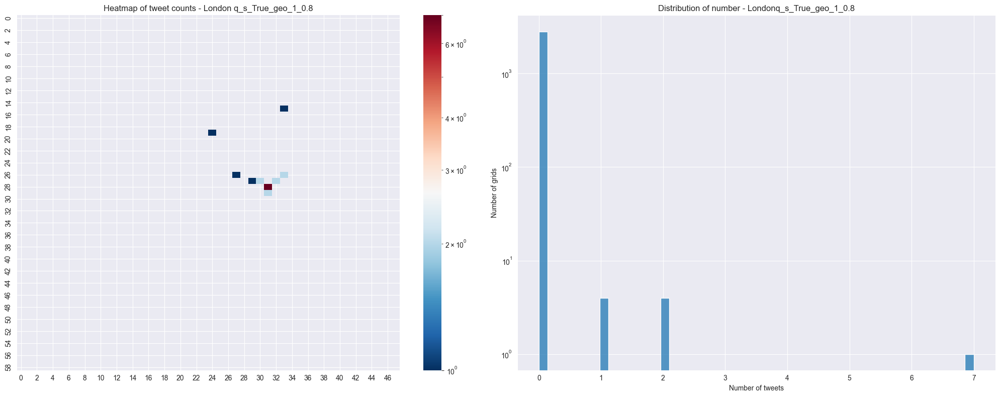

top 10 nsw_s_True_geo_1:

Top 1: 8.2895, text: Last few bags from my fundraiser up for grabs from my Etsy shop( link in bio) .
Next fundraiser up in March. 
Profit go to @greekanimalrescue. @ London, United Kingdom https://t.co/795edS0i1f

Top 2: 6.6749, text: The Shard 
#london #uk spring #cloudy #clouds #architecture #steel #glass #skyline #cityscape @ London, United Kingdom https://t.co/MFml7mVoYz

Top 3: 6.4045, text: #MartinFreeman
Always super cute!  
What a sweetie seriously 
Somewhere in London in 2009

#TheHobbit #BilboBaggins #Sherlock #JohnWatson @ London, United Kingdom https://t.co/dZo1oG0Tqs

Top 4: 5.7463, text: LIFE IN BLOOM | Forever Mood. Gucci Bloom Profumo Di Fiori, Personified By Florals, Born To Bloom️FR
-
#gucci #bloom #forher @ The Shard London https://t.co/ytDBxVZMPF

Top 5: 5.6747, text: Had a lovely day2day starting with celebrating my birthday from 2020(!!) with some of my fav peeps ️ #harrods #TiffanyBlueBoxCafe (@ The Tiffany Blue Box Cafe in London, Great

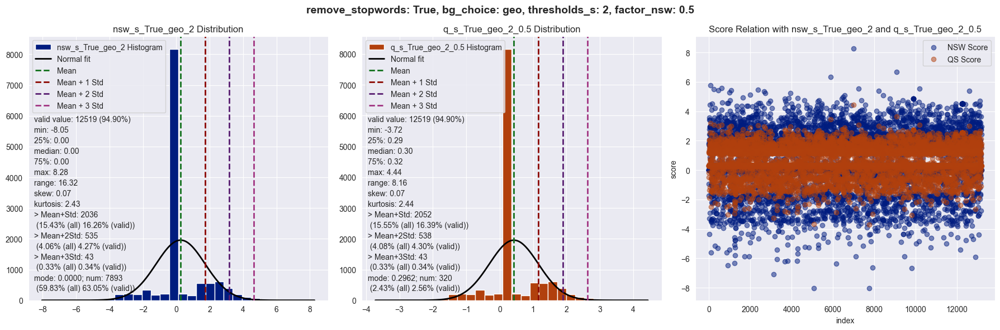

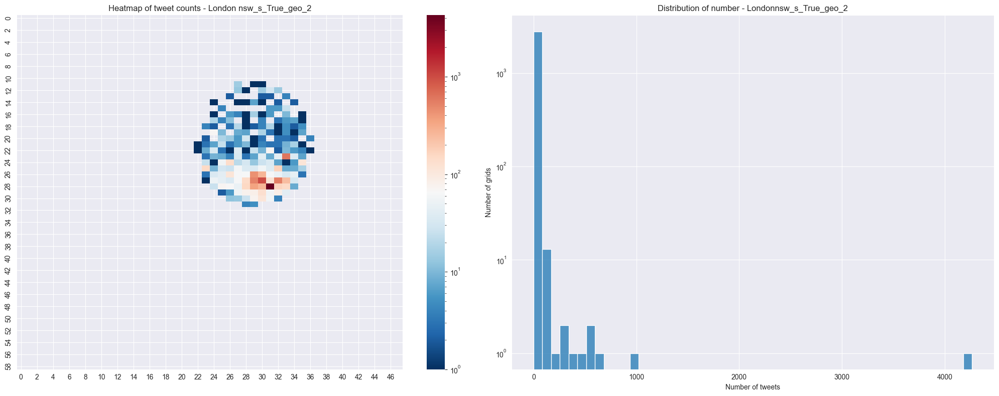

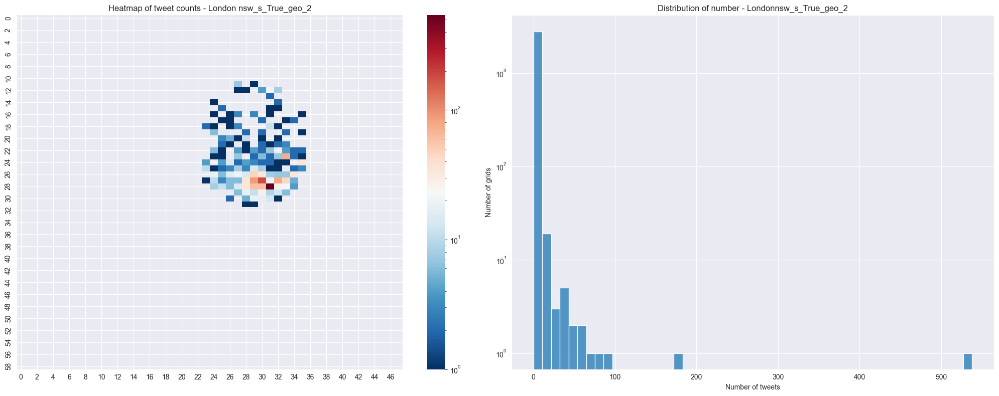

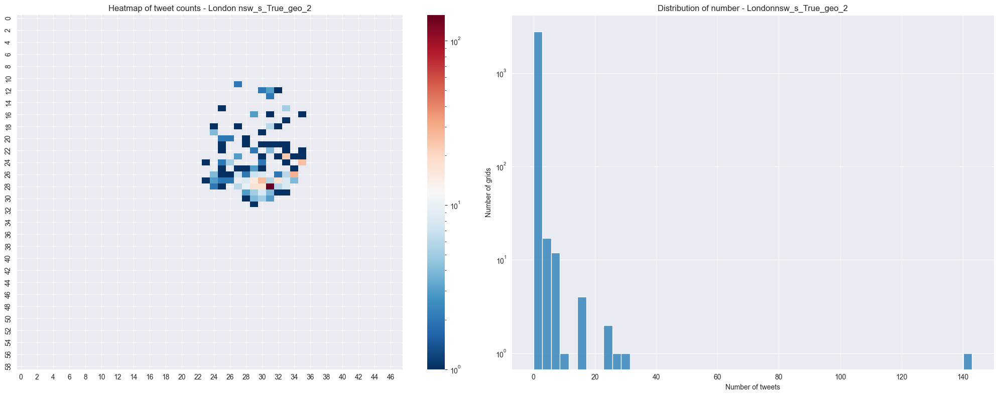

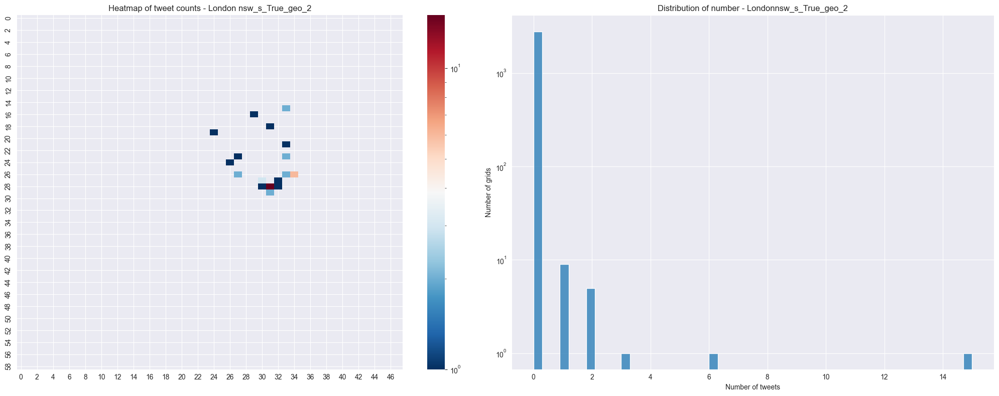

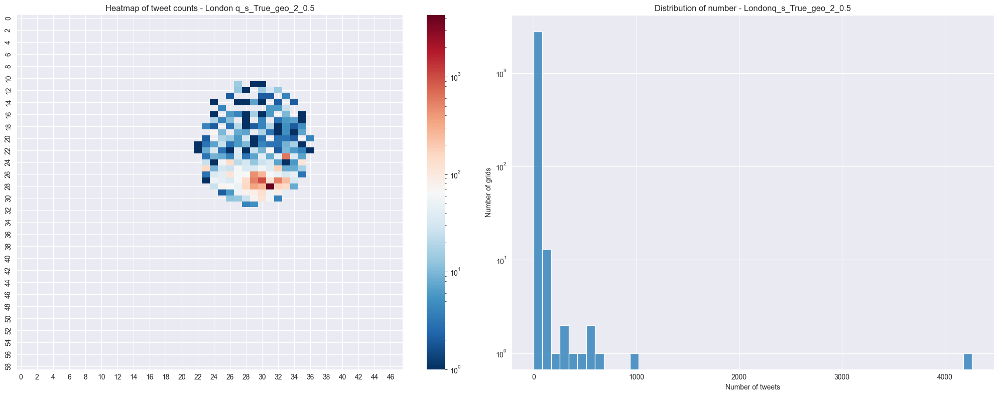

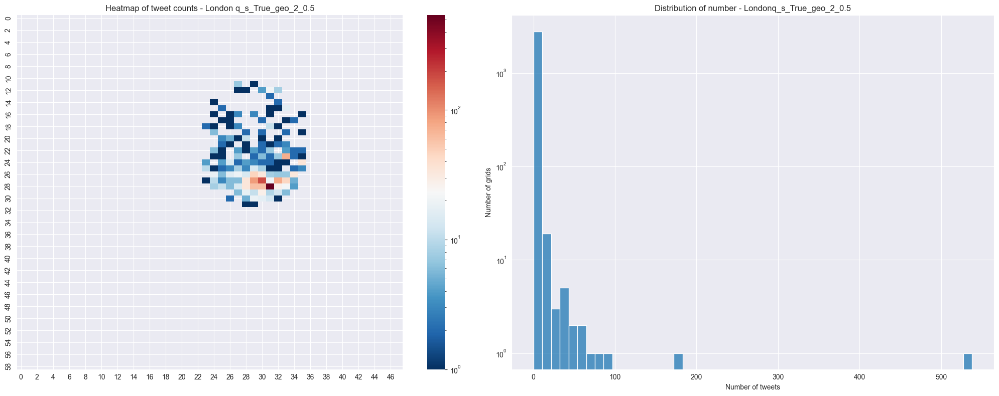

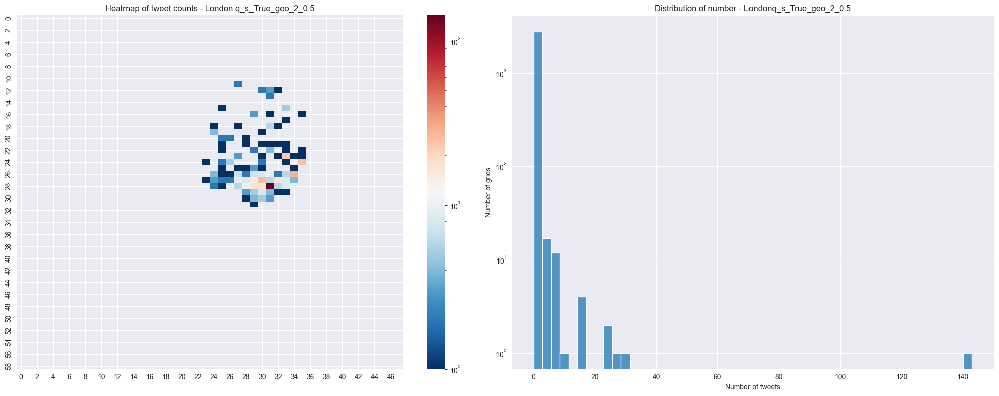

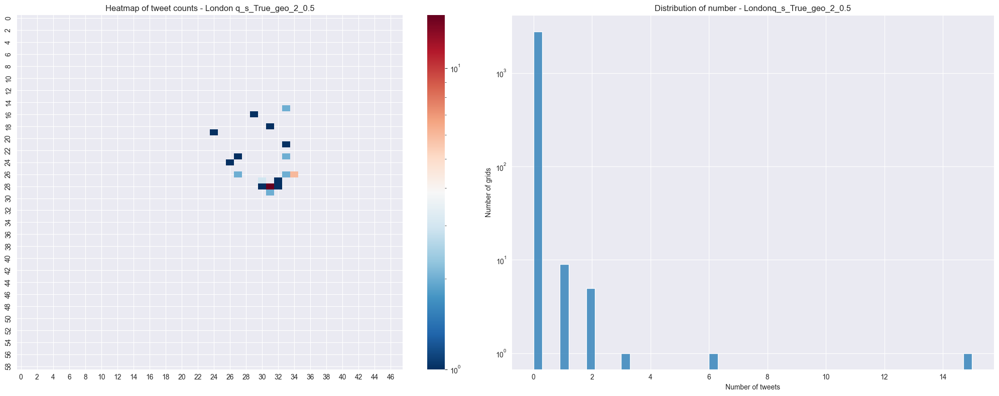

top 10 nsw_s_True_geo_2:

Top 1: 8.2753, text: Last few bags from my fundraiser up for grabs from my Etsy shop( link in bio) .
Next fundraiser up in March. 
Profit go to @greekanimalrescue. @ London, United Kingdom https://t.co/795edS0i1f

Top 2: 6.6605, text: The Shard 
#london #uk spring #cloudy #clouds #architecture #steel #glass #skyline #cityscape @ London, United Kingdom https://t.co/MFml7mVoYz

Top 3: 6.3277, text: #MartinFreeman
Always super cute!  
What a sweetie seriously 
Somewhere in London in 2009

#TheHobbit #BilboBaggins #Sherlock #JohnWatson @ London, United Kingdom https://t.co/dZo1oG0Tqs

Top 4: 5.7741, text: Schoony set of 4 Sculptures Signed Matching Numbers from an edition of 50 - Boy Soldier - Bruiser - Shield - W.T.W.T.A All in original boxes to be built &amp; painted as you wish. Ukraine colours supplied https://t.co/KzBt1sv16b

Top 5: 5.5684, text: LIFE IN BLOOM | Forever Mood. Gucci Bloom Profumo Di Fiori, Personified By Florals, Born To Bloom️FR
-
#gucci #blo

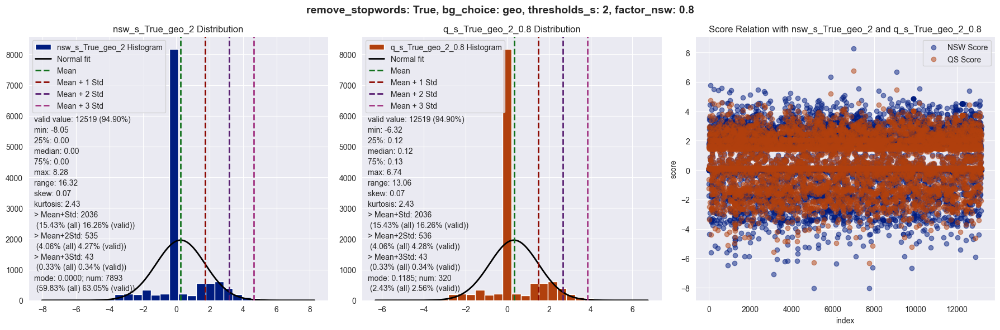

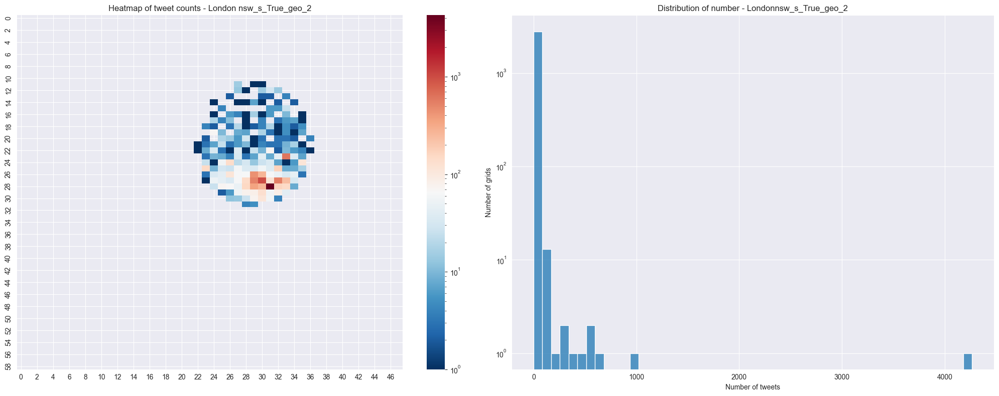

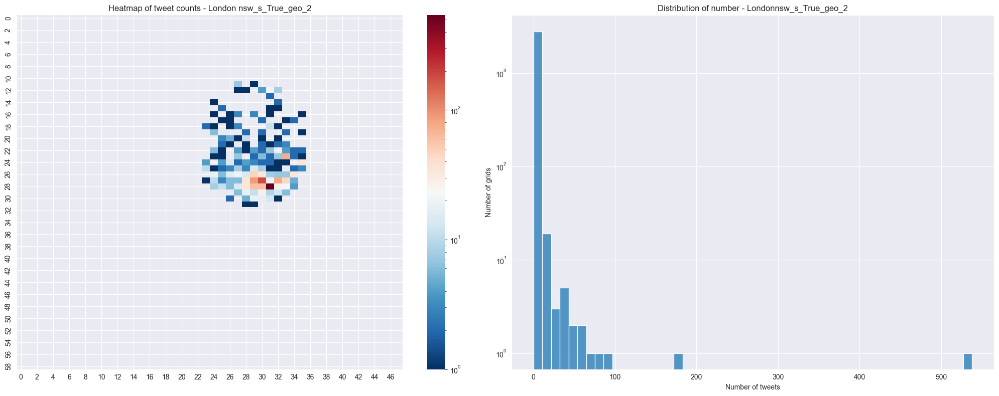

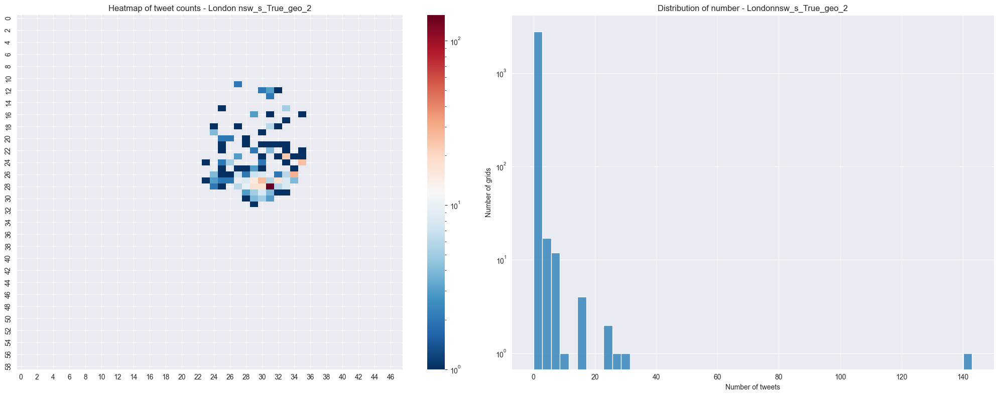

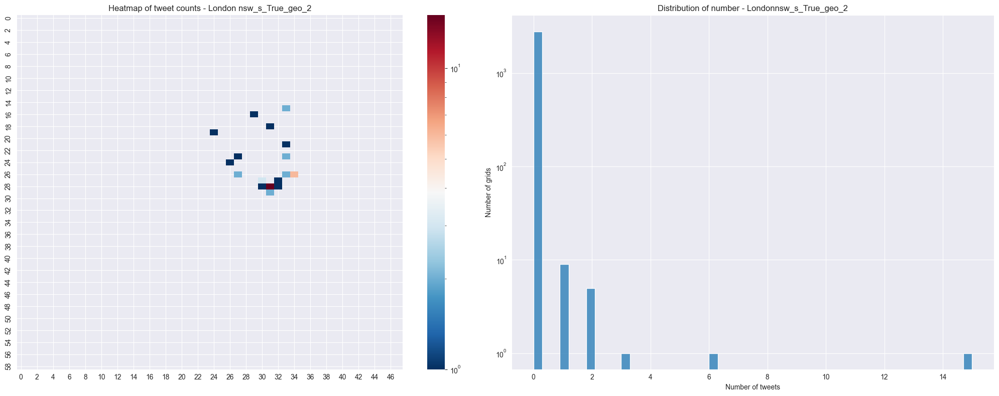

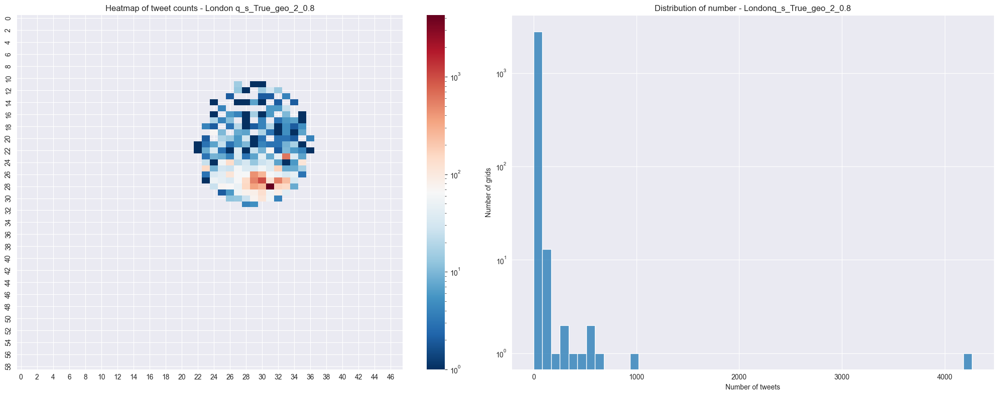

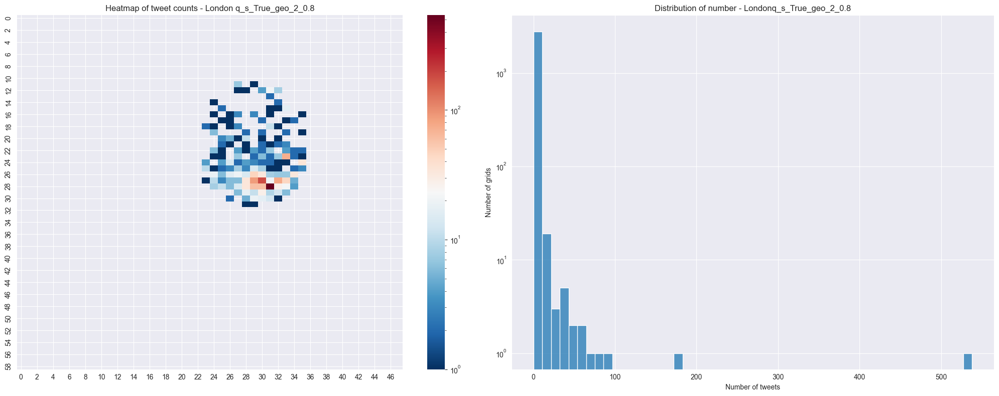

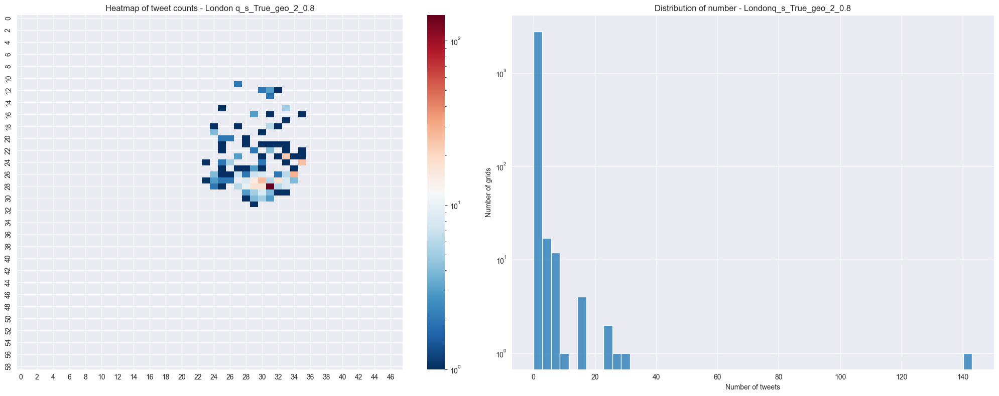

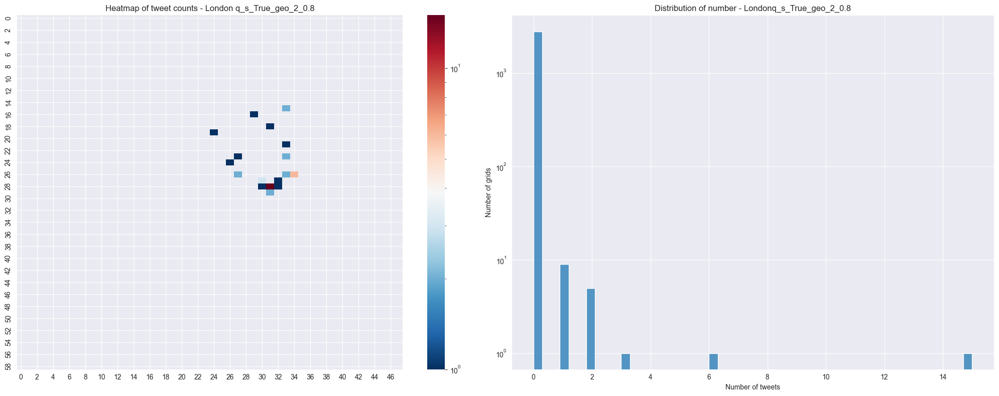

top 10 nsw_s_True_geo_2:

Top 1: 8.2753, text: Last few bags from my fundraiser up for grabs from my Etsy shop( link in bio) .
Next fundraiser up in March. 
Profit go to @greekanimalrescue. @ London, United Kingdom https://t.co/795edS0i1f

Top 2: 6.6605, text: The Shard 
#london #uk spring #cloudy #clouds #architecture #steel #glass #skyline #cityscape @ London, United Kingdom https://t.co/MFml7mVoYz

Top 3: 6.3277, text: #MartinFreeman
Always super cute!  
What a sweetie seriously 
Somewhere in London in 2009

#TheHobbit #BilboBaggins #Sherlock #JohnWatson @ London, United Kingdom https://t.co/dZo1oG0Tqs

Top 4: 5.7741, text: Schoony set of 4 Sculptures Signed Matching Numbers from an edition of 50 - Boy Soldier - Bruiser - Shield - W.T.W.T.A All in original boxes to be built &amp; painted as you wish. Ukraine colours supplied https://t.co/KzBt1sv16b

Top 5: 5.5684, text: LIFE IN BLOOM | Forever Mood. Gucci Bloom Profumo Di Fiori, Personified By Florals, Born To Bloom️FR
-
#gucci #blo

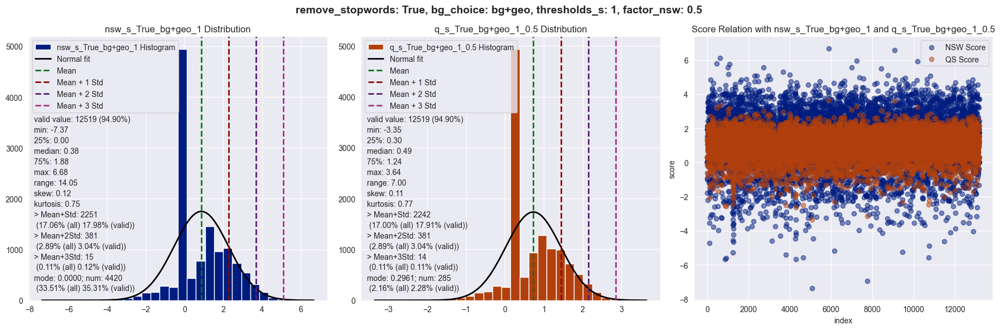

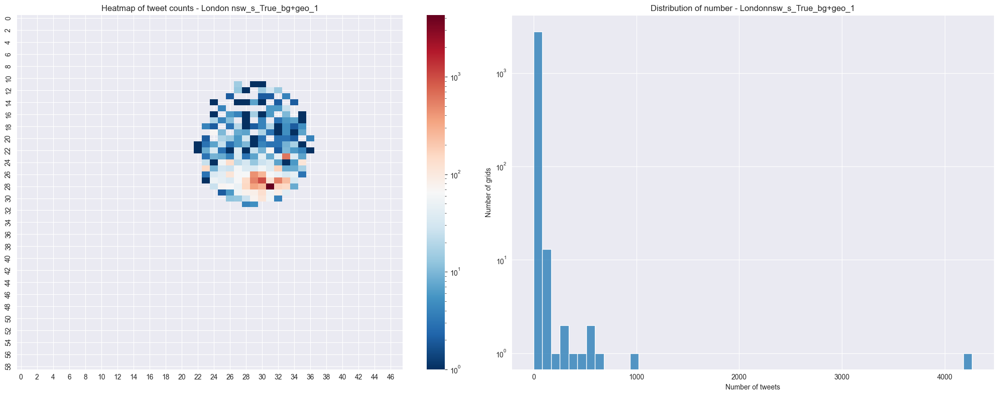

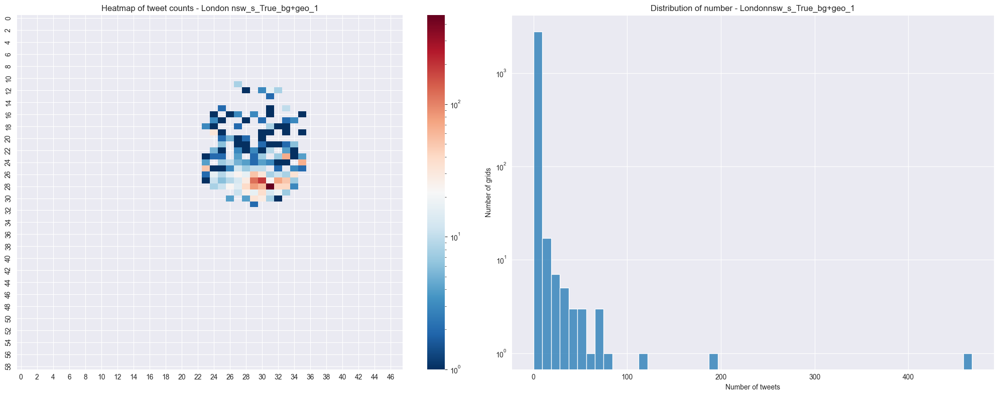

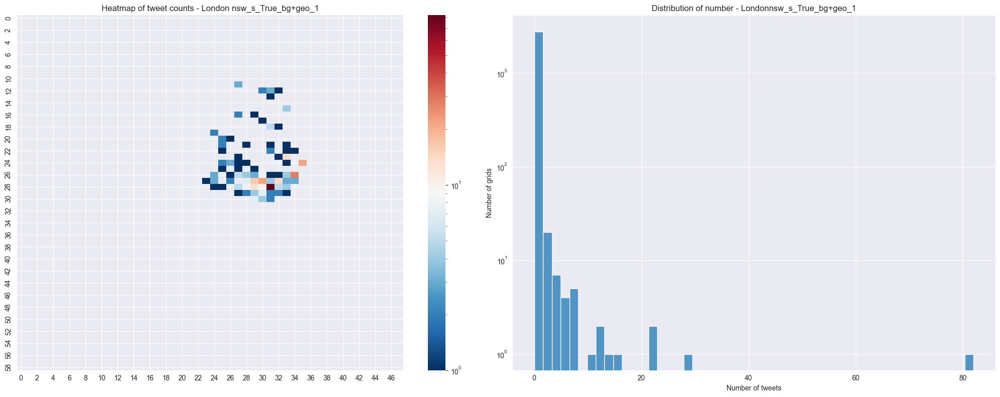

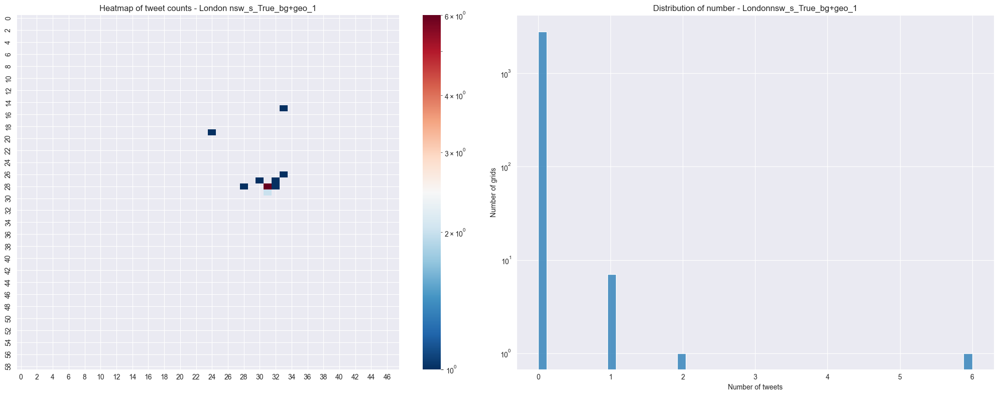

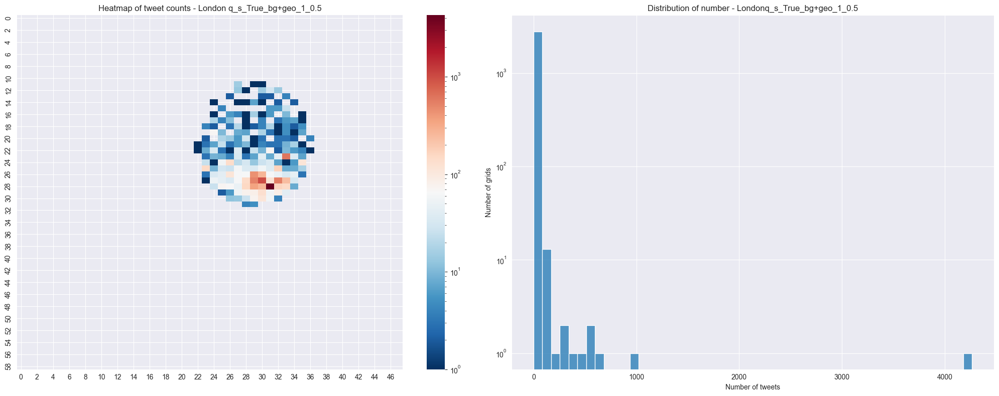

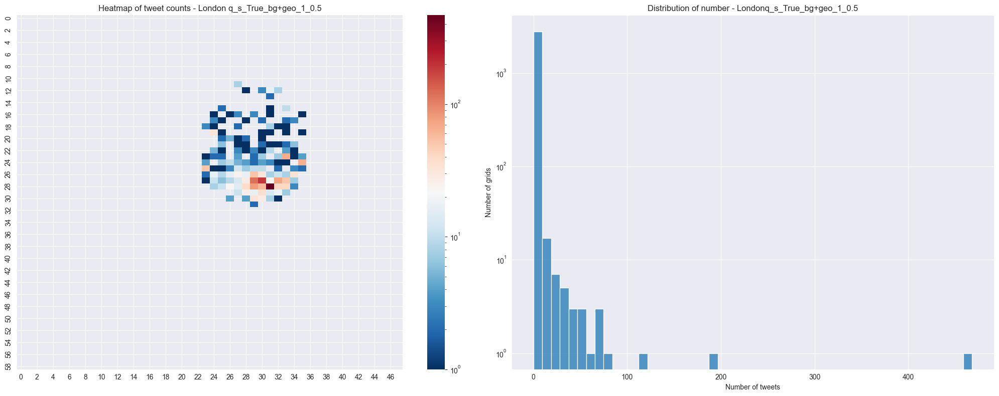

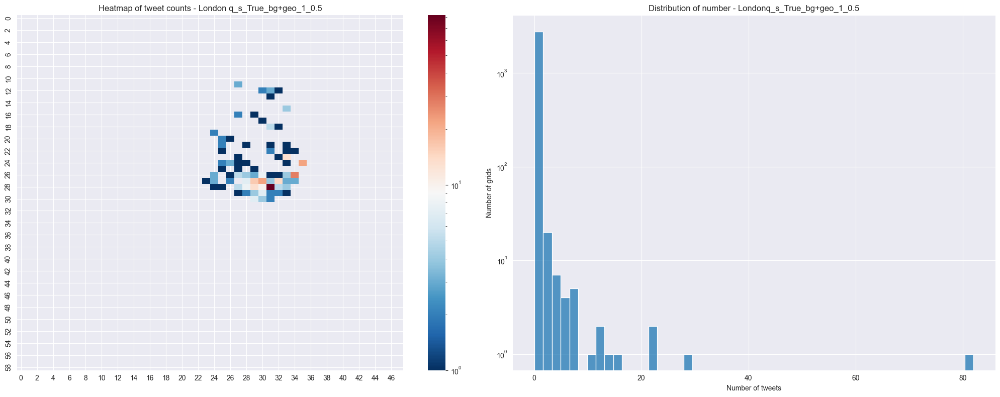

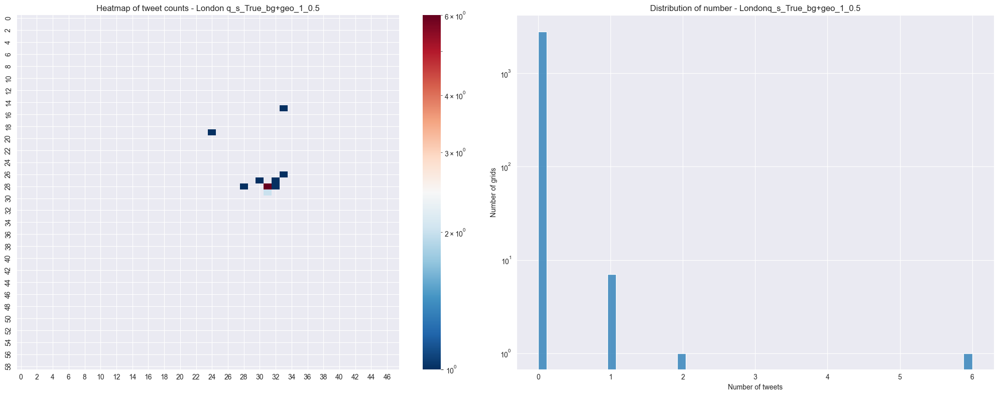

top 10 nsw_s_True_bg+geo_1:

Top 1: 6.6780, text: #MartinFreeman
Always super cute!  
What a sweetie seriously 
Somewhere in London in 2009

#TheHobbit #BilboBaggins #Sherlock #JohnWatson @ London, United Kingdom https://t.co/dZo1oG0Tqs

Top 2: 6.5718, text: The Shard 
#london #uk spring #cloudy #clouds #architecture #steel #glass #skyline #cityscape @ London, United Kingdom https://t.co/MFml7mVoYz

Top 3: 6.1056, text: LIFE IN BLOOM | Forever Mood. Gucci Bloom Profumo Di Fiori, Personified By Florals, Born To Bloom️FR
-
#gucci #bloom #forher @ The Shard London https://t.co/ytDBxVZMPF

Top 4: 5.9467, text: #me #italian #italiangirl #pink #outfit #outfitoftheday #sunny #sunnyday #selfie #london #londonlife #blonde #blondehair #blondegirl #happiness #dayoff #drmartens #glasses #lipstick @ London, United Kingdom https://t.co/EG69Vyu7Ae

Top 5: 5.9109, text: Large Cod Fish and Chips and an Old Jamaica Ginger Beer. (@ Johnny's Fish Bar in Bermondsey) https://t.co/jB7awRBONP

Top 6: 5.7957, 

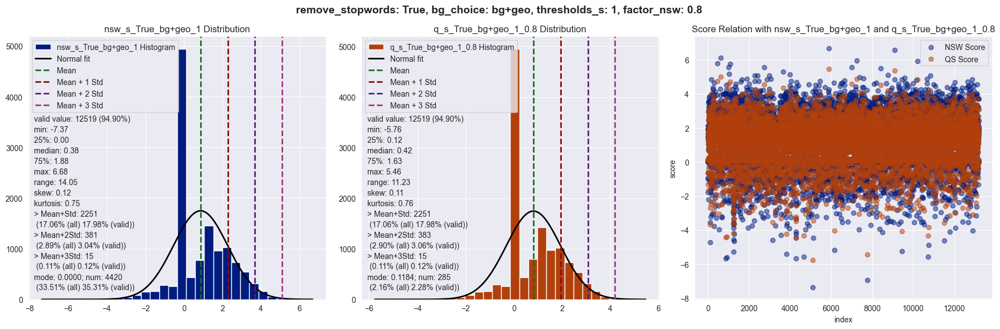

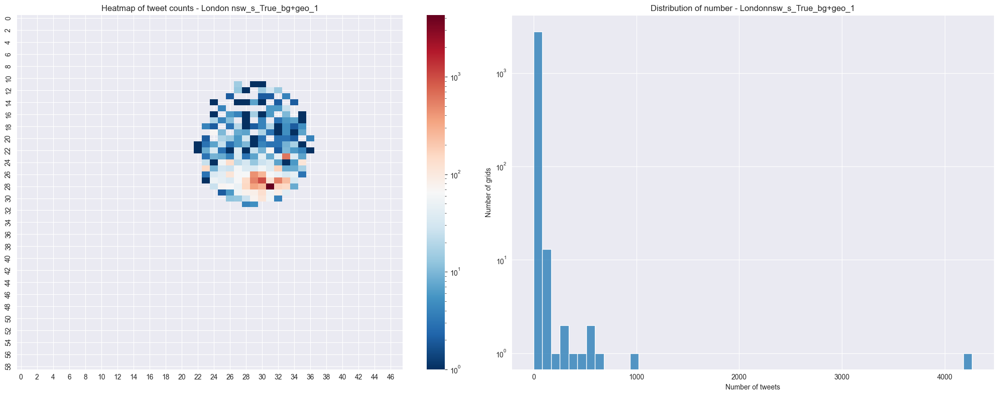

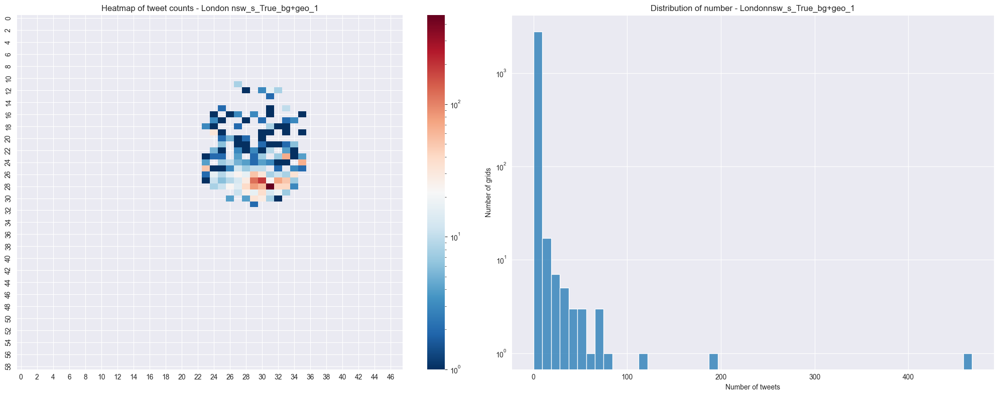

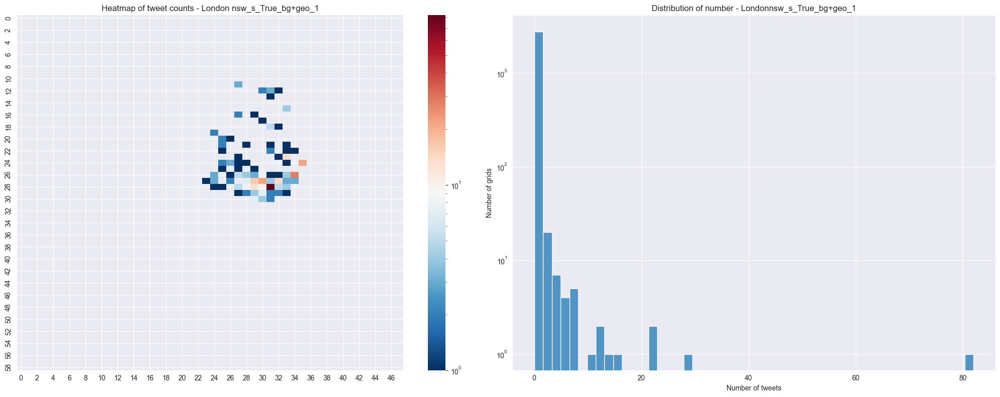

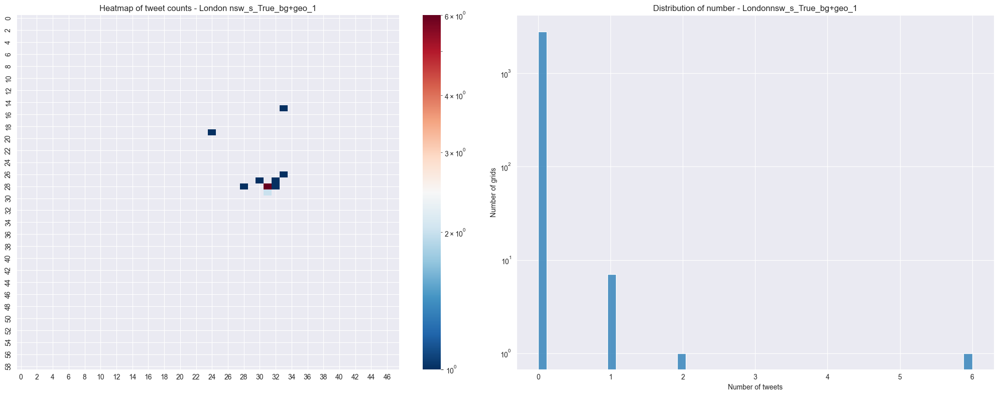

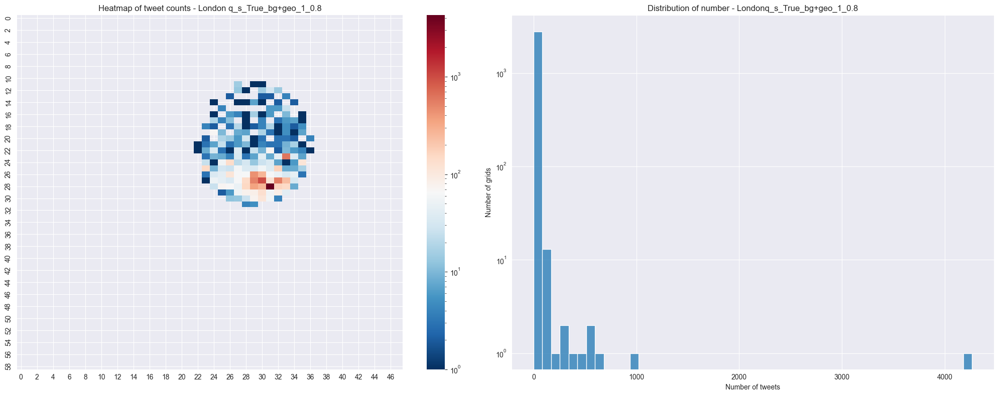

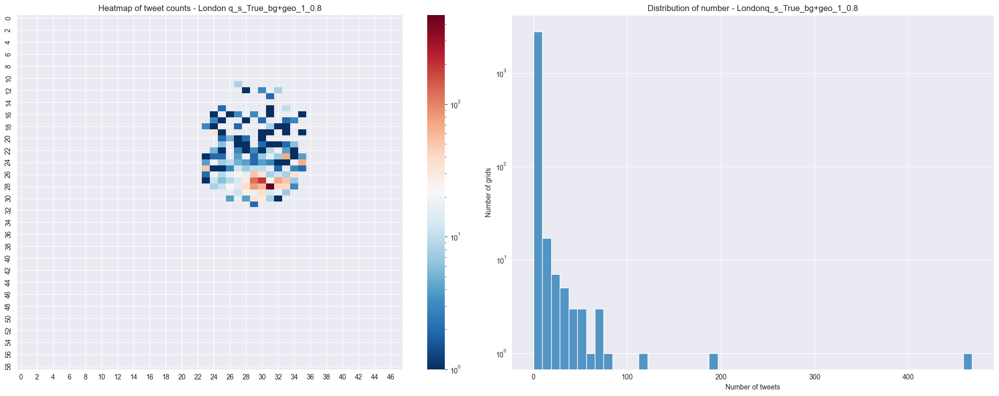

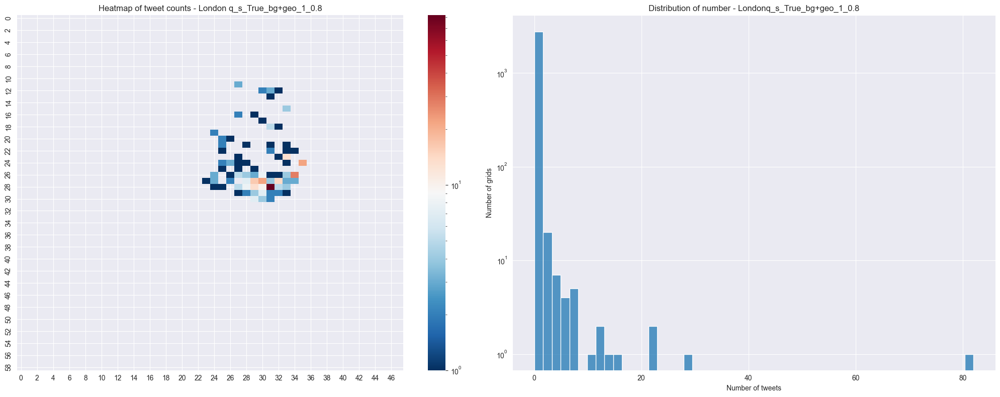

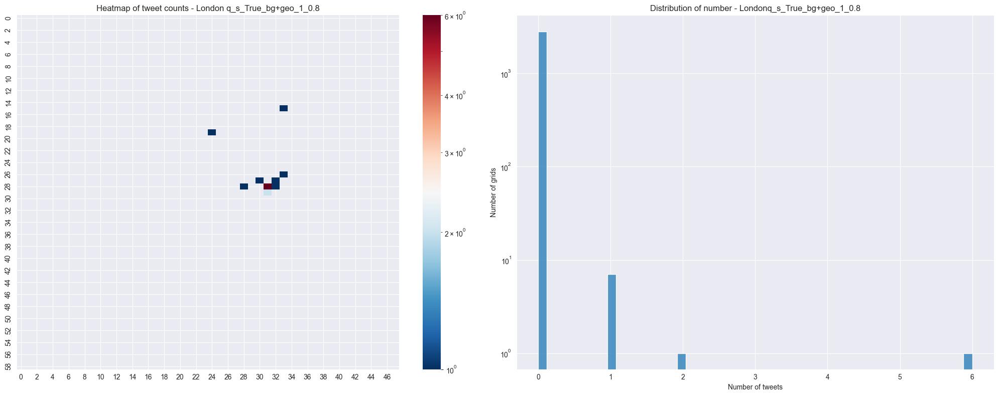

top 10 nsw_s_True_bg+geo_1:

Top 1: 6.6780, text: #MartinFreeman
Always super cute!  
What a sweetie seriously 
Somewhere in London in 2009

#TheHobbit #BilboBaggins #Sherlock #JohnWatson @ London, United Kingdom https://t.co/dZo1oG0Tqs

Top 2: 6.5718, text: The Shard 
#london #uk spring #cloudy #clouds #architecture #steel #glass #skyline #cityscape @ London, United Kingdom https://t.co/MFml7mVoYz

Top 3: 6.1056, text: LIFE IN BLOOM | Forever Mood. Gucci Bloom Profumo Di Fiori, Personified By Florals, Born To Bloom️FR
-
#gucci #bloom #forher @ The Shard London https://t.co/ytDBxVZMPF

Top 4: 5.9467, text: #me #italian #italiangirl #pink #outfit #outfitoftheday #sunny #sunnyday #selfie #london #londonlife #blonde #blondehair #blondegirl #happiness #dayoff #drmartens #glasses #lipstick @ London, United Kingdom https://t.co/EG69Vyu7Ae

Top 5: 5.9109, text: Large Cod Fish and Chips and an Old Jamaica Ginger Beer. (@ Johnny's Fish Bar in Bermondsey) https://t.co/jB7awRBONP

Top 6: 5.7957, 

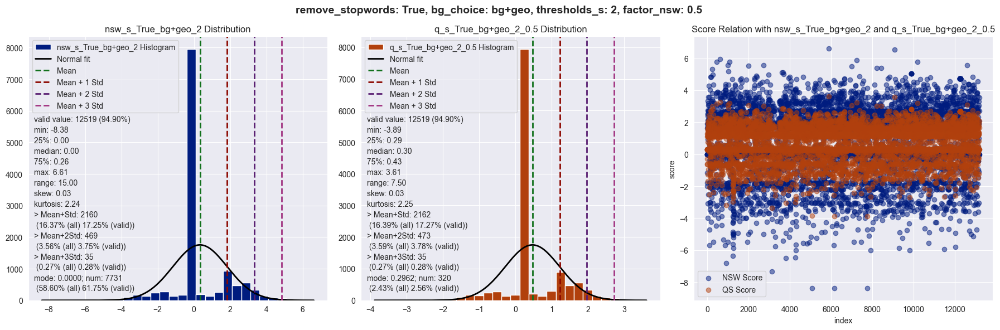

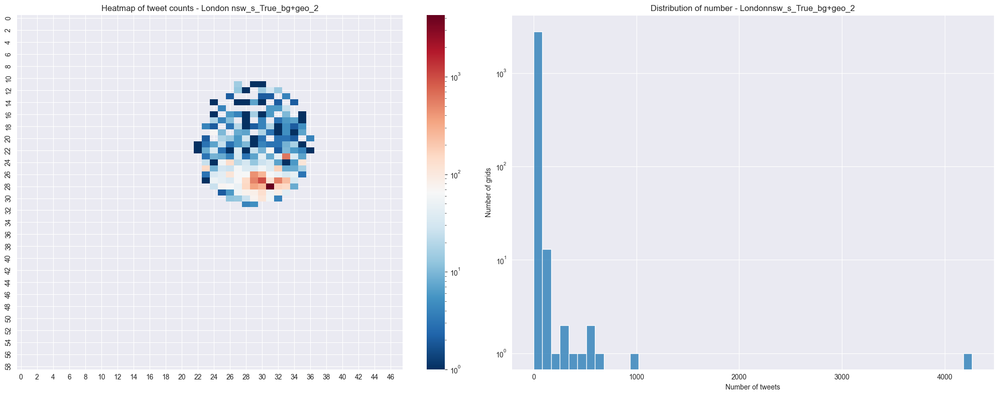

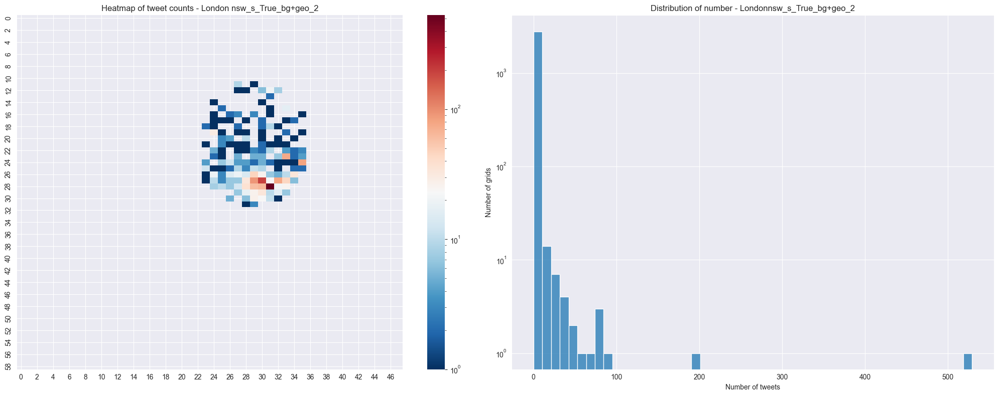

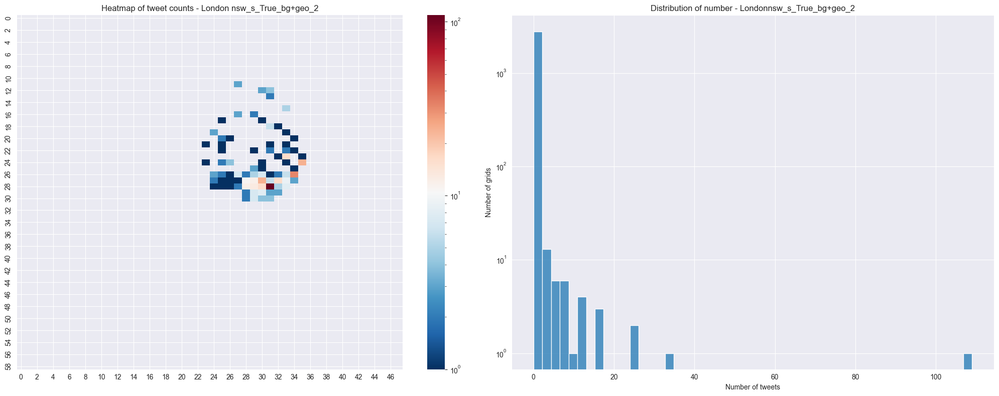

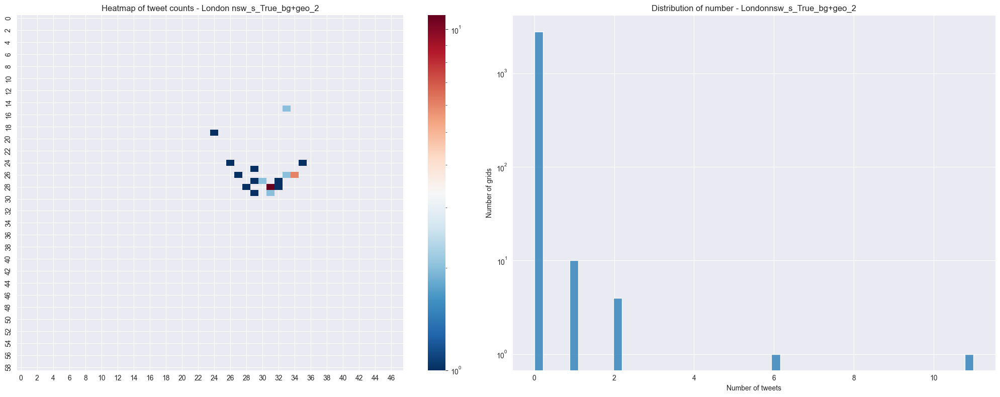

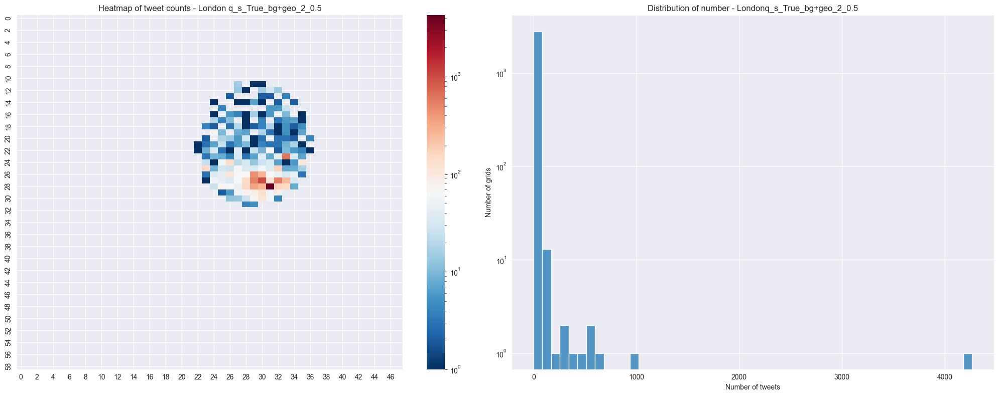

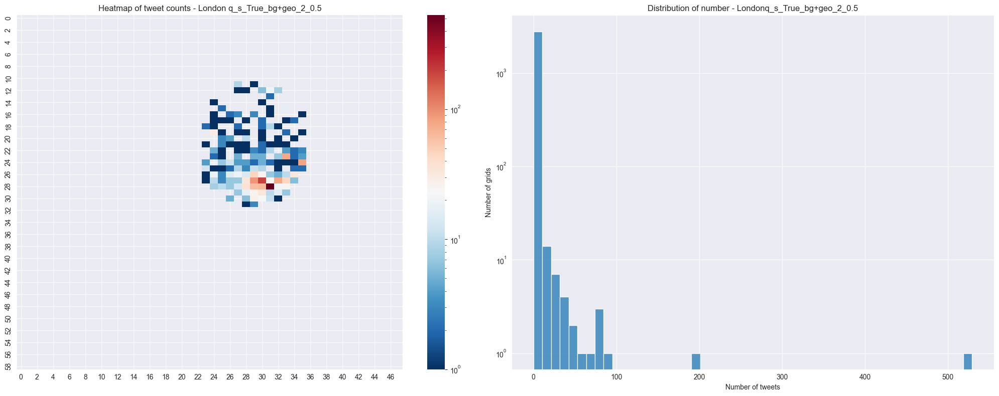

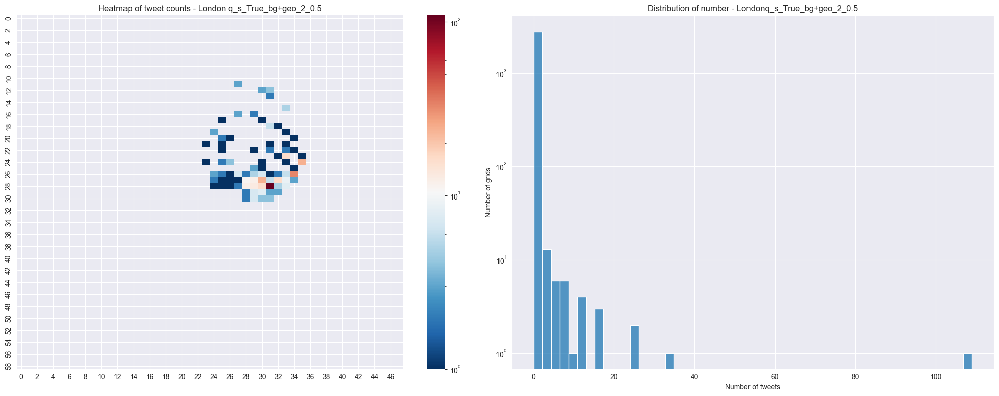

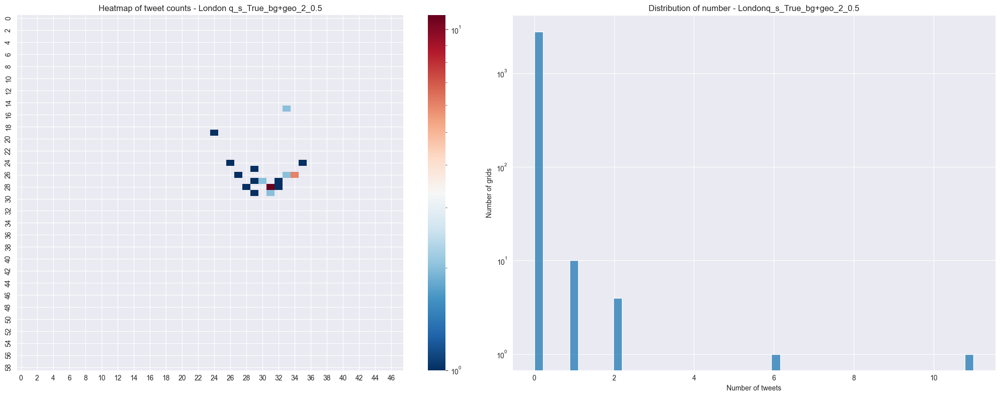

top 10 nsw_s_True_bg+geo_2:

Top 1: 6.6131, text: #MartinFreeman
Always super cute!  
What a sweetie seriously 
Somewhere in London in 2009

#TheHobbit #BilboBaggins #Sherlock #JohnWatson @ London, United Kingdom https://t.co/dZo1oG0Tqs

Top 2: 6.5360, text: The Shard 
#london #uk spring #cloudy #clouds #architecture #steel #glass #skyline #cityscape @ London, United Kingdom https://t.co/MFml7mVoYz

Top 3: 5.9485, text: LIFE IN BLOOM | Forever Mood. Gucci Bloom Profumo Di Fiori, Personified By Florals, Born To Bloom️FR
-
#gucci #bloom #forher @ The Shard London https://t.co/ytDBxVZMPF

Top 4: 5.8786, text: #me #italian #italiangirl #pink #outfit #outfitoftheday #sunny #sunnyday #selfie #london #londonlife #blonde #blondehair #blondegirl #happiness #dayoff #drmartens #glasses #lipstick @ London, United Kingdom https://t.co/EG69Vyu7Ae

Top 5: 5.7614, text: Just posted a photo @ St James Church, Clerkenwell https://t.co/bzLivfByTo

Top 6: 5.7614, text: #PunkDay2022 (@ BrewDog Clerkenwell 

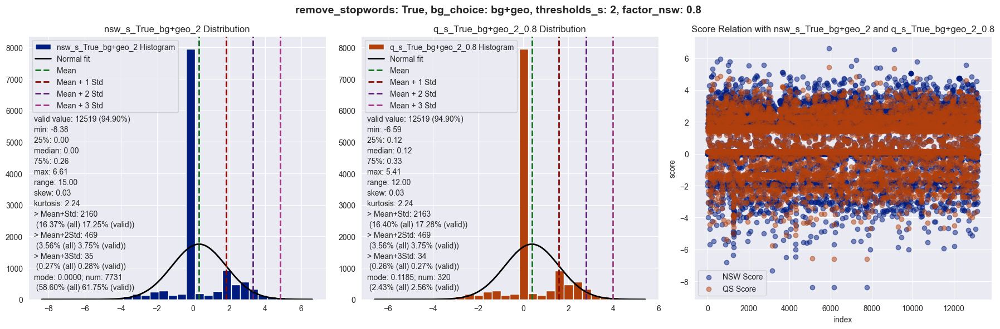

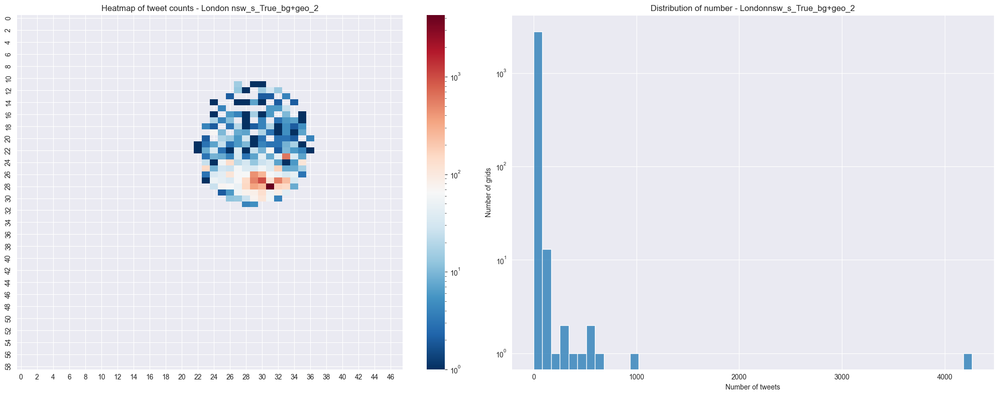

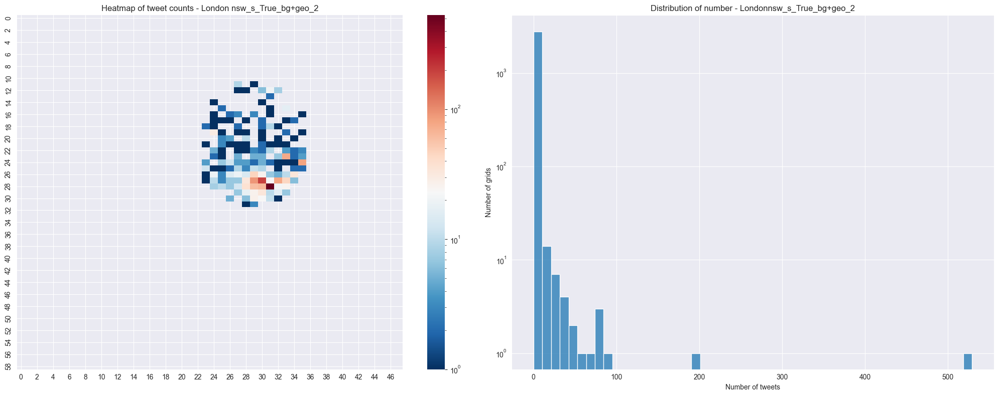

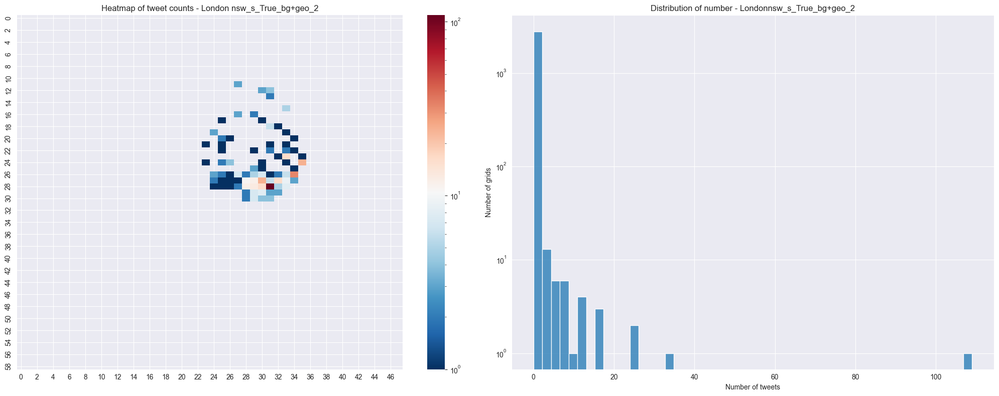

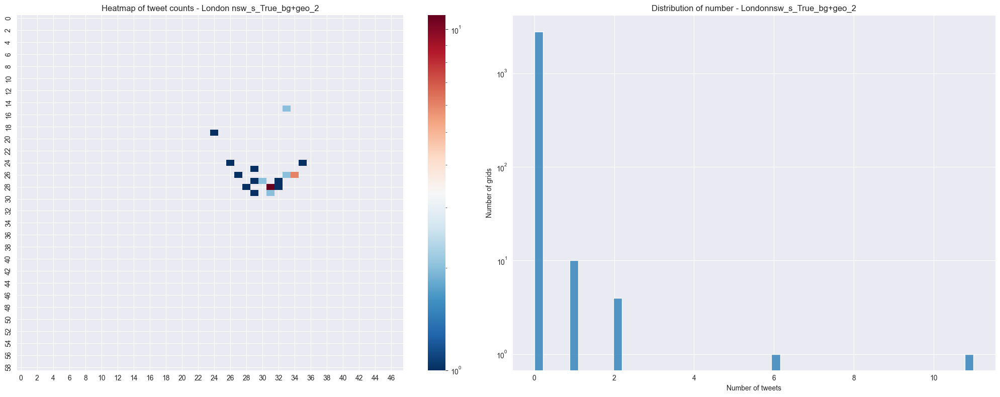

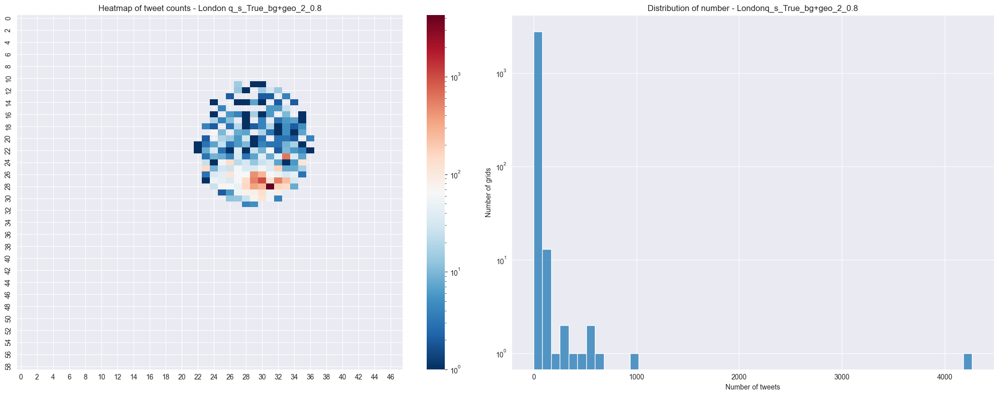

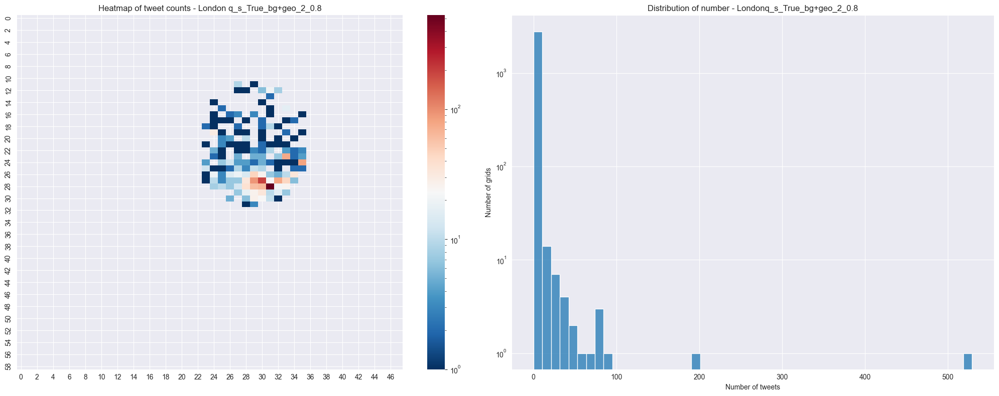

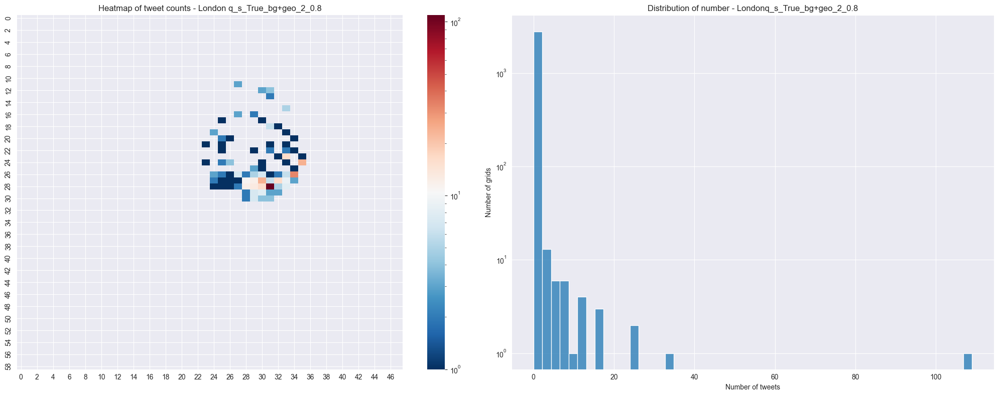

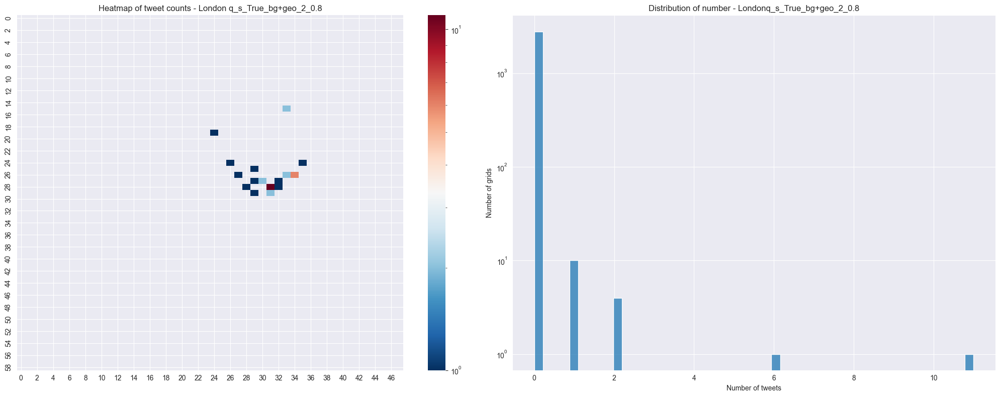

top 10 nsw_s_True_bg+geo_2:

Top 1: 6.6131, text: #MartinFreeman
Always super cute!  
What a sweetie seriously 
Somewhere in London in 2009

#TheHobbit #BilboBaggins #Sherlock #JohnWatson @ London, United Kingdom https://t.co/dZo1oG0Tqs

Top 2: 6.5360, text: The Shard 
#london #uk spring #cloudy #clouds #architecture #steel #glass #skyline #cityscape @ London, United Kingdom https://t.co/MFml7mVoYz

Top 3: 5.9485, text: LIFE IN BLOOM | Forever Mood. Gucci Bloom Profumo Di Fiori, Personified By Florals, Born To Bloom️FR
-
#gucci #bloom #forher @ The Shard London https://t.co/ytDBxVZMPF

Top 4: 5.8786, text: #me #italian #italiangirl #pink #outfit #outfitoftheday #sunny #sunnyday #selfie #london #londonlife #blonde #blondehair #blondegirl #happiness #dayoff #drmartens #glasses #lipstick @ London, United Kingdom https://t.co/EG69Vyu7Ae

Top 5: 5.7614, text: Just posted a photo @ St James Church, Clerkenwell https://t.co/bzLivfByTo

Top 6: 5.7614, text: #PunkDay2022 (@ BrewDog Clerkenwell 

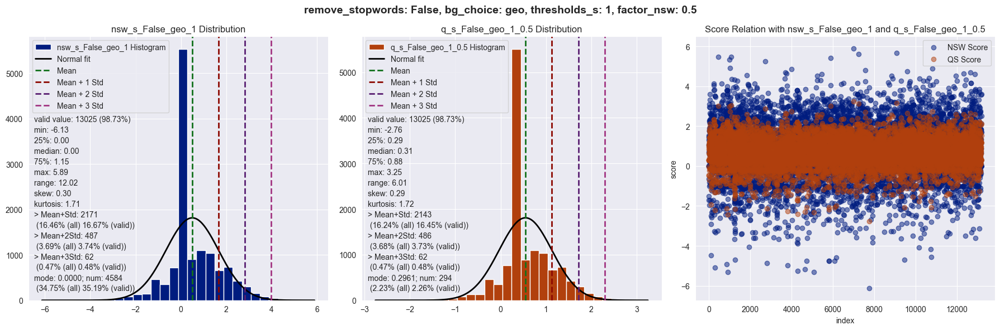

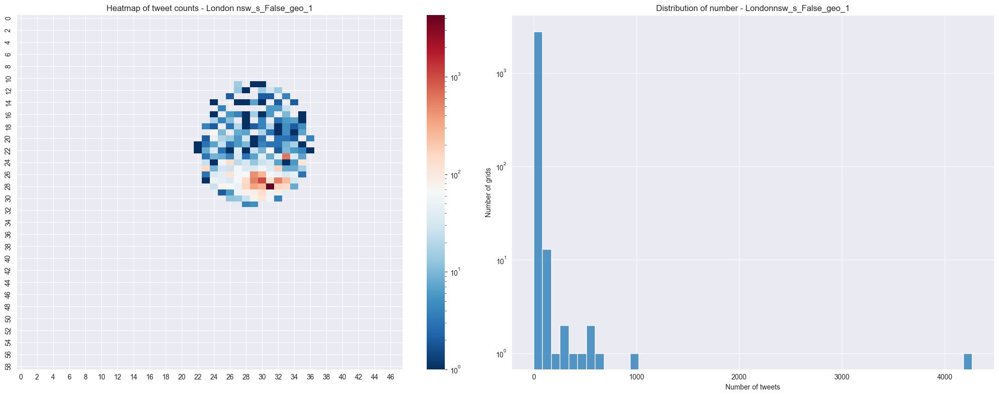

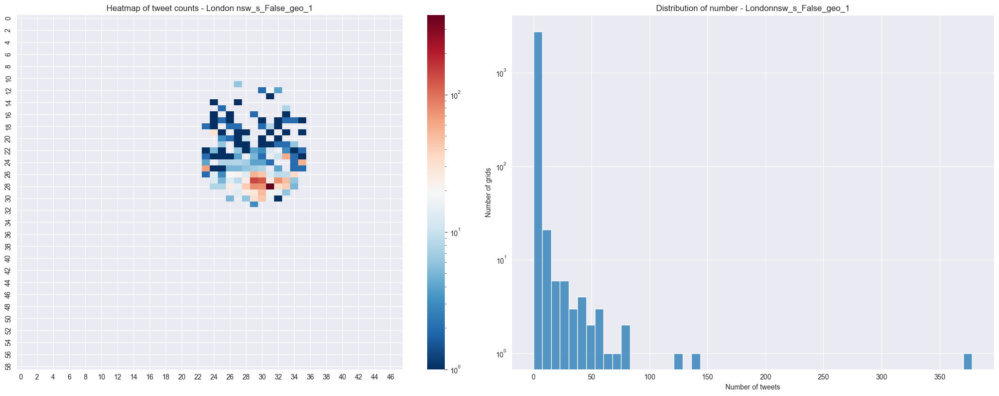

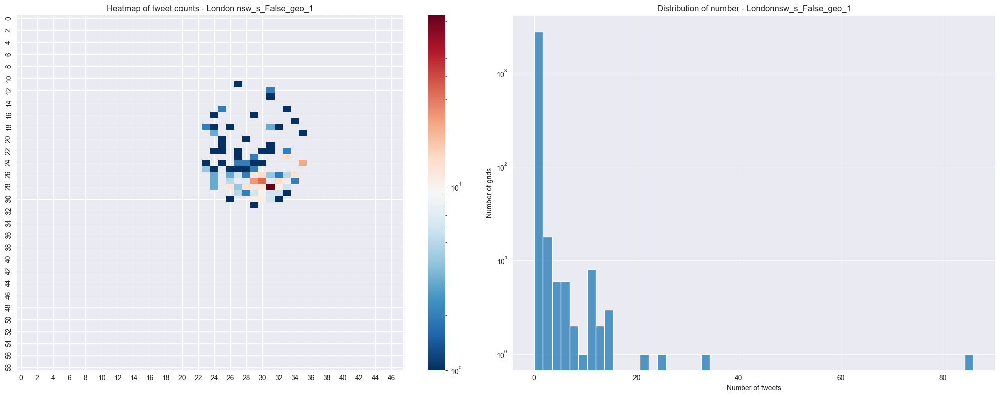

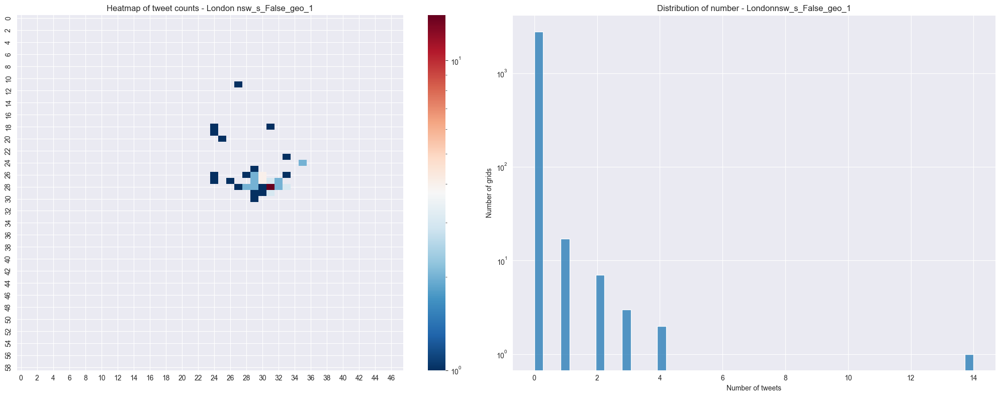

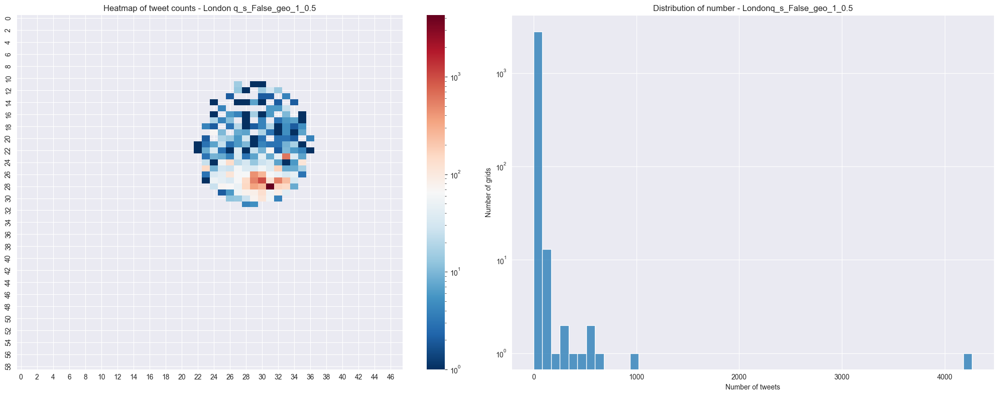

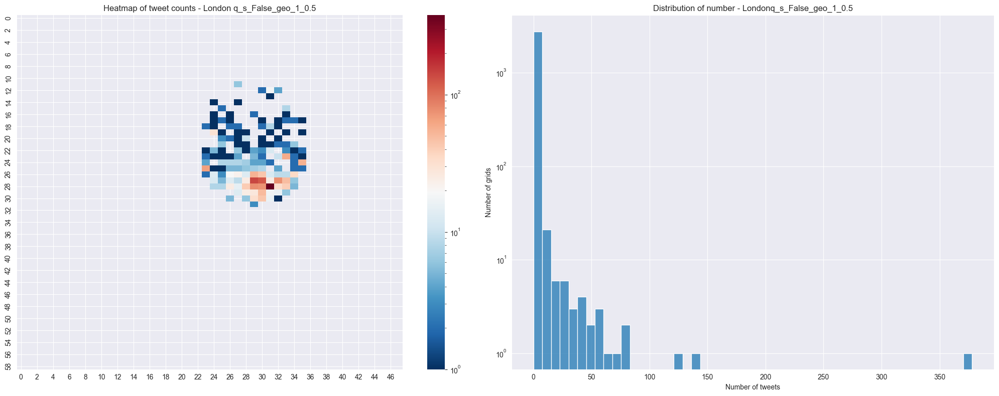

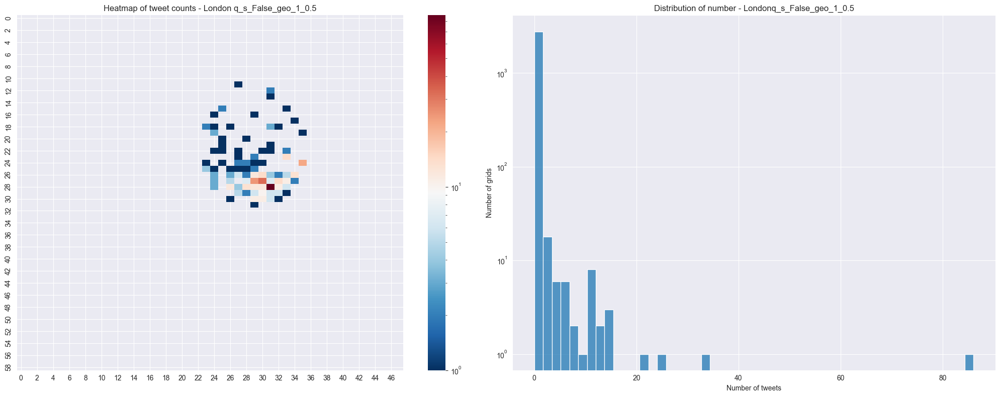

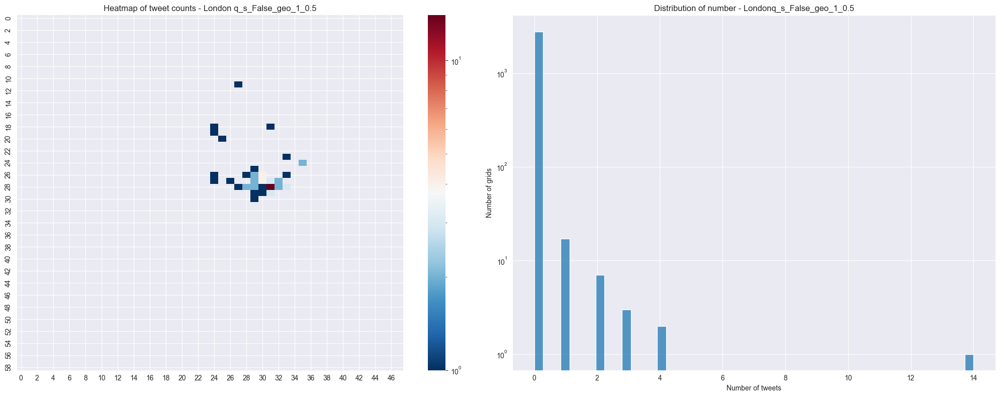

top 10 nsw_s_False_geo_1:

Top 1: 5.8930, text: Last few bags from my fundraiser up for grabs from my Etsy shop( link in bio) .
Next fundraiser up in March. 
Profit go to @greekanimalrescue. @ London, United Kingdom https://t.co/795edS0i1f

Top 2: 5.6721, text: The Shard 
#london #uk spring #cloudy #clouds #architecture #steel #glass #skyline #cityscape @ London, United Kingdom https://t.co/MFml7mVoYz

Top 3: 5.6243, text: #me #italian #italiangirl #pink #outfit #outfitoftheday #sunny #sunnyday #selfie #london #londonlife #blonde #blondehair #blondegirl #happiness #dayoff #drmartens #glasses #lipstick @ London, United Kingdom https://t.co/EG69Vyu7Ae

Top 4: 5.4779, text: Just posted a photo @ St James Church, Clerkenwell https://t.co/bzLivfByTo

Top 5: 5.4741, text: #PunkDay2022 (@ BrewDog Clerkenwell - @brewdogcwell in London) https://t.co/yP2thJQgDX

Top 6: 5.4143, text: #MartinFreeman
Always super cute!  
What a sweetie seriously 
Somewhere in London in 2009

#TheHobbit #BilboBaggin

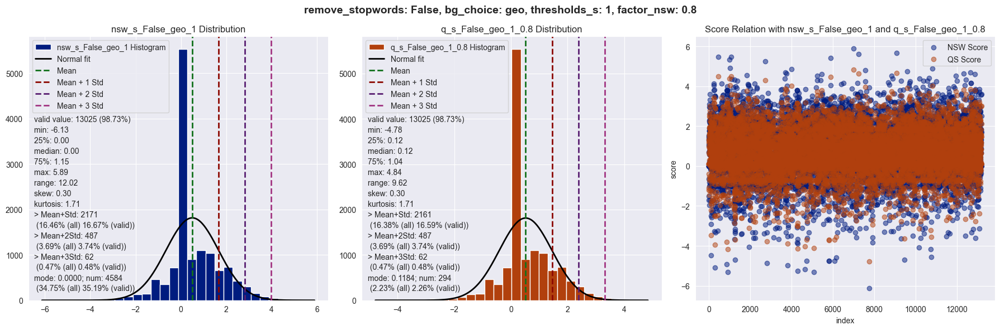

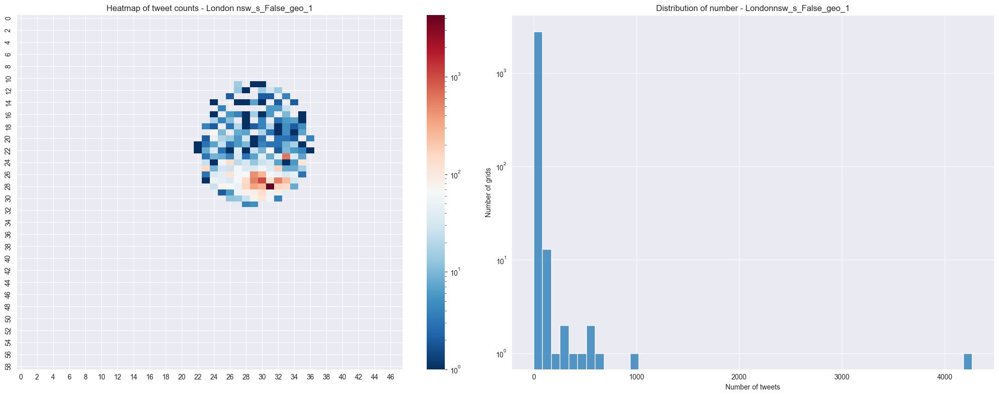

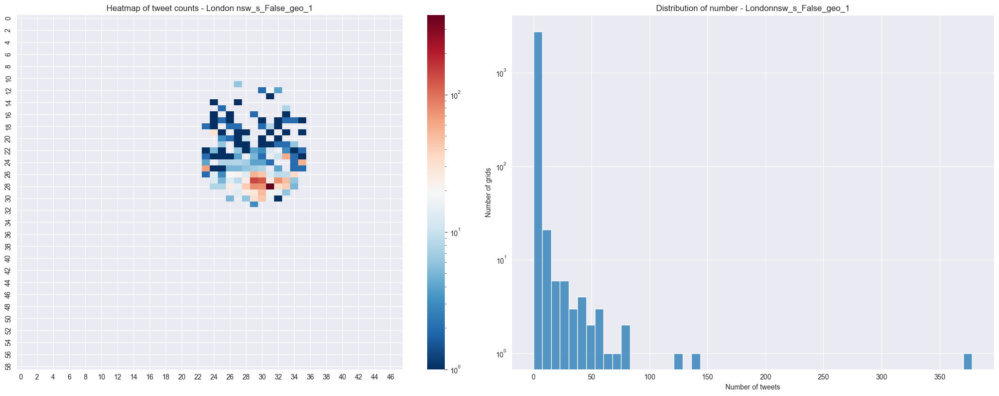

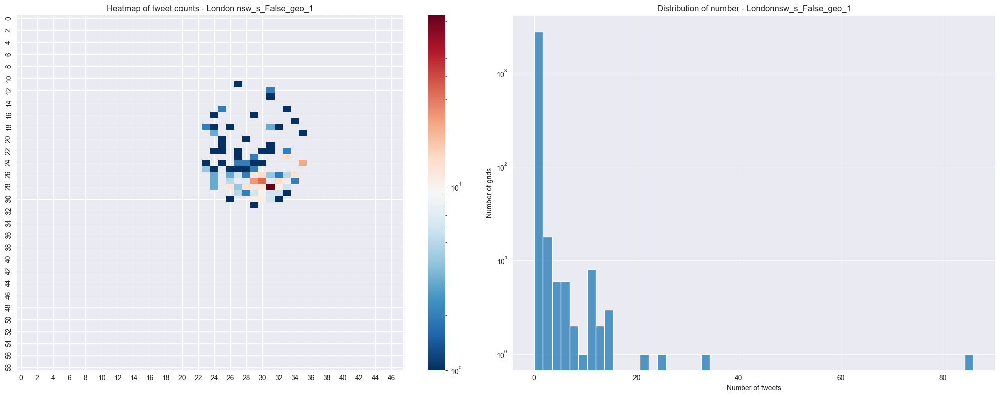

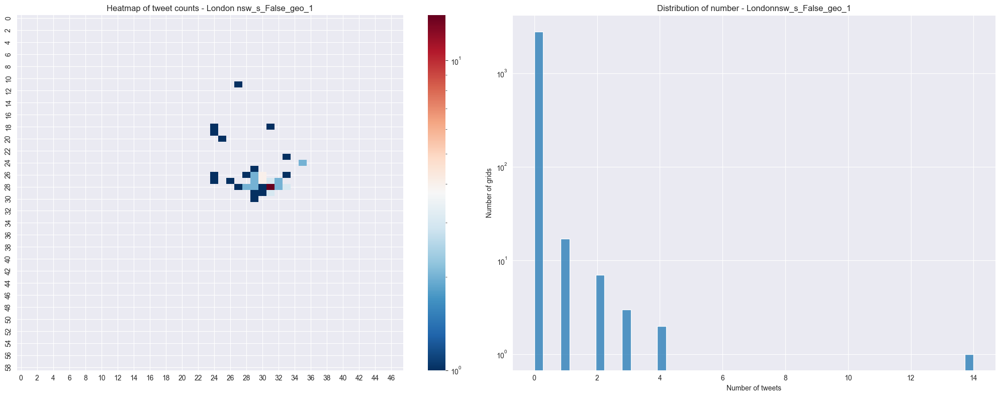

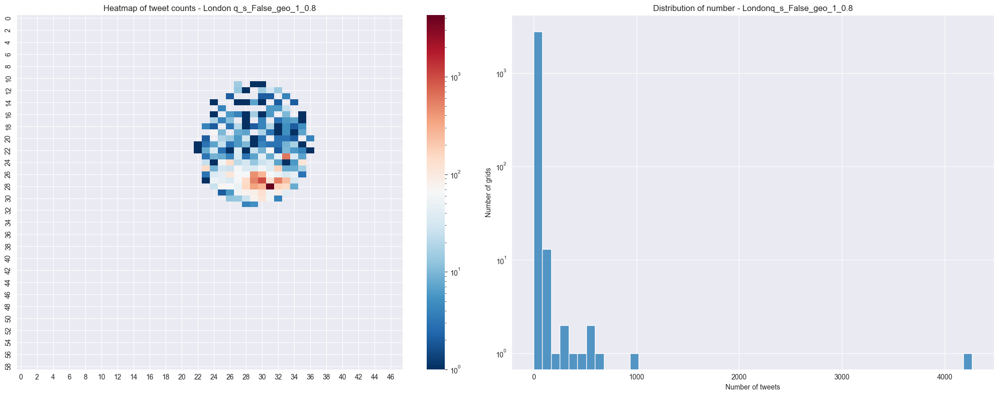

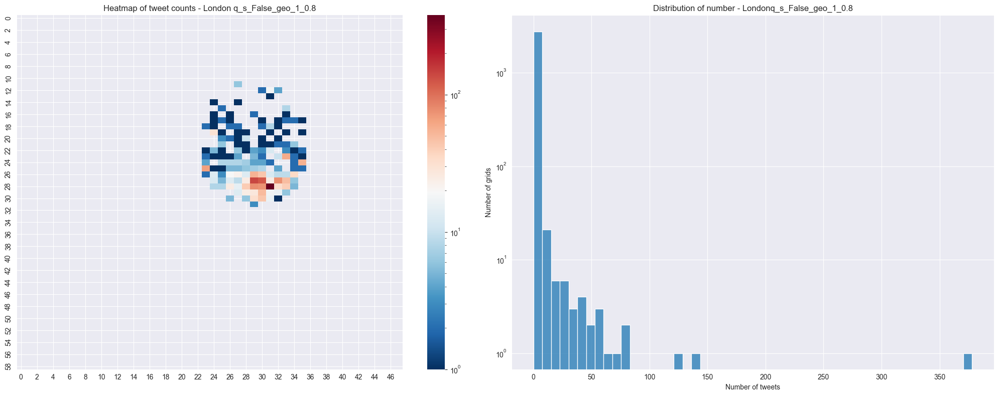

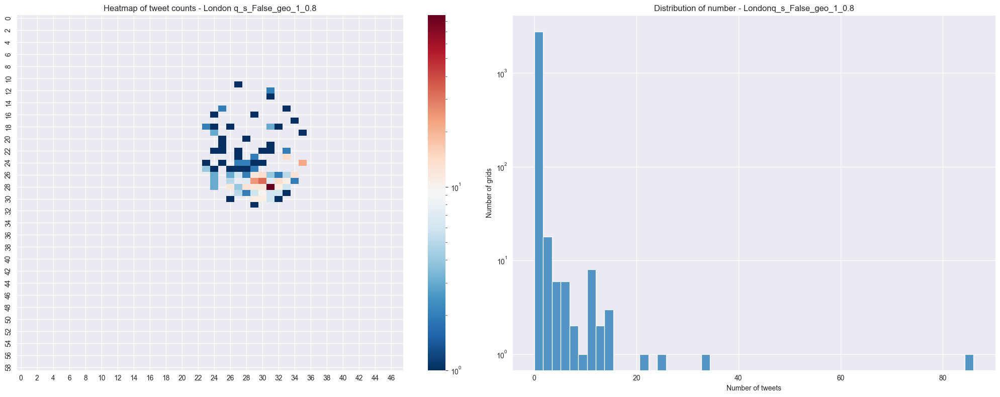

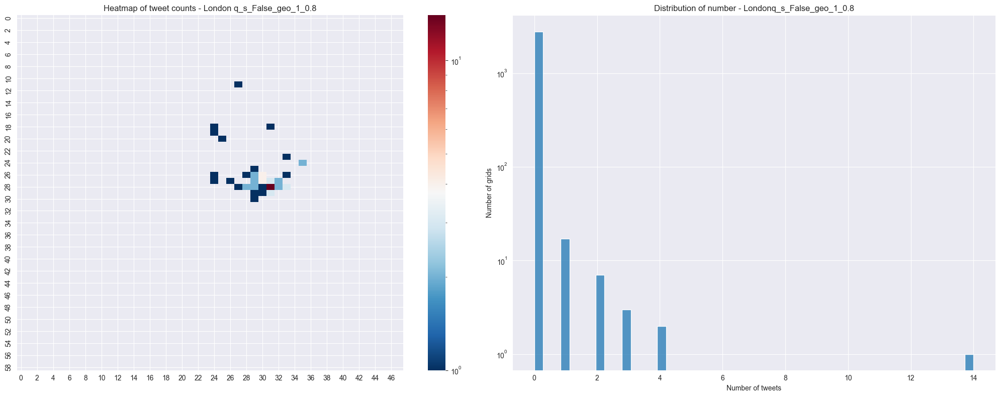

top 10 nsw_s_False_geo_1:

Top 1: 5.8930, text: Last few bags from my fundraiser up for grabs from my Etsy shop( link in bio) .
Next fundraiser up in March. 
Profit go to @greekanimalrescue. @ London, United Kingdom https://t.co/795edS0i1f

Top 2: 5.6721, text: The Shard 
#london #uk spring #cloudy #clouds #architecture #steel #glass #skyline #cityscape @ London, United Kingdom https://t.co/MFml7mVoYz

Top 3: 5.6243, text: #me #italian #italiangirl #pink #outfit #outfitoftheday #sunny #sunnyday #selfie #london #londonlife #blonde #blondehair #blondegirl #happiness #dayoff #drmartens #glasses #lipstick @ London, United Kingdom https://t.co/EG69Vyu7Ae

Top 4: 5.4779, text: Just posted a photo @ St James Church, Clerkenwell https://t.co/bzLivfByTo

Top 5: 5.4741, text: #PunkDay2022 (@ BrewDog Clerkenwell - @brewdogcwell in London) https://t.co/yP2thJQgDX

Top 6: 5.4143, text: #MartinFreeman
Always super cute!  
What a sweetie seriously 
Somewhere in London in 2009

#TheHobbit #BilboBaggin

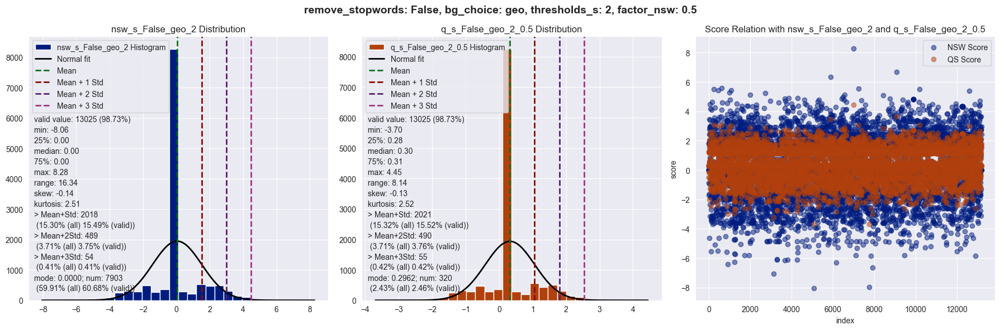

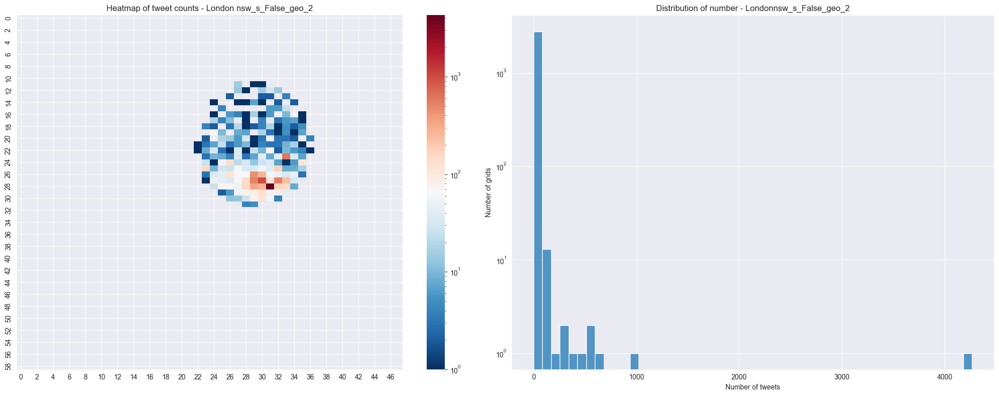

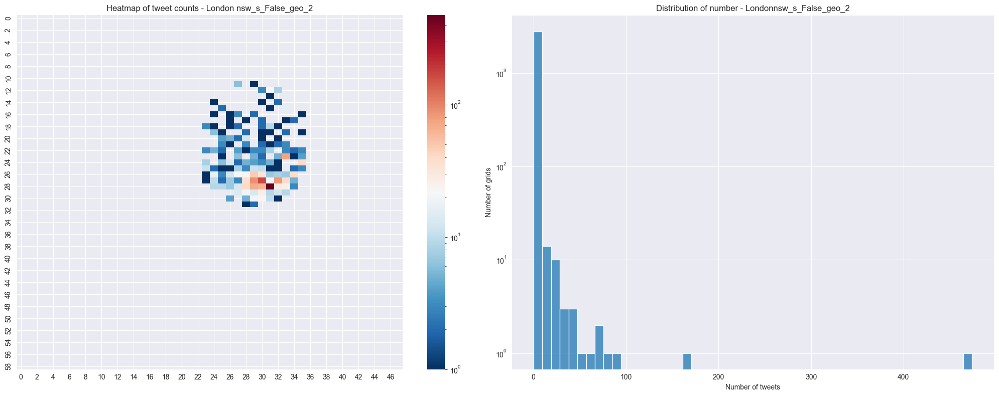

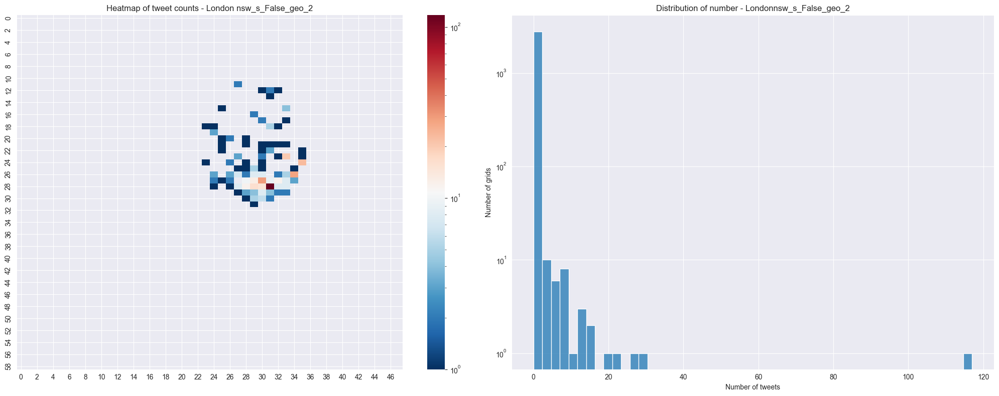

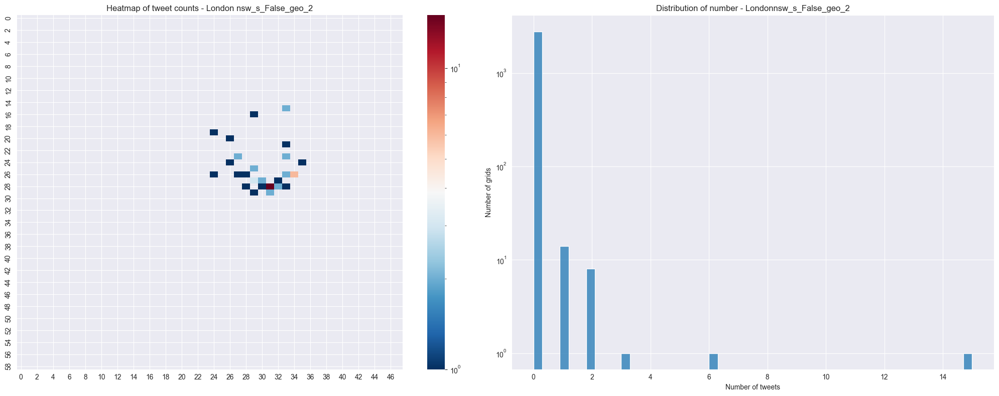

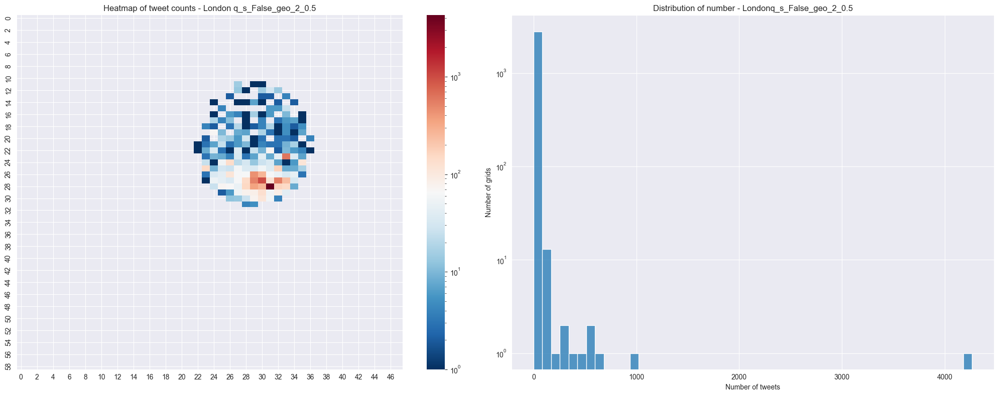

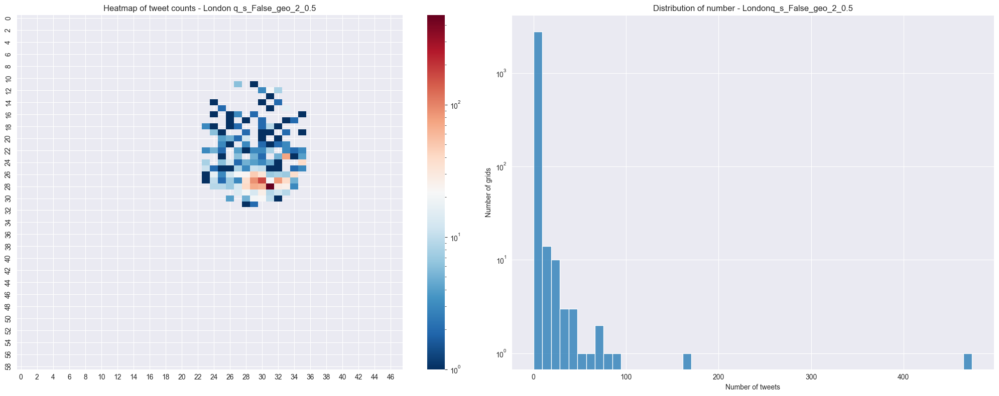

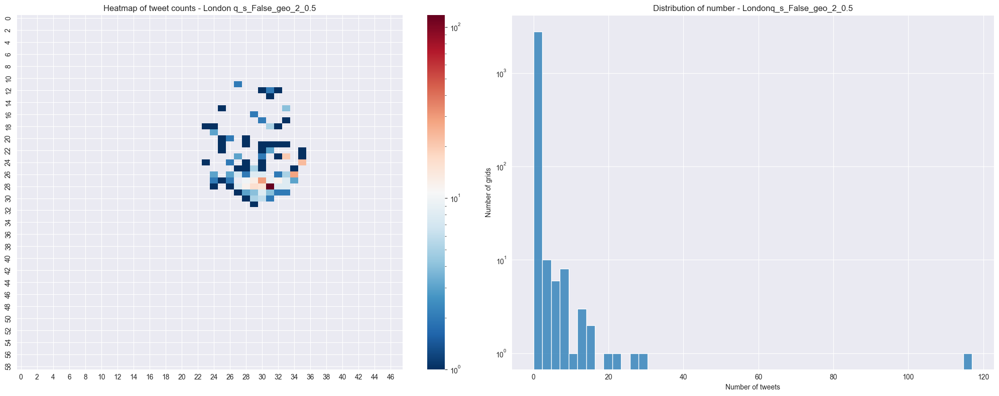

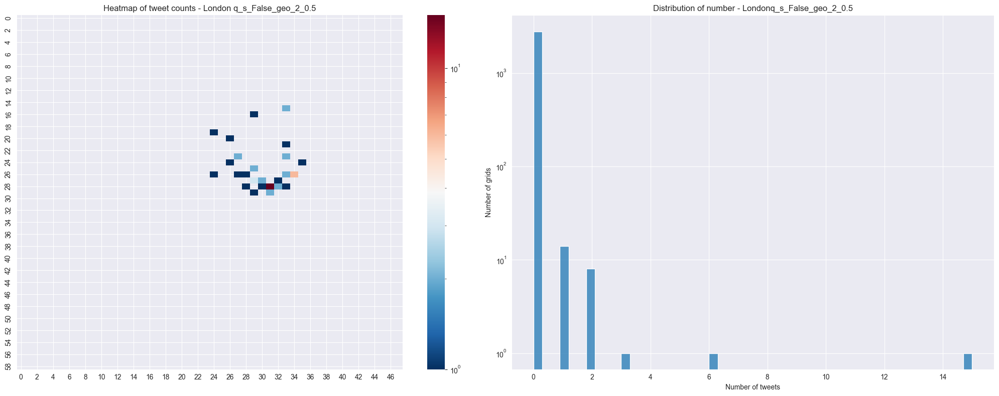

top 10 nsw_s_False_geo_2:

Top 1: 8.2847, text: Last few bags from my fundraiser up for grabs from my Etsy shop( link in bio) .
Next fundraiser up in March. 
Profit go to @greekanimalrescue. @ London, United Kingdom https://t.co/795edS0i1f

Top 2: 6.6698, text: The Shard 
#london #uk spring #cloudy #clouds #architecture #steel #glass #skyline #cityscape @ London, United Kingdom https://t.co/MFml7mVoYz

Top 3: 6.3370, text: #MartinFreeman
Always super cute!  
What a sweetie seriously 
Somewhere in London in 2009

#TheHobbit #BilboBaggins #Sherlock #JohnWatson @ London, United Kingdom https://t.co/dZo1oG0Tqs

Top 4: 5.5776, text: LIFE IN BLOOM | Forever Mood. Gucci Bloom Profumo Di Fiori, Personified By Florals, Born To Bloom️FR
-
#gucci #bloom #forher @ The Shard London https://t.co/ytDBxVZMPF

Top 5: 5.5553, text: #me #italian #italiangirl #pink #outfit #outfitoftheday #sunny #sunnyday #selfie #london #londonlife #blonde #blondehair #blondegirl #happiness #dayoff #drmartens #glasses #l

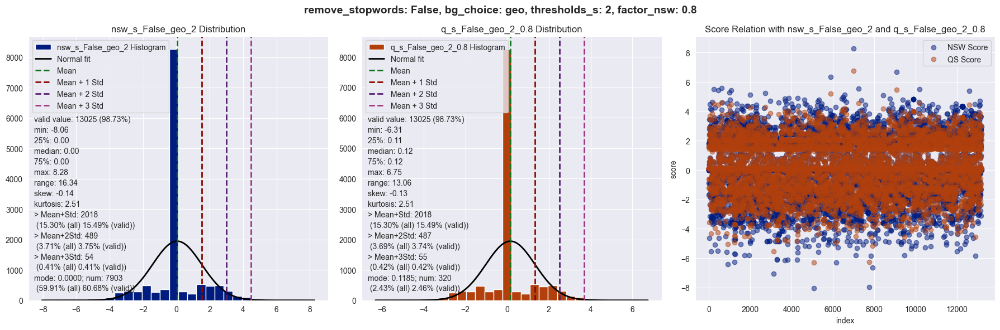

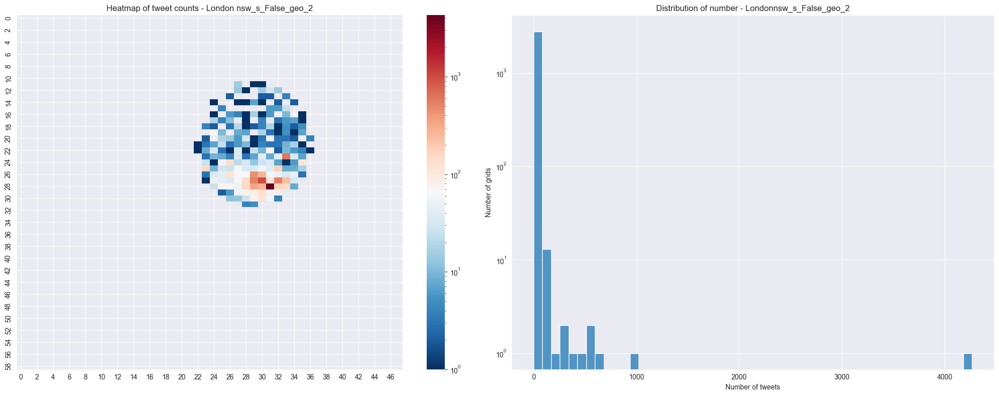

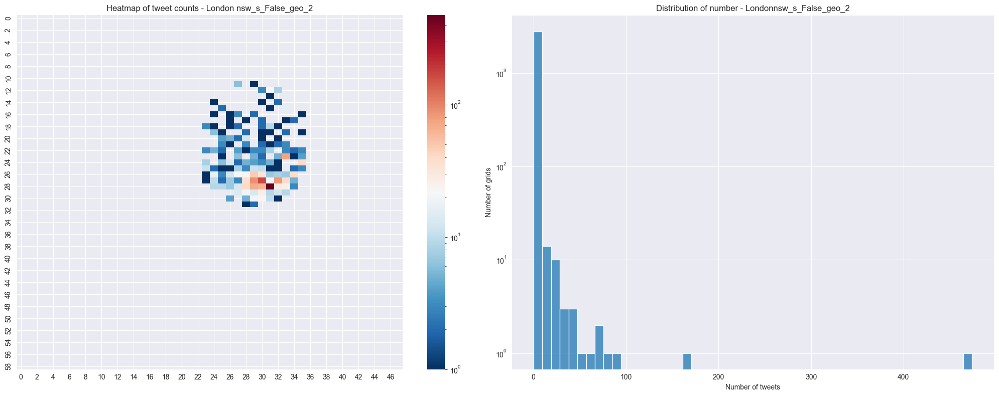

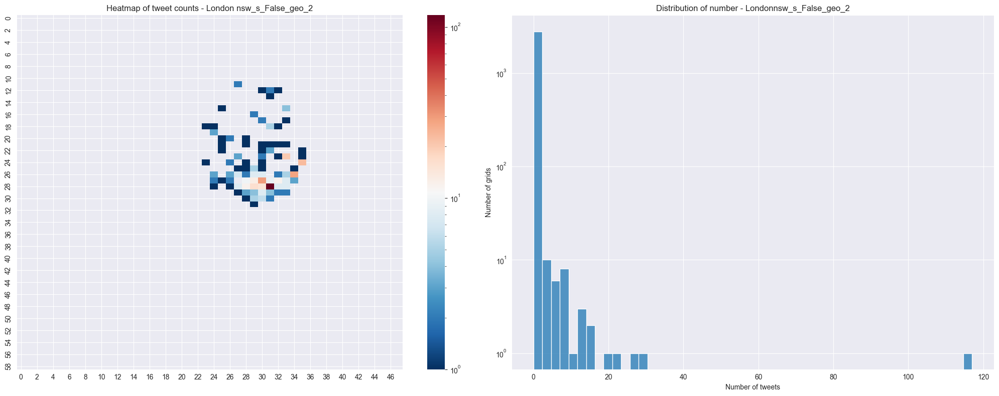

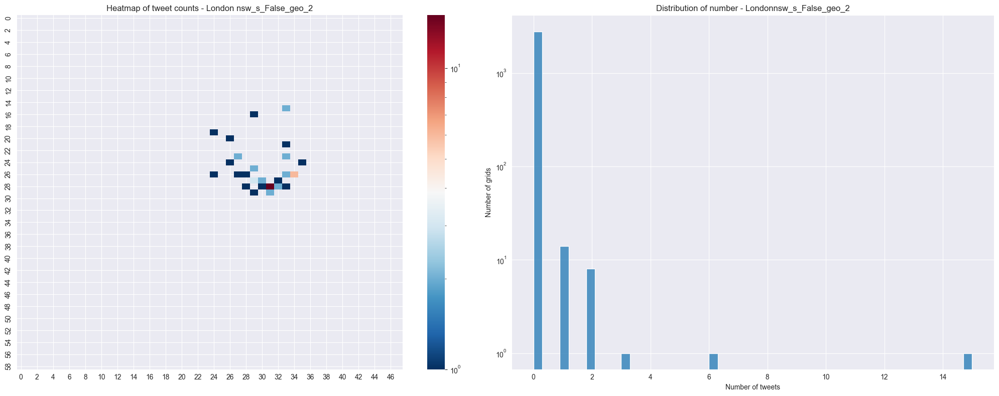

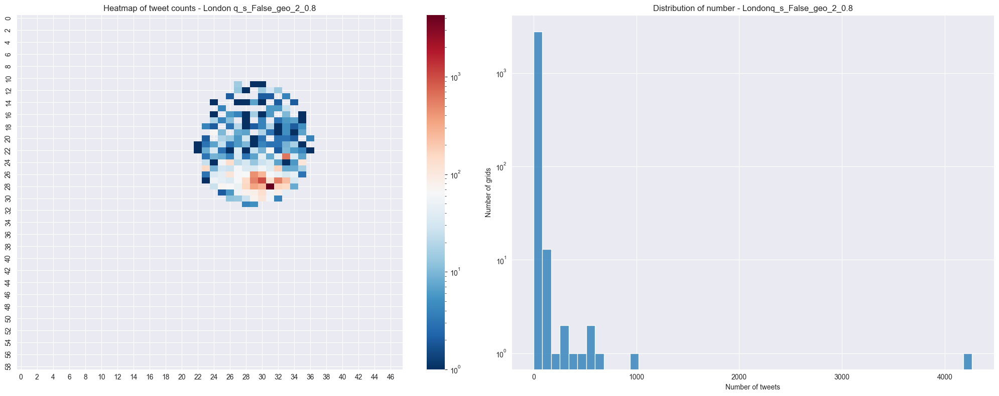

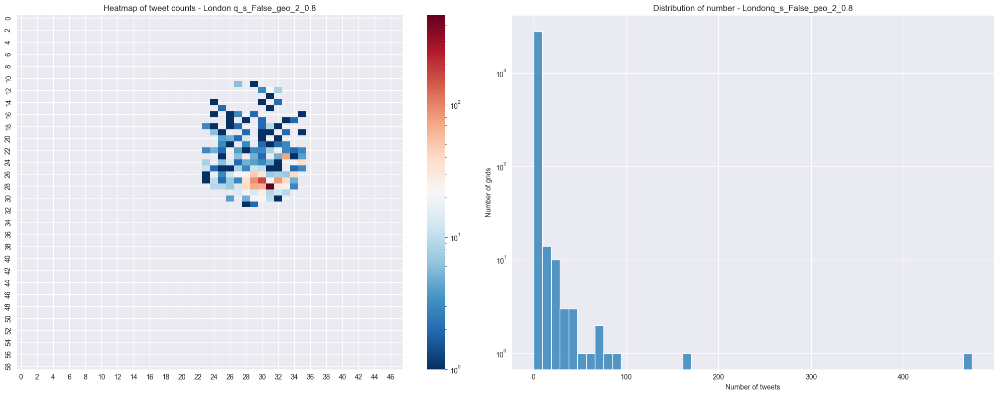

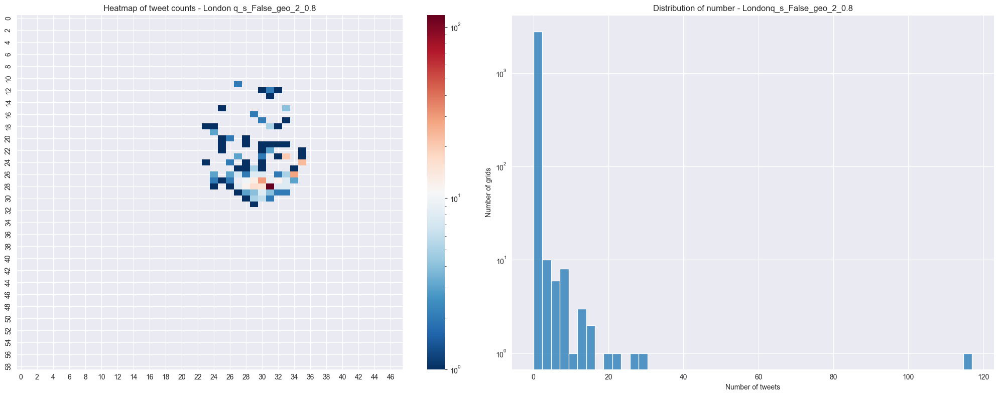

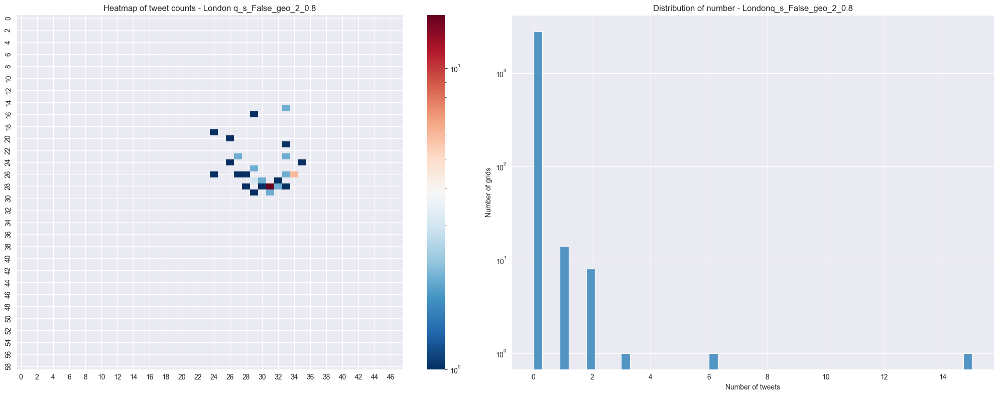

top 10 nsw_s_False_geo_2:

Top 1: 8.2847, text: Last few bags from my fundraiser up for grabs from my Etsy shop( link in bio) .
Next fundraiser up in March. 
Profit go to @greekanimalrescue. @ London, United Kingdom https://t.co/795edS0i1f

Top 2: 6.6698, text: The Shard 
#london #uk spring #cloudy #clouds #architecture #steel #glass #skyline #cityscape @ London, United Kingdom https://t.co/MFml7mVoYz

Top 3: 6.3370, text: #MartinFreeman
Always super cute!  
What a sweetie seriously 
Somewhere in London in 2009

#TheHobbit #BilboBaggins #Sherlock #JohnWatson @ London, United Kingdom https://t.co/dZo1oG0Tqs

Top 4: 5.5776, text: LIFE IN BLOOM | Forever Mood. Gucci Bloom Profumo Di Fiori, Personified By Florals, Born To Bloom️FR
-
#gucci #bloom #forher @ The Shard London https://t.co/ytDBxVZMPF

Top 5: 5.5553, text: #me #italian #italiangirl #pink #outfit #outfitoftheday #sunny #sunnyday #selfie #london #londonlife #blonde #blondehair #blondegirl #happiness #dayoff #drmartens #glasses #l

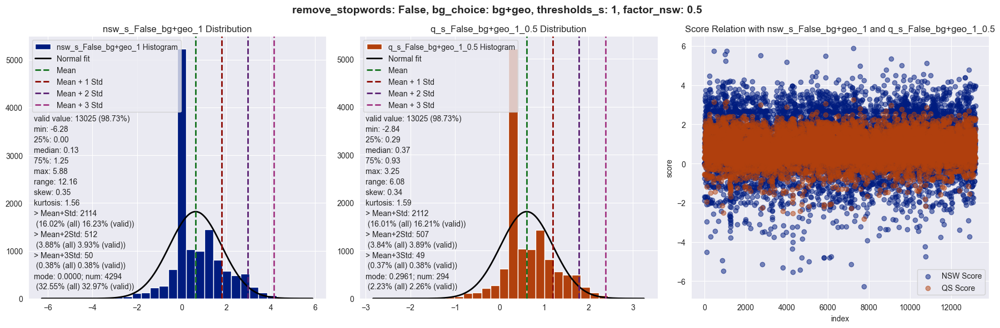

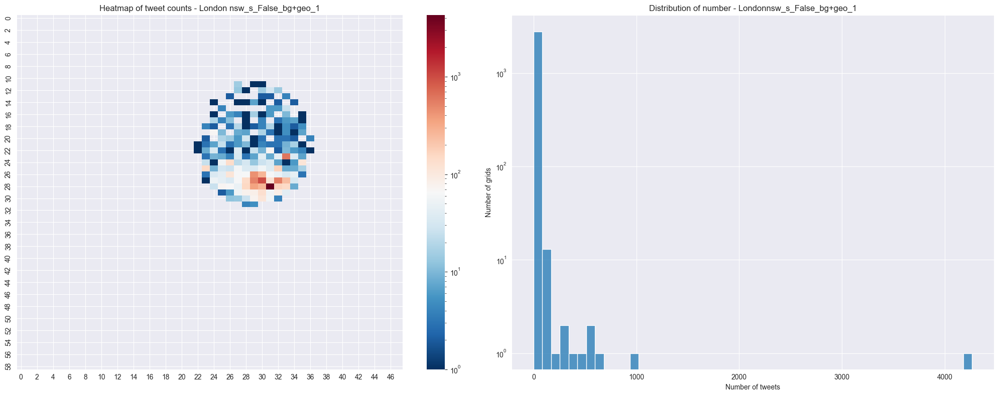

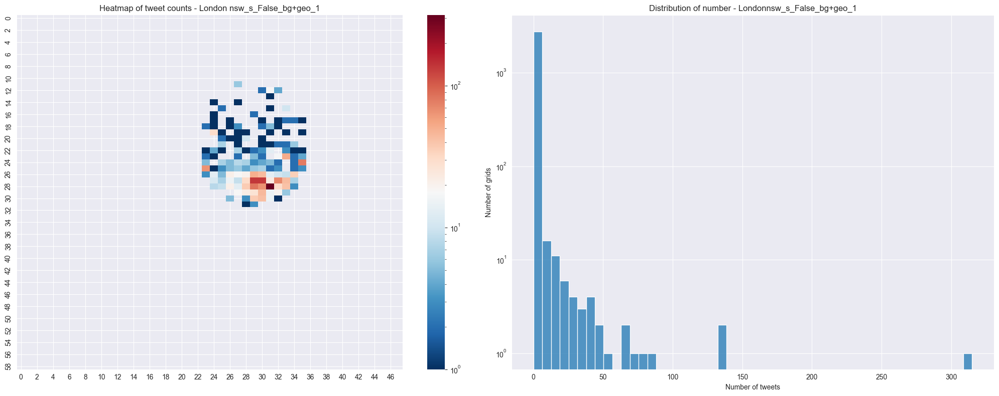

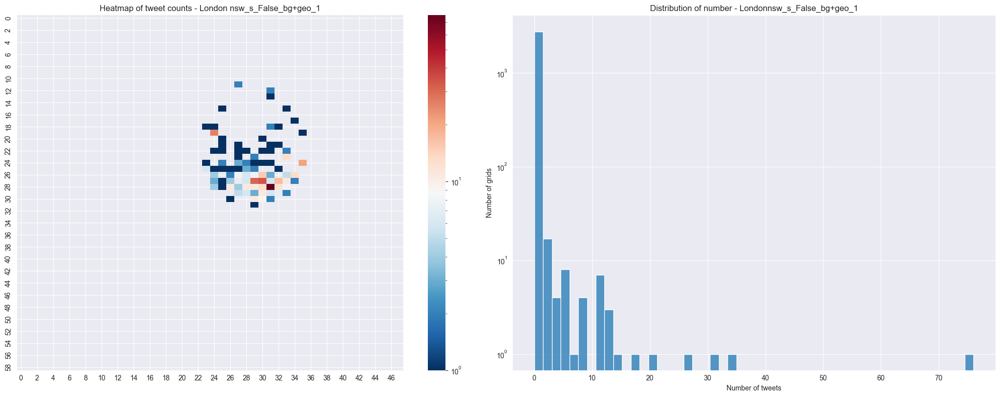

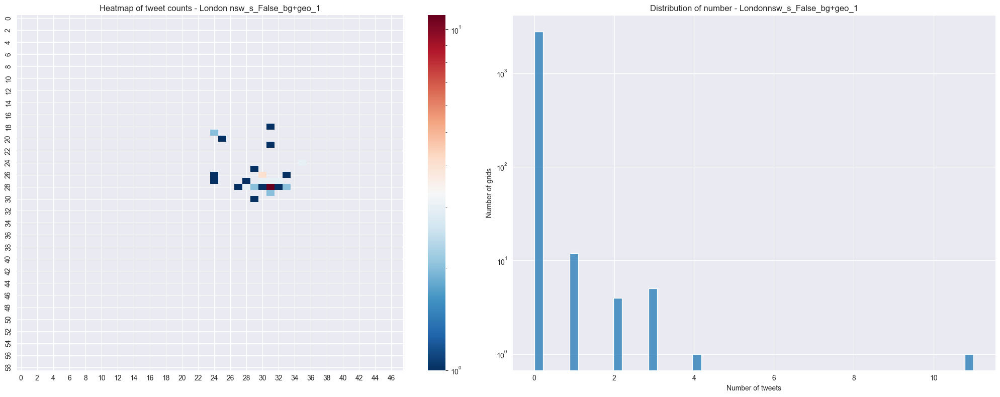

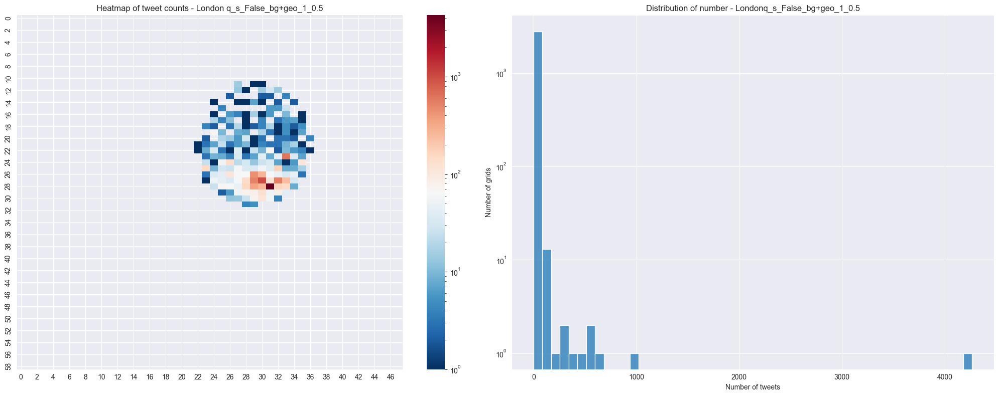

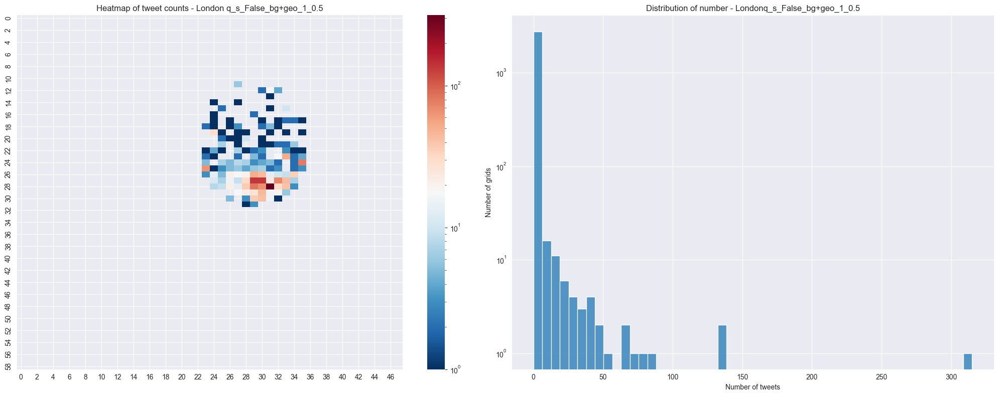

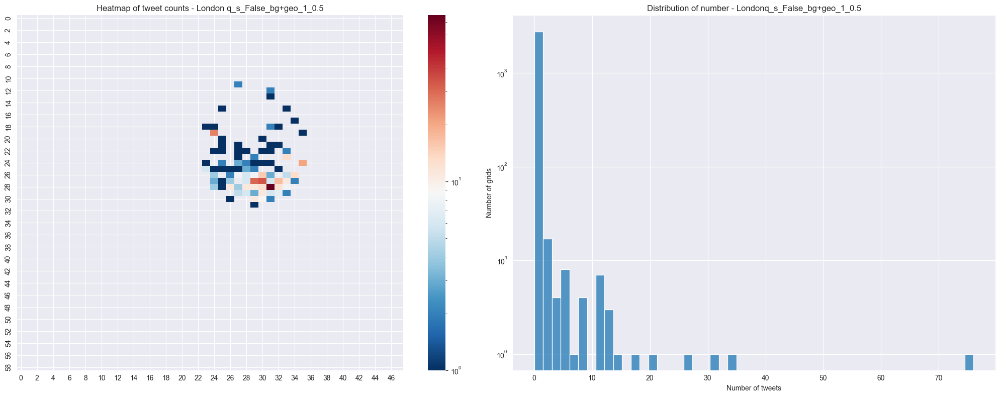

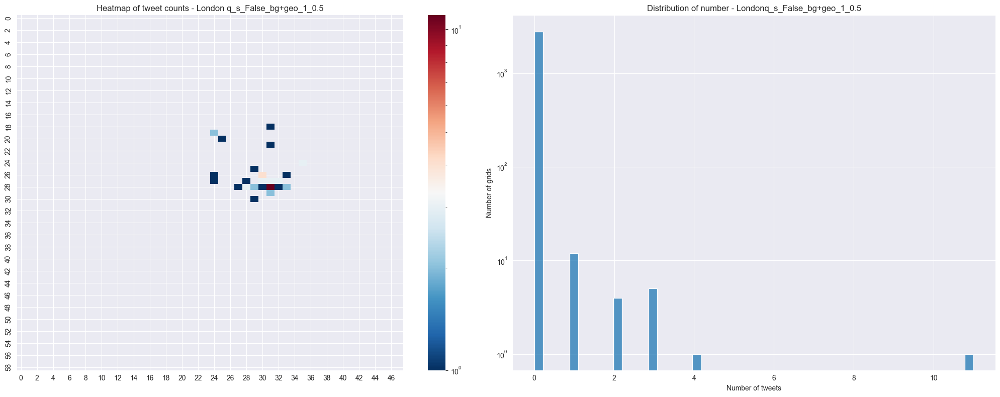

top 10 nsw_s_False_bg+geo_1:

Top 1: 5.8823, text: #me #italian #italiangirl #pink #outfit #outfitoftheday #sunny #sunnyday #selfie #london #londonlife #blonde #blondehair #blondegirl #happiness #dayoff #drmartens #glasses #lipstick @ London, United Kingdom https://t.co/EG69Vyu7Ae

Top 2: 5.7326, text: #PunkDay2022 (@ BrewDog Clerkenwell - @brewdogcwell in London) https://t.co/yP2thJQgDX

Top 3: 5.7313, text: Just posted a photo @ St James Church, Clerkenwell https://t.co/bzLivfByTo

Top 4: 5.5683, text: Such a handsome boy! #blacklab #blacklaba #blacklabsofinstagram @ London, United Kingdom https://t.co/H0ZY8AjA8x

Top 5: 5.5153, text: #candles #candle #candleholder #tray #black #blackcandle #candlesofinstagram #smallshop #smallbusinessuk #smallbusiness #candlelover #candletray #roses #darkaesthetic #dark @ United Kingdom https://t.co/IcF0N7lMqS

Top 6: 5.4739, text: #MartinFreeman
Always super cute!  
What a sweetie seriously 
Somewhere in London in 2009

#TheHobbit #BilboBaggins #Sh

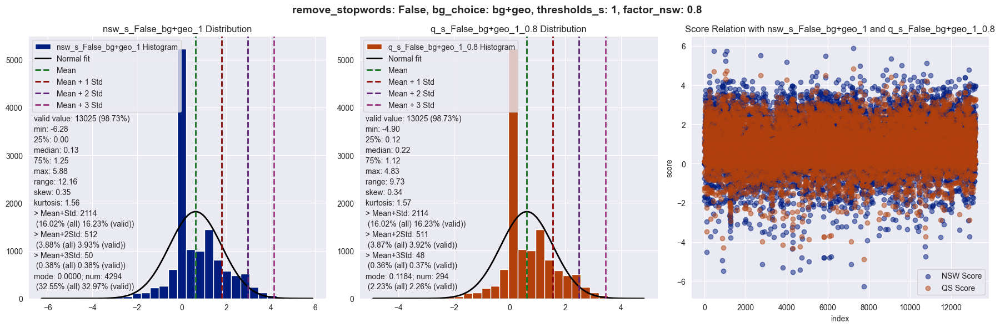

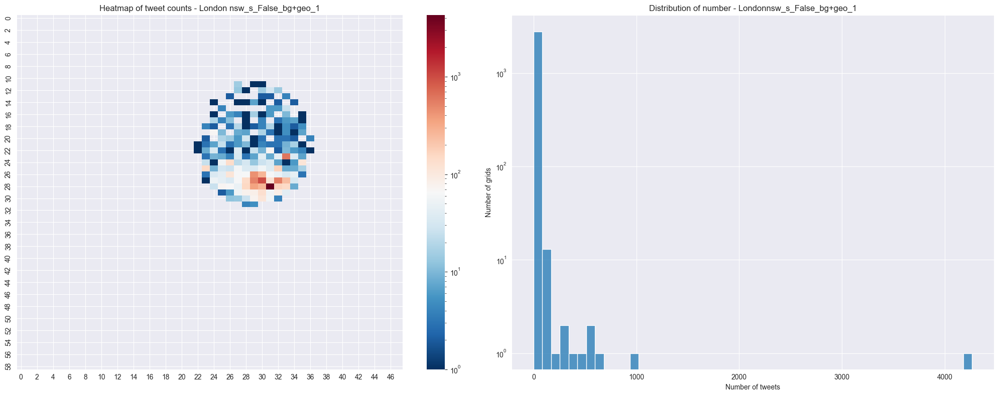

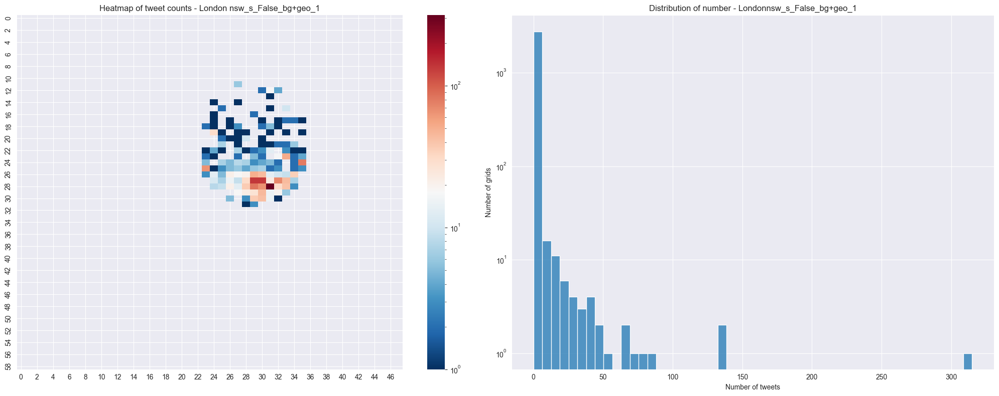

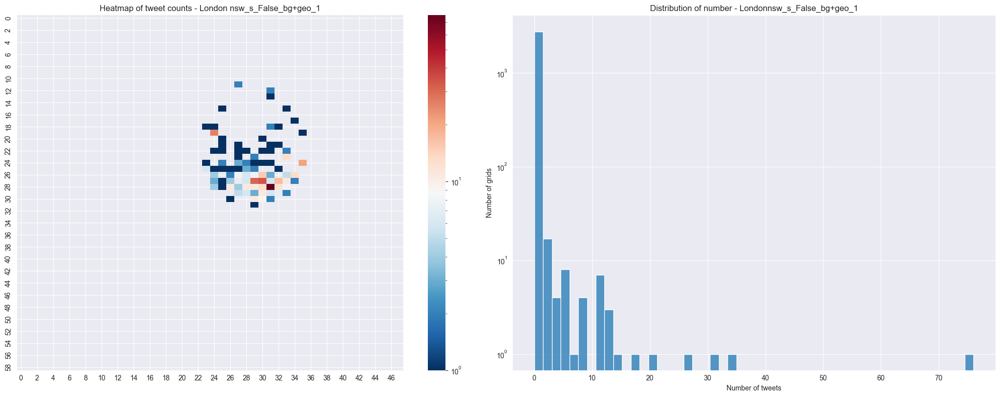

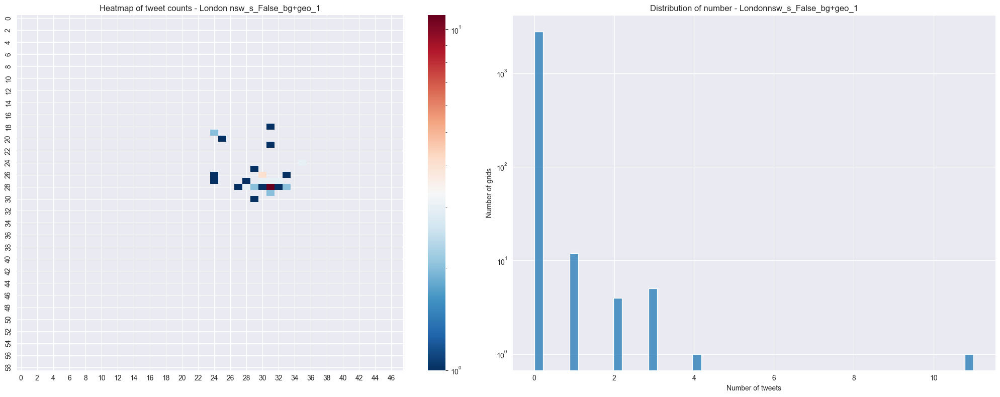

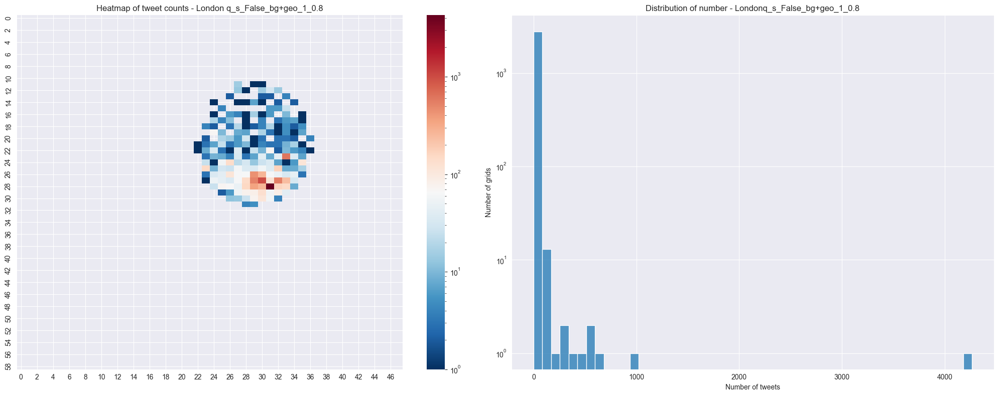

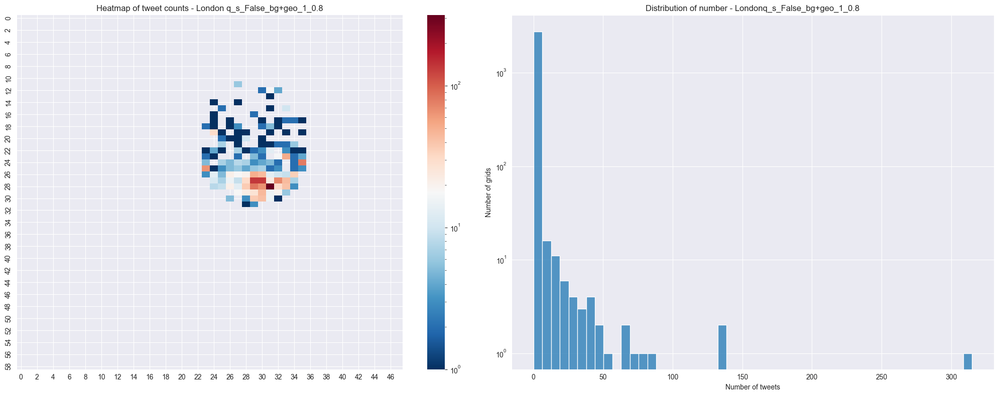

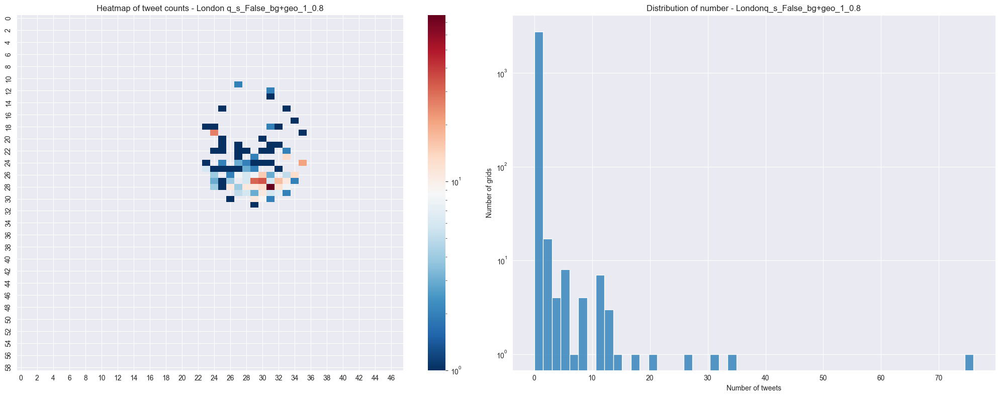

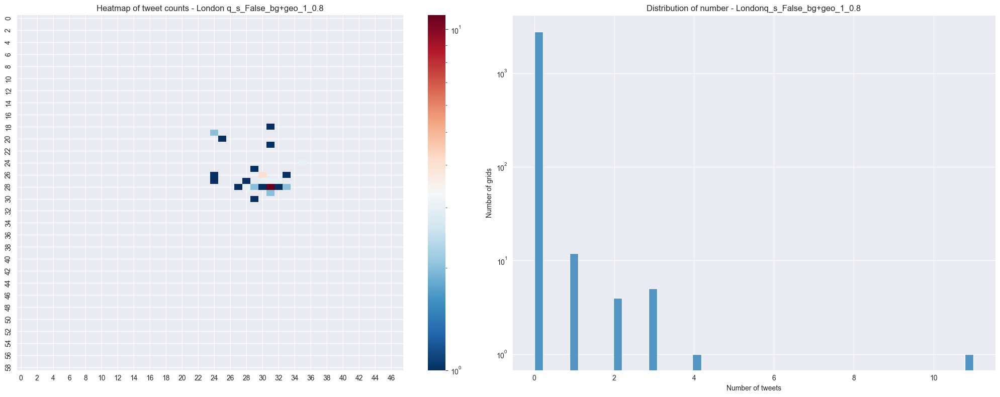

top 10 nsw_s_False_bg+geo_1:

Top 1: 5.8823, text: #me #italian #italiangirl #pink #outfit #outfitoftheday #sunny #sunnyday #selfie #london #londonlife #blonde #blondehair #blondegirl #happiness #dayoff #drmartens #glasses #lipstick @ London, United Kingdom https://t.co/EG69Vyu7Ae

Top 2: 5.7326, text: #PunkDay2022 (@ BrewDog Clerkenwell - @brewdogcwell in London) https://t.co/yP2thJQgDX

Top 3: 5.7313, text: Just posted a photo @ St James Church, Clerkenwell https://t.co/bzLivfByTo

Top 4: 5.5683, text: Such a handsome boy! #blacklab #blacklaba #blacklabsofinstagram @ London, United Kingdom https://t.co/H0ZY8AjA8x

Top 5: 5.5153, text: #candles #candle #candleholder #tray #black #blackcandle #candlesofinstagram #smallshop #smallbusinessuk #smallbusiness #candlelover #candletray #roses #darkaesthetic #dark @ United Kingdom https://t.co/IcF0N7lMqS

Top 6: 5.4739, text: #MartinFreeman
Always super cute!  
What a sweetie seriously 
Somewhere in London in 2009

#TheHobbit #BilboBaggins #Sh

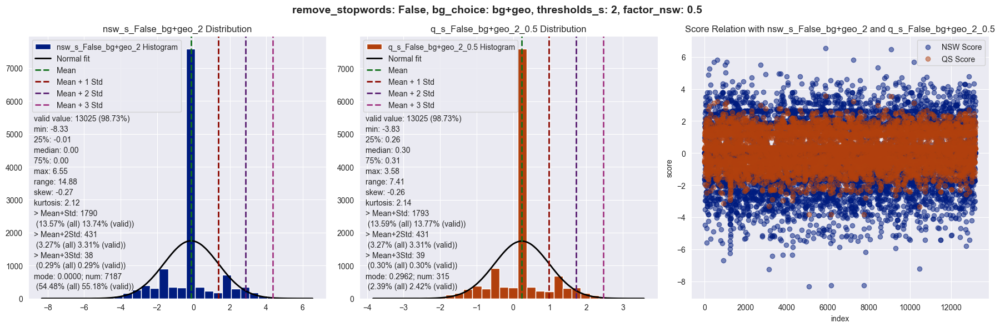

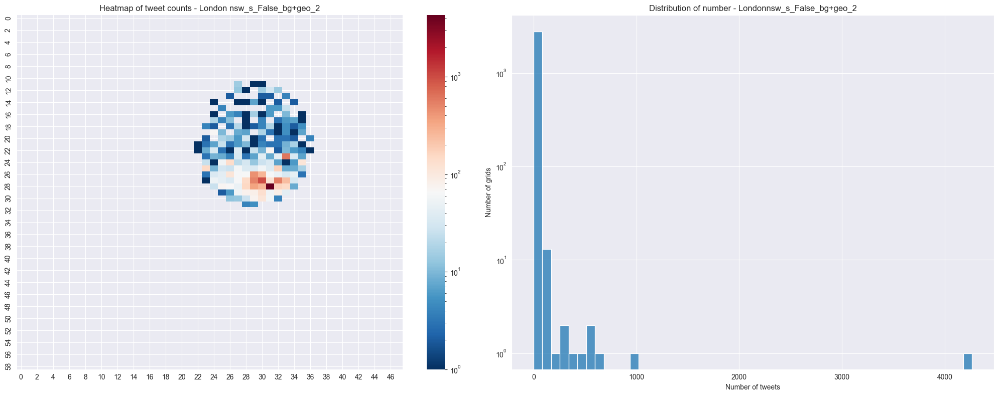

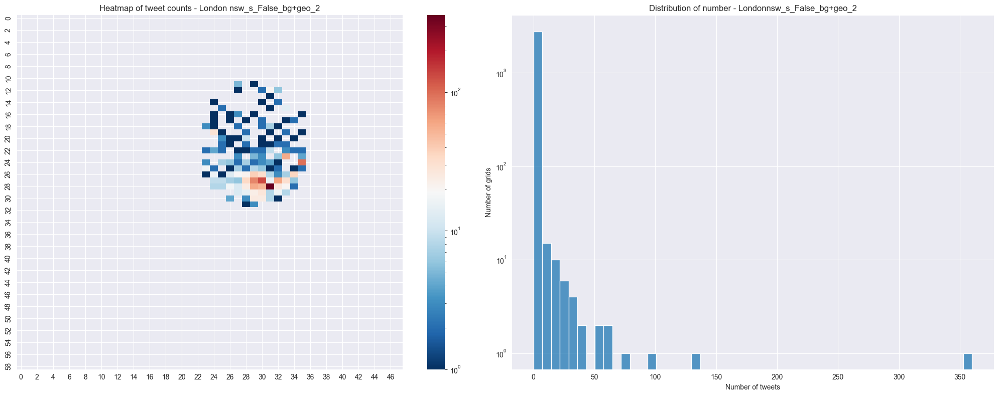

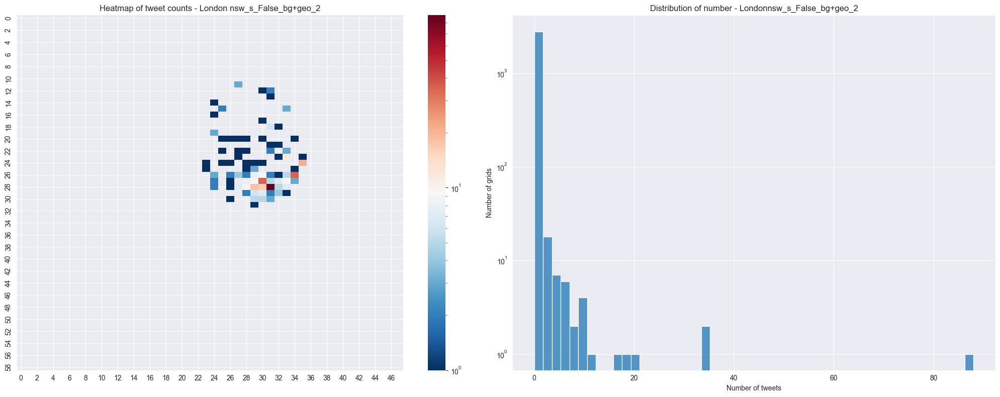

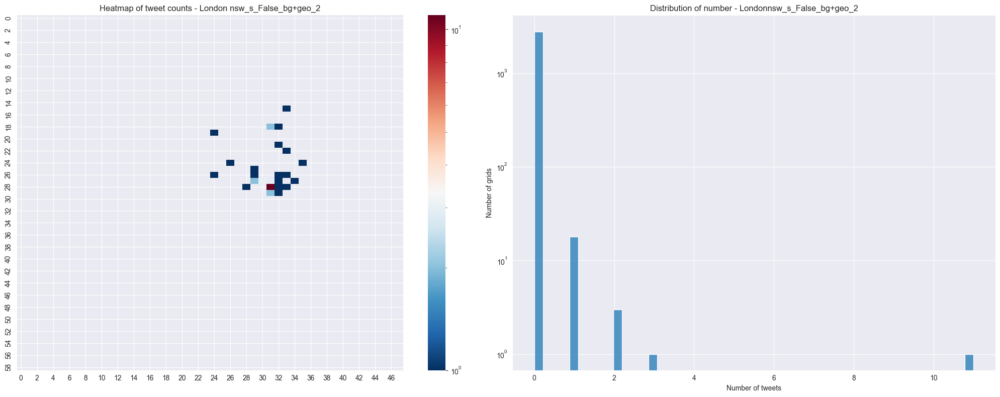

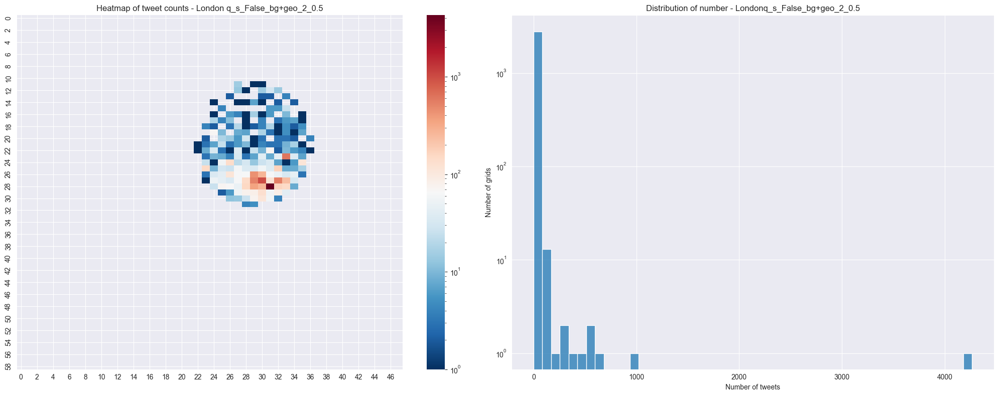

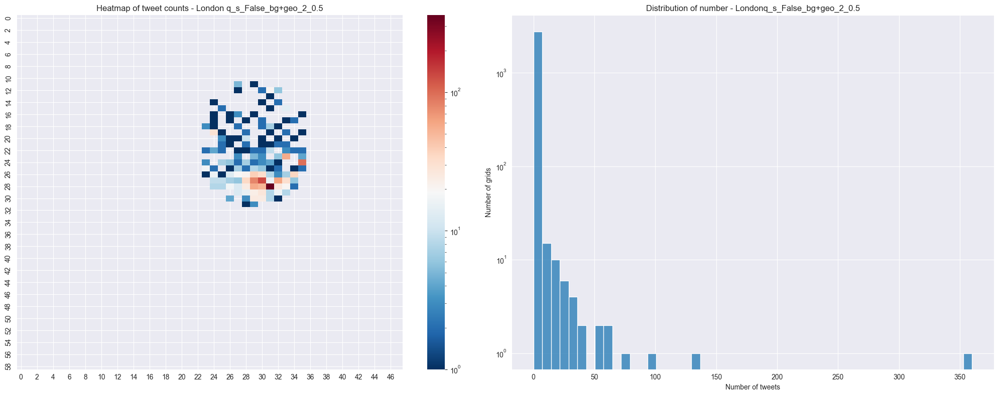

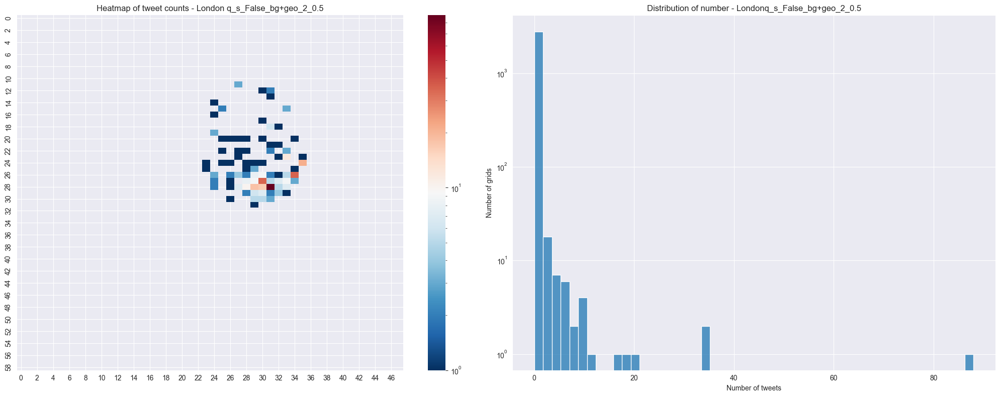

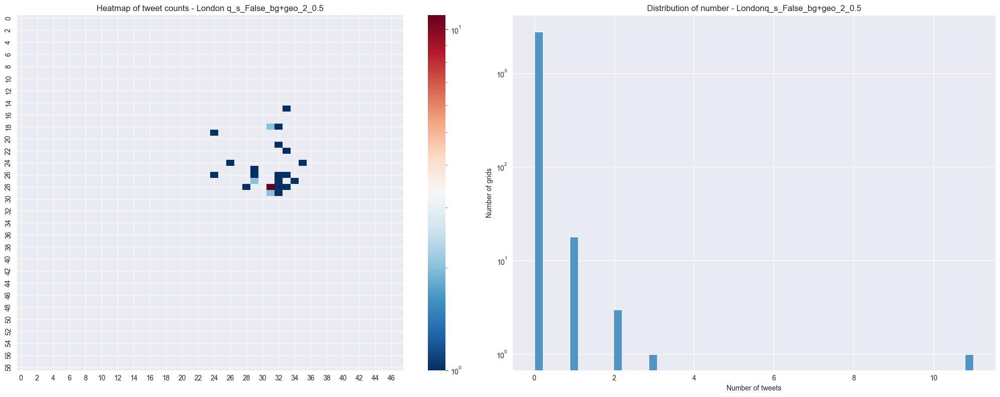

top 10 nsw_s_False_bg+geo_2:

Top 1: 6.5482, text: #MartinFreeman
Always super cute!  
What a sweetie seriously 
Somewhere in London in 2009

#TheHobbit #BilboBaggins #Sherlock #JohnWatson @ London, United Kingdom https://t.co/dZo1oG0Tqs

Top 2: 6.4712, text: The Shard 
#london #uk spring #cloudy #clouds #architecture #steel #glass #skyline #cityscape @ London, United Kingdom https://t.co/MFml7mVoYz

Top 3: 5.8365, text: LIFE IN BLOOM | Forever Mood. Gucci Bloom Profumo Di Fiori, Personified By Florals, Born To Bloom️FR
-
#gucci #bloom #forher @ The Shard London https://t.co/ytDBxVZMPF

Top 4: 5.8141, text: #me #italian #italiangirl #pink #outfit #outfitoftheday #sunny #sunnyday #selfie #london #londonlife #blonde #blondehair #blondegirl #happiness #dayoff #drmartens #glasses #lipstick @ London, United Kingdom https://t.co/EG69Vyu7Ae

Top 5: 5.6970, text: Just posted a photo @ St James Church, Clerkenwell https://t.co/bzLivfByTo

Top 6: 5.6970, text: #PunkDay2022 (@ BrewDog Clerkenwell

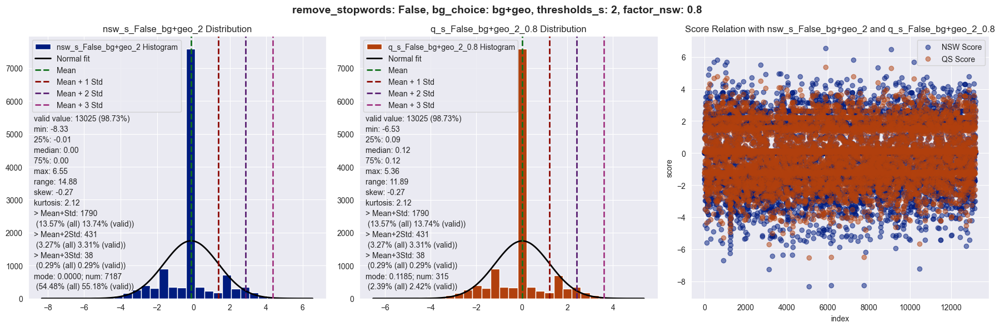

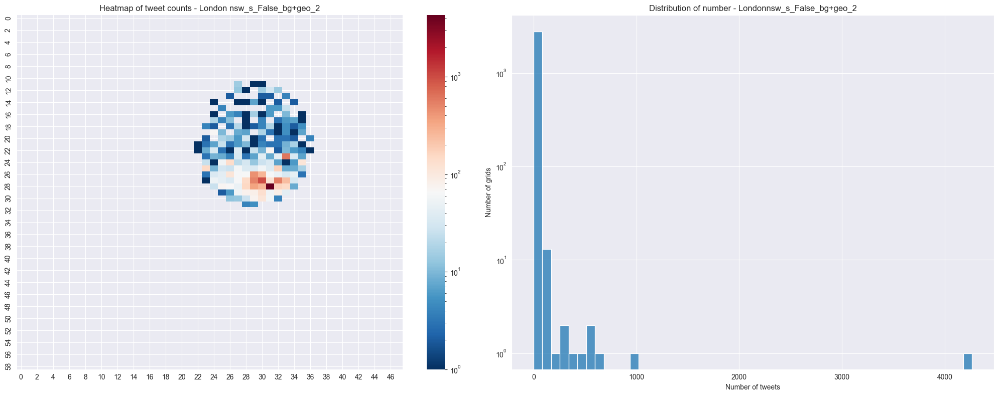

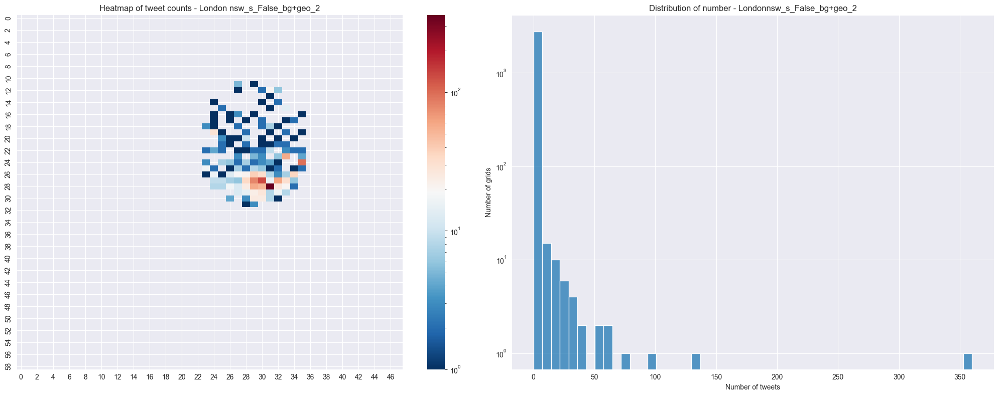

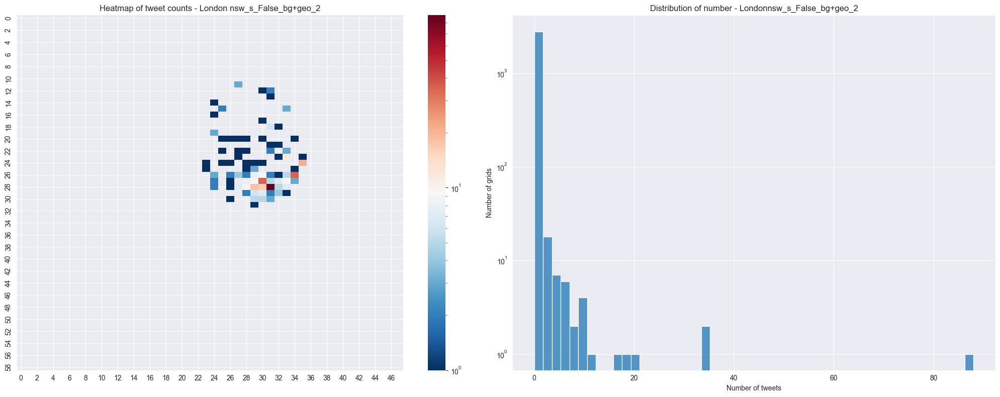

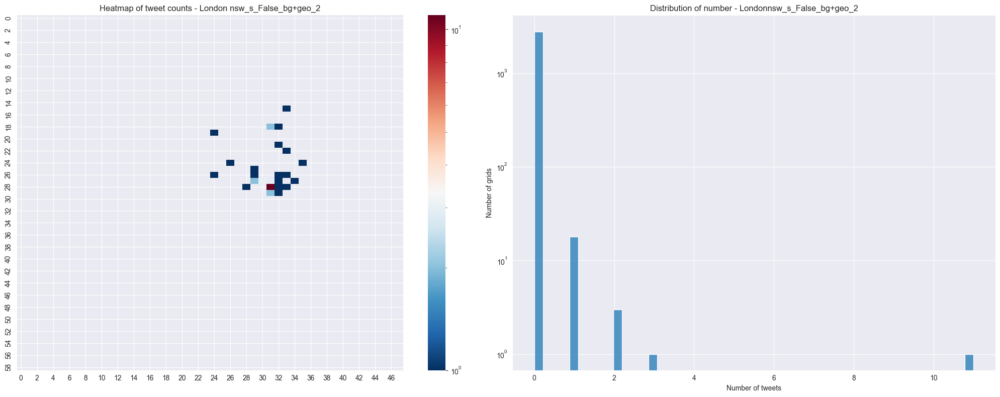

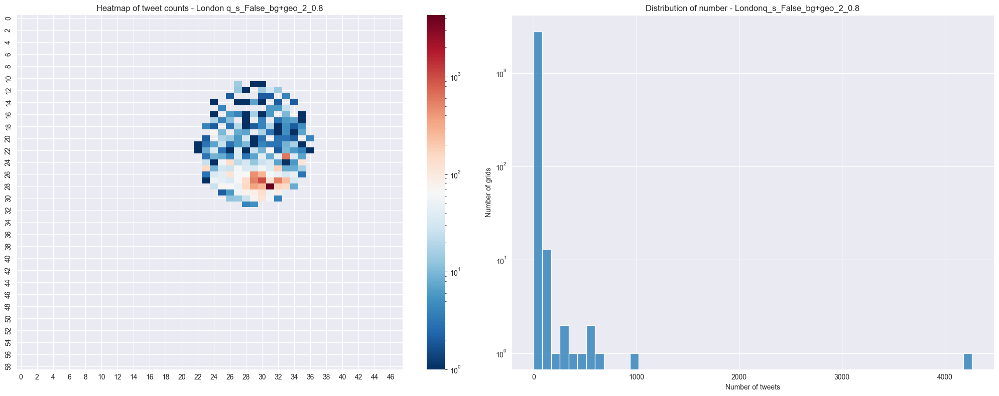

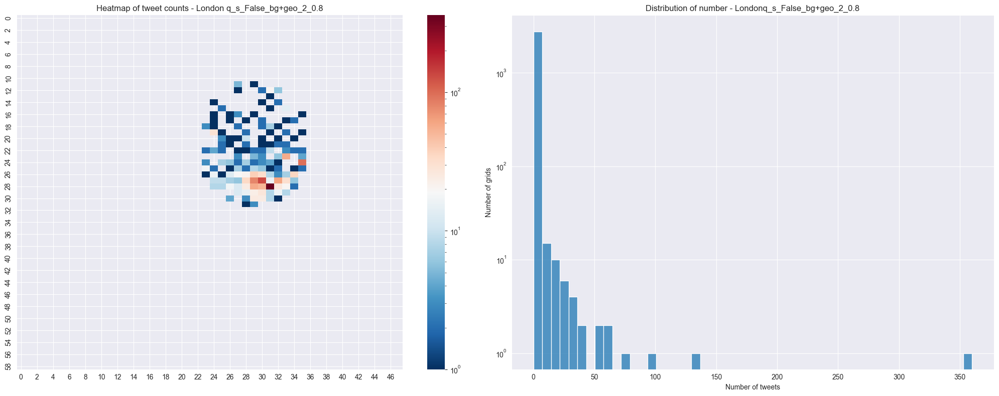

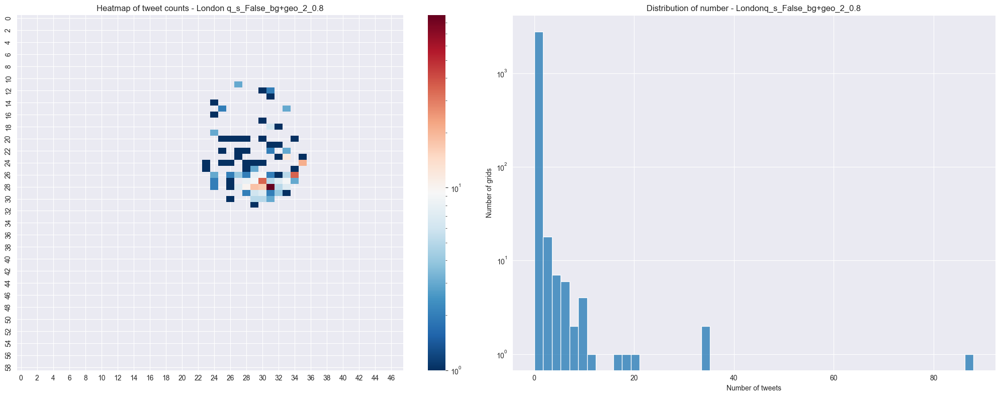

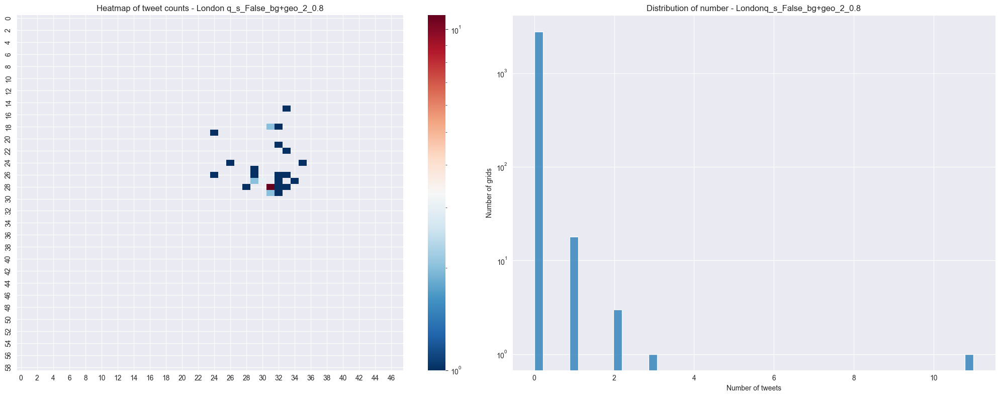

top 10 nsw_s_False_bg+geo_2:

Top 1: 6.5482, text: #MartinFreeman
Always super cute!  
What a sweetie seriously 
Somewhere in London in 2009

#TheHobbit #BilboBaggins #Sherlock #JohnWatson @ London, United Kingdom https://t.co/dZo1oG0Tqs

Top 2: 6.4712, text: The Shard 
#london #uk spring #cloudy #clouds #architecture #steel #glass #skyline #cityscape @ London, United Kingdom https://t.co/MFml7mVoYz

Top 3: 5.8365, text: LIFE IN BLOOM | Forever Mood. Gucci Bloom Profumo Di Fiori, Personified By Florals, Born To Bloom️FR
-
#gucci #bloom #forher @ The Shard London https://t.co/ytDBxVZMPF

Top 4: 5.8141, text: #me #italian #italiangirl #pink #outfit #outfitoftheday #sunny #sunnyday #selfie #london #londonlife #blonde #blondehair #blondegirl #happiness #dayoff #drmartens #glasses #lipstick @ London, United Kingdom https://t.co/EG69Vyu7Ae

Top 5: 5.6970, text: Just posted a photo @ St James Church, Clerkenwell https://t.co/bzLivfByTo

Top 6: 5.6970, text: #PunkDay2022 (@ BrewDog Clerkenwell

,row,column,id,text,token_text_remove_stopwords,token_text_keep_stopwords,score,nsw_s_True_geo_1,q_s_True_geo_1_0.5,q_s_True_geo_1_0.8,...,q_s_False_geo_1_0.8,nsw_s_False_geo_2,q_s_False_geo_2_0.5,q_s_False_geo_2_0.8,nsw_s_False_bg+geo_1,q_s_False_bg+geo_1_0.5,q_s_False_bg+geo_1_0.8,nsw_s_False_bg+geo_2,q_s_False_bg+geo_2_0.5,q_s_False_bg+geo_2_0.8
0,28,31,1565429028747616256,"Just posted a photo @ London, United Kingdom h...","[kingdom, london, photo, posted, united]","[just, kingdom, london, photo, posted, united]",0.554386,0.000000,0.277193,0.110877,...,0.110877,0.000000,0.277193,0.110877,0.000000,0.277193,0.110877,0.000000,0.277193,0.110877
1,28,31,1565428982660603907,"Just posted a photo @ London, United Kingdom h...","[kingdom, london, photo, posted, united]","[just, kingdom, london, photo, posted, united]",0.590283,0.000000,0.295142,0.118057,...,0.118057,0.000000,0.295142,0.118057,0.000000,0.295142,0.118057,0.000000,0.295142,0.118057
2,28,27,1565428290017443846,Just posted a photo @ Eliza Jane Howell https:...,"[eliza, howell, jane, photo, posted]","[eliza, howell, jane, just, photo, posted]",0.591719,-1.551557,-0.479919,-1.122902,...,-1.090516,0.000000,0.295860,0.118344,-1.687800,-0.548040,-1.231896,-1.687800,-0.548040,-1.231896
3,23,33,1565427593851158528,"Just posted a photo @ London, Unιted Kingdom h...","[kingdom, london, photo, posted, ted, un]","[just, kingdom, london, photo, posted, ted, un]",0.592131,0.000000,0.296066,0.118426,...,0.118426,0.000000,0.296066,0.118426,0.000000,0.296066,0.118426,0.000000,0.296066,0.118426
4,28,31,1565425981246115842,A fun day murdering in London Town for the fir...,"[#OrganiseEvents, @themarcusmassey, ages, day,...","[#OrganiseEvents, @themarcusmassey, ages, day,...",0.664139,1.831706,1.247922,1.598193,...,1.354509,1.832904,1.248521,1.599151,1.844621,1.254380,1.608524,1.860609,1.262374,1.621315
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13187,28,29,1575580078368378881,"Just posted a photo @ The Langham, London http...","[langham, london, photo, posted]","[just, langham, london, photo, posted, the]",0.588676,1.667833,1.128254,1.452001,...,0.647485,1.674299,1.131487,1.457174,1.084603,0.836640,0.985418,1.860609,1.224643,1.606222
13188,27,29,1575579146775777280,"I'm at Viet Food in London, Greater London htt...","[food, greater, im, london, viet]","[at, food, greater, im, in, london, viet]",0.569792,2.217693,1.393742,1.888112,...,2.132193,0.000000,0.284896,0.113958,2.947879,1.758835,2.472261,0.000000,0.284896,0.113958
13189,28,31,1575578499121041408,"Just posted a photo @ London, United Kingdom h...","[kingdom, london, photo, posted, united]","[just, kingdom, london, photo, posted, united]",0.592224,0.000000,0.296112,0.118445,...,0.118445,0.000000,0.296112,0.118445,0.000000,0.296112,0.118445,0.000000,0.296112,0.118445
13190,30,31,1575577168826232832,Drinking a Studio Lager by @SignatureBrew at @...,"[@SignatureBrew, @thelexington, drinking, lage...","[@SignatureBrew, @thelexington, at, by, drinki...",0.607921,3.425437,2.016679,2.861934,...,3.010263,2.979662,1.793791,2.505314,3.953069,2.280495,3.284040,3.212689,1.910305,2.691736


C:\Users\Lenovo\AppData\Local\Temp\ipykernel_29564\2913765074.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  axs[1].set_xticklabels(axs[1].get_xticklabels(), rotation=45)
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_29564\2913765074.py:59: UserWarning: Glyph 20998 (\N{CJK UNIFIED IDEOGRAPH-5206}) missing from current font.
  plt.tight_layout()
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_29564\2913765074.py:59: UserWarning: Glyph 25968 (\N{CJK UNIFIED IDEOGRAPH-6570}) missing from current font.
  plt.tight_layout()
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_29564\2913765074.py:59: UserWarning: Glyph 21644 (\N{CJK UNIFIED IDEOGRAPH-548C}) missing from current font.
  plt.tight_layout()
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_29564\2913765074.py:59: UserWarning: Glyph 22320 (\N{CJK UNIFIED IDEOGRAPH-5730}) missing from current font.
  plt.tight_layout()
C:\Users\Lenovo\AppData\Local\Temp\ipyk

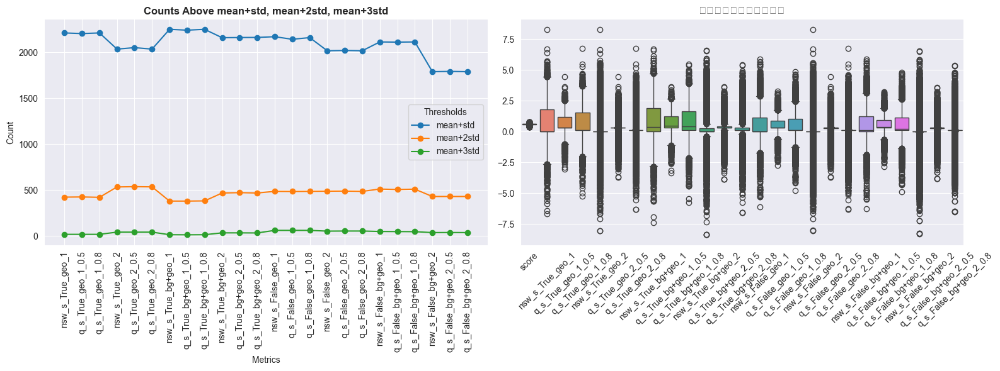

In [41]:
CURRENT_OUTPUT = 'pictureOutput/task3'
statistic3()